<a href="https://colab.research.google.com/github/Aayushf/HndRecog/blob/master/HndDetectFinal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
#Download Dataset
print("Downloading Dataset")
!wget http://www.robots.ox.ac.uk/~vgg/data/hands/downloads/hand_dataset.tar.gz
!tar -xzf hand_dataset.tar.gz

--2019-08-07 18:47:28--  http://www.robots.ox.ac.uk/~vgg/data/hands/downloads/hand_dataset.tar.gz
Resolving www.robots.ox.ac.uk (www.robots.ox.ac.uk)... 129.67.94.2
Connecting to www.robots.ox.ac.uk (www.robots.ox.ac.uk)|129.67.94.2|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 250468306 (239M) [application/x-gzip]
Saving to: ‘hand_dataset.tar.gz’

hand_dataset.tar.gz 100%[===================>] 238.86M  30.3MB/s    in 8.6s    

2019-08-07 18:47:37 (27.7 MB/s) - ‘hand_dataset.tar.gz’ saved [250468306/250468306]



In [0]:
!mkdir train_final
!mkdir train_final/images
!mkdir train_final/annotations

In [0]:
import scipy.io as sio
import os
import cv2
import numpy as np
from IPython.display import clear_output
train_root = "/content/hand_dataset/training_dataset/training_data/"
train_dest = "/content/train_final/"
images_dir = "images/"
annot_dir = "annotations/"
fnames = os.listdir(train_root+images_dir)
c = 1
for fname in fnames:
    try:
        clear_output()
        print(c)
        c+=1
        mat = sio.loadmat(train_root+annot_dir+fname[0:-3]+"mat")
        hands = mat['boxes'][0]
        nhands = len(hands)
        if(nhands == 1):
            img = cv2.imread(train_root+images_dir+fname)
            ans = np.zeros((img.shape[0], img.shape[1]), np.uint8)
            hand = hands[0][0][0]
            pts = [] 
            for i in range(4):
                pt_arr = [int(hand[i][0][1]), int(hand[i][0][0])]
                pts.append(pt_arr)
            cv2.fillConvexPoly(ans, np.asarray(pts), 255)
            cv2.imwrite(train_dest+images_dir+fname[0:-3]+"png", img)
            cv2.imwrite(train_dest+annot_dir+fname[0:-3]+"png", ans)
    except FileNotFoundError:
        pass


4071


In [0]:
import scipy.io as sio
import os
import cv2
import numpy as np
train_root = "/content/hand_dataset/training_dataset/training_data/"
train_dest = "/content/train_final/"
images_dir = "images/"
annot_dir = "annotations/"
fnames = os.listdir(train_dest+images_dir)
def getBatchForUNet(numEx):
    imgs = []
    anss = []
    rints = np.random.randint(len(fnames), size=numEx)
    for i in rints:
        fname = fnames[i]
        img = cv2.imread(train_dest+images_dir+fname)
        img = cv2.resize(img, (256, 256))
        imgs.append(img)
        ans = cv2.imread(train_dest+annot_dir+fname)
        ans = cv2.cvtColor(ans, cv2.COLOR_BGR2GRAY)
        ans = cv2.resize(ans, (256, 256))
        ans = np.reshape(ans, (256, 256, 1))
        anss.append(ans)
    return (np.asarray(imgs).astype(np.float32))/255, (np.asarray(anss).astype(np.float32))/255

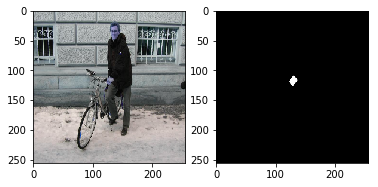

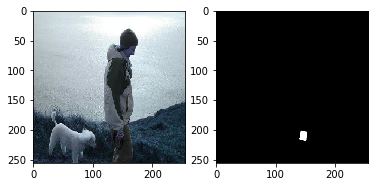

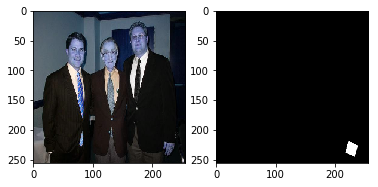

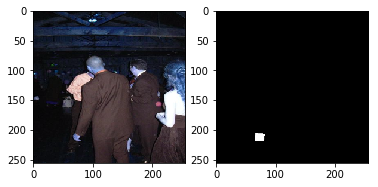

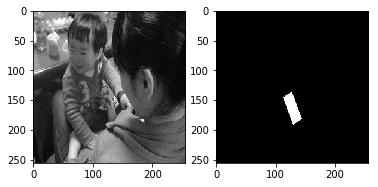

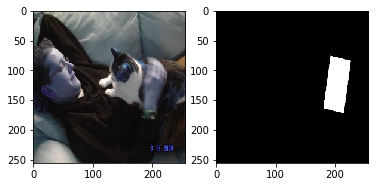

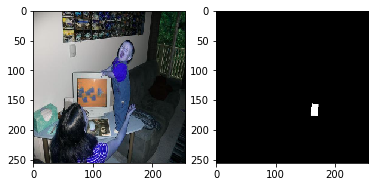

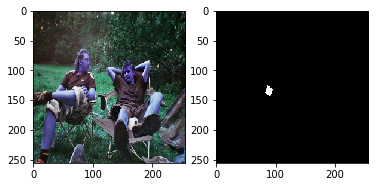

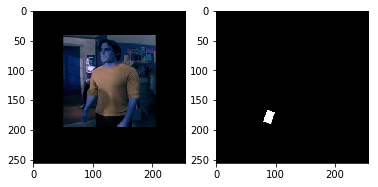

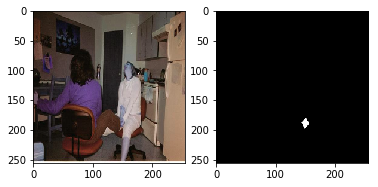

In [0]:
from matplotlib import pyplot as plt
%matplotlib inline
i, a = getBatchForUNet(10)
for p in range(len(i)):
    _, axs = plt.subplots(1, 2)
    axs[0].imshow((i[p].reshape((256, 256, 3))*255).astype(np.uint8))
    axs[1].imshow((a[p].reshape((256, 256))*255).astype(np.uint8), cmap='gray')
    plt.show()



W0804 14:40:45.674032 139853384030080 deprecation.py:506] From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/init_ops.py:1251: calling VarianceScaling.__init__ (from tensorflow.python.ops.init_ops) with dtype is deprecated and will be removed in a future version.
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor


10/10 [==============================] - 5s 510ms/sample - loss: 0.0160
0
(2, 256, 256, 1)


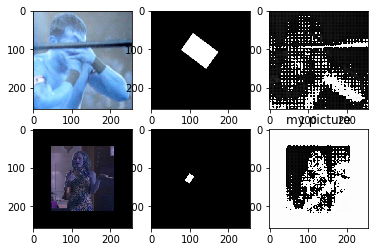

10/10 [==============================] - 0s 18ms/sample - loss: 0.0144
1
10/10 [==============================] - 0s 17ms/sample - loss: 0.0138
2
10/10 [==============================] - 0s 17ms/sample - loss: 0.0136
3
10/10 [==============================] - 0s 17ms/sample - loss: 0.0135
4
10/10 [==============================] - 0s 17ms/sample - loss: 0.0135
5
10/10 [==============================] - 0s 18ms/sample - loss: 0.0134
6
10/10 [==============================] - 0s 17ms/sample - loss: 0.0133
7
10/10 [==============================] - 0s 17ms/sample - loss: 0.0133
8
10/10 [==============================] - 0s 17ms/sample - loss: 0.0132
9
10/10 [==============================] - 0s 17ms/sample - loss: 0.0132
10
(2, 256, 256, 1)


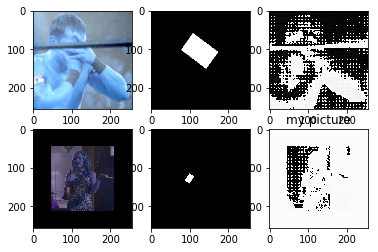

10/10 [==============================] - 0s 17ms/sample - loss: 0.0132
11
10/10 [==============================] - 0s 17ms/sample - loss: 0.0131
12
10/10 [==============================] - 0s 17ms/sample - loss: 0.0131
13
10/10 [==============================] - 0s 17ms/sample - loss: 0.0130
14
10/10 [==============================] - 0s 18ms/sample - loss: 0.0130
15
10/10 [==============================] - 0s 17ms/sample - loss: 0.0130
16
10/10 [==============================] - 0s 17ms/sample - loss: 0.0129
17
10/10 [==============================] - 0s 17ms/sample - loss: 0.0129
18
10/10 [==============================] - 0s 17ms/sample - loss: 0.0129
19
10/10 [==============================] - 0s 17ms/sample - loss: 0.0128
20
(2, 256, 256, 1)


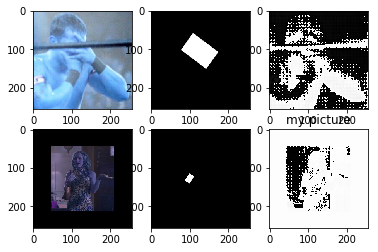

10/10 [==============================] - 0s 17ms/sample - loss: 0.0128
21
10/10 [==============================] - 0s 18ms/sample - loss: 0.0128
22
10/10 [==============================] - 0s 17ms/sample - loss: 0.0128
23
10/10 [==============================] - 0s 17ms/sample - loss: 0.0127
24
10/10 [==============================] - 0s 19ms/sample - loss: 0.0127
25
10/10 [==============================] - 0s 18ms/sample - loss: 0.0127
26
10/10 [==============================] - 0s 17ms/sample - loss: 0.0127
27
10/10 [==============================] - 0s 17ms/sample - loss: 0.0126
28
10/10 [==============================] - 0s 17ms/sample - loss: 0.0126
29
10/10 [==============================] - 0s 17ms/sample - loss: 0.0126
30
(2, 256, 256, 1)


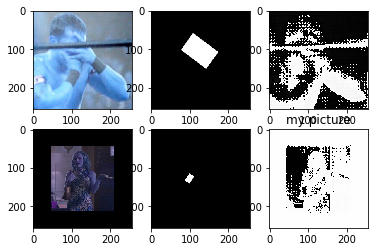

10/10 [==============================] - 0s 17ms/sample - loss: 0.0126
31
10/10 [==============================] - 0s 17ms/sample - loss: 0.0125
32
10/10 [==============================] - 0s 18ms/sample - loss: 0.0125
33
10/10 [==============================] - 0s 17ms/sample - loss: 0.0125
34
10/10 [==============================] - 0s 18ms/sample - loss: 0.0125
35
10/10 [==============================] - 0s 18ms/sample - loss: 0.0125
36
10/10 [==============================] - 0s 18ms/sample - loss: 0.0124
37
10/10 [==============================] - 0s 17ms/sample - loss: 0.0124
38
10/10 [==============================] - 0s 18ms/sample - loss: 0.0124
39
10/10 [==============================] - 0s 18ms/sample - loss: 0.0124
40
(2, 256, 256, 1)


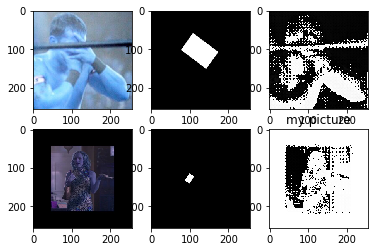

10/10 [==============================] - 0s 17ms/sample - loss: 0.0124
41
10/10 [==============================] - 0s 18ms/sample - loss: 0.0123
42
10/10 [==============================] - 0s 18ms/sample - loss: 0.0123
43
10/10 [==============================] - 0s 17ms/sample - loss: 0.0123
44
10/10 [==============================] - 0s 19ms/sample - loss: 0.0123
45
10/10 [==============================] - 0s 18ms/sample - loss: 0.0123
46
10/10 [==============================] - 0s 18ms/sample - loss: 0.0123
47
10/10 [==============================] - 0s 18ms/sample - loss: 0.0122
48
10/10 [==============================] - 0s 18ms/sample - loss: 0.0122
49
10/10 [==============================] - 0s 17ms/sample - loss: 0.0122
50
(2, 256, 256, 1)


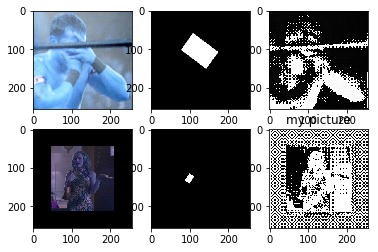

10/10 [==============================] - 0s 17ms/sample - loss: 0.0122
51
10/10 [==============================] - 0s 18ms/sample - loss: 0.0122
52
10/10 [==============================] - 0s 18ms/sample - loss: 0.0122
53
10/10 [==============================] - 0s 17ms/sample - loss: 0.0121
54
10/10 [==============================] - 0s 19ms/sample - loss: 0.0121
55
10/10 [==============================] - 0s 18ms/sample - loss: 0.0121
56
10/10 [==============================] - 0s 17ms/sample - loss: 0.0121
57
10/10 [==============================] - 0s 18ms/sample - loss: 0.0121
58
10/10 [==============================] - 0s 18ms/sample - loss: 0.0121
59
10/10 [==============================] - 0s 18ms/sample - loss: 0.0120
60
(2, 256, 256, 1)


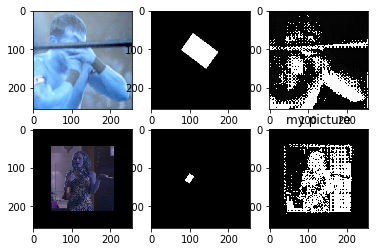

10/10 [==============================] - 0s 17ms/sample - loss: 0.0120
61
10/10 [==============================] - 0s 17ms/sample - loss: 0.0120
62
10/10 [==============================] - 0s 18ms/sample - loss: 0.0120
63
10/10 [==============================] - 0s 18ms/sample - loss: 0.0120
64
10/10 [==============================] - 0s 19ms/sample - loss: 0.0120
65
10/10 [==============================] - 0s 19ms/sample - loss: 0.0120
66
10/10 [==============================] - 0s 18ms/sample - loss: 0.0119
67
10/10 [==============================] - 0s 17ms/sample - loss: 0.0119
68
10/10 [==============================] - 0s 18ms/sample - loss: 0.0119
69
10/10 [==============================] - 0s 18ms/sample - loss: 0.0119
70
(2, 256, 256, 1)


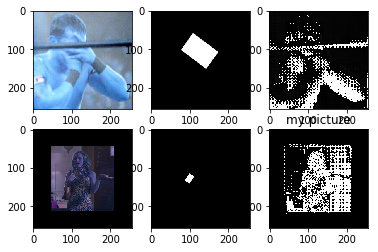

10/10 [==============================] - 0s 17ms/sample - loss: 0.0119
71
10/10 [==============================] - 0s 18ms/sample - loss: 0.0119
72
10/10 [==============================] - 0s 18ms/sample - loss: 0.0119
73
10/10 [==============================] - 0s 18ms/sample - loss: 0.0119
74
10/10 [==============================] - 0s 19ms/sample - loss: 0.0118
75
10/10 [==============================] - 0s 18ms/sample - loss: 0.0118
76
10/10 [==============================] - 0s 18ms/sample - loss: 0.0118
77
10/10 [==============================] - 0s 18ms/sample - loss: 0.0118
78
10/10 [==============================] - 0s 18ms/sample - loss: 0.0118
79
10/10 [==============================] - 0s 18ms/sample - loss: 0.0118
80
(2, 256, 256, 1)


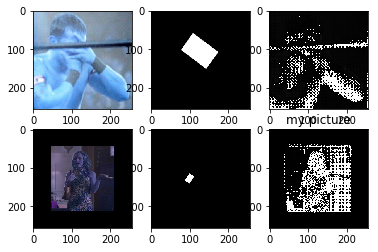

10/10 [==============================] - 0s 17ms/sample - loss: 0.0118
81
10/10 [==============================] - 0s 18ms/sample - loss: 0.0118
82
10/10 [==============================] - 0s 18ms/sample - loss: 0.0118
83
10/10 [==============================] - 0s 18ms/sample - loss: 0.0117
84
10/10 [==============================] - 0s 18ms/sample - loss: 0.0117
85
10/10 [==============================] - 0s 19ms/sample - loss: 0.0117
86
10/10 [==============================] - 0s 18ms/sample - loss: 0.0117
87
10/10 [==============================] - 0s 18ms/sample - loss: 0.0117
88
10/10 [==============================] - 0s 18ms/sample - loss: 0.0117
89
10/10 [==============================] - 0s 18ms/sample - loss: 0.0117
90
(2, 256, 256, 1)


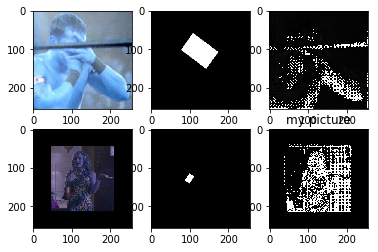

10/10 [==============================] - 0s 17ms/sample - loss: 0.0117
91
10/10 [==============================] - 0s 18ms/sample - loss: 0.0117
92
10/10 [==============================] - 0s 18ms/sample - loss: 0.0116
93
10/10 [==============================] - 0s 18ms/sample - loss: 0.0116
94
10/10 [==============================] - 0s 20ms/sample - loss: 0.0116
95
10/10 [==============================] - 0s 19ms/sample - loss: 0.0116
96
10/10 [==============================] - 0s 18ms/sample - loss: 0.0116
97
10/10 [==============================] - 0s 18ms/sample - loss: 0.0116
98
10/10 [==============================] - 0s 18ms/sample - loss: 0.0116
99
10/10 [==============================] - 0s 18ms/sample - loss: 0.0116
100
(2, 256, 256, 1)


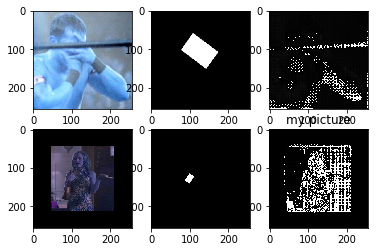

10/10 [==============================] - 0s 18ms/sample - loss: 0.0116
101
10/10 [==============================] - 0s 18ms/sample - loss: 0.0116
102
10/10 [==============================] - 0s 18ms/sample - loss: 0.0116
103
10/10 [==============================] - 0s 18ms/sample - loss: 0.0115
104
10/10 [==============================] - 0s 20ms/sample - loss: 0.0115
105
10/10 [==============================] - 0s 18ms/sample - loss: 0.0115
106
10/10 [==============================] - 0s 18ms/sample - loss: 0.0115
107
10/10 [==============================] - 0s 18ms/sample - loss: 0.0115
108
10/10 [==============================] - 0s 18ms/sample - loss: 0.0115
109
10/10 [==============================] - 0s 18ms/sample - loss: 0.0115
110
(2, 256, 256, 1)


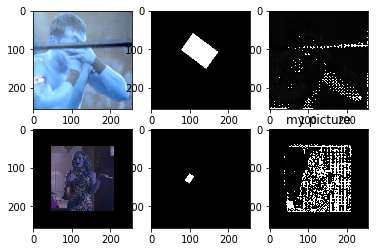

10/10 [==============================] - 0s 17ms/sample - loss: 0.0115
111
10/10 [==============================] - 0s 18ms/sample - loss: 0.0115
112
10/10 [==============================] - 0s 18ms/sample - loss: 0.0115
113
10/10 [==============================] - 0s 18ms/sample - loss: 0.0115
114
10/10 [==============================] - 0s 19ms/sample - loss: 0.0115
115
10/10 [==============================] - 0s 18ms/sample - loss: 0.0114
116
10/10 [==============================] - 0s 18ms/sample - loss: 0.0114
117
10/10 [==============================] - 0s 18ms/sample - loss: 0.0114
118
10/10 [==============================] - 0s 18ms/sample - loss: 0.0114
119
10/10 [==============================] - 0s 18ms/sample - loss: 0.0114
120
(2, 256, 256, 1)


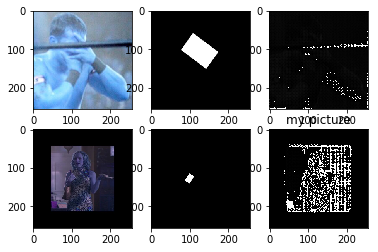

10/10 [==============================] - 0s 18ms/sample - loss: 0.0114
121
10/10 [==============================] - 0s 18ms/sample - loss: 0.0114
122
10/10 [==============================] - 0s 18ms/sample - loss: 0.0114
123
10/10 [==============================] - 0s 18ms/sample - loss: 0.0114
124
10/10 [==============================] - 0s 21ms/sample - loss: 0.0114
125
10/10 [==============================] - 0s 18ms/sample - loss: 0.0114
126
10/10 [==============================] - 0s 18ms/sample - loss: 0.0114
127
10/10 [==============================] - 0s 18ms/sample - loss: 0.0114
128
10/10 [==============================] - 0s 18ms/sample - loss: 0.0114
129
10/10 [==============================] - 0s 19ms/sample - loss: 0.0113
130
(2, 256, 256, 1)


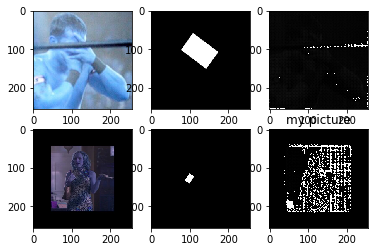

10/10 [==============================] - 0s 18ms/sample - loss: 0.0113
131
10/10 [==============================] - 0s 18ms/sample - loss: 0.0113
132
10/10 [==============================] - 0s 18ms/sample - loss: 0.0113
133
10/10 [==============================] - 0s 18ms/sample - loss: 0.0113
134
10/10 [==============================] - 0s 22ms/sample - loss: 0.0113
135
10/10 [==============================] - 0s 18ms/sample - loss: 0.0113
136
10/10 [==============================] - 0s 18ms/sample - loss: 0.0113
137
10/10 [==============================] - 0s 18ms/sample - loss: 0.0113
138
10/10 [==============================] - 0s 18ms/sample - loss: 0.0113
139
10/10 [==============================] - 0s 19ms/sample - loss: 0.0113
140
(2, 256, 256, 1)


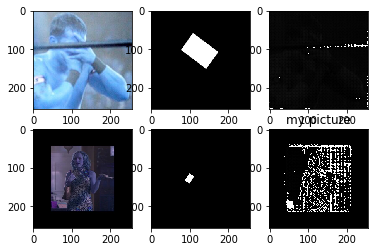

10/10 [==============================] - 0s 18ms/sample - loss: 0.0113
141
10/10 [==============================] - 0s 18ms/sample - loss: 0.0113
142
10/10 [==============================] - 0s 18ms/sample - loss: 0.0113
143
10/10 [==============================] - 0s 18ms/sample - loss: 0.0113
144
10/10 [==============================] - 0s 21ms/sample - loss: 0.0113
145
10/10 [==============================] - 0s 18ms/sample - loss: 0.0113
146
10/10 [==============================] - 0s 18ms/sample - loss: 0.0113
147
10/10 [==============================] - 0s 18ms/sample - loss: 0.0112
148
10/10 [==============================] - 0s 18ms/sample - loss: 0.0112
149
10/10 [==============================] - 0s 19ms/sample - loss: 0.0112
150
(2, 256, 256, 1)


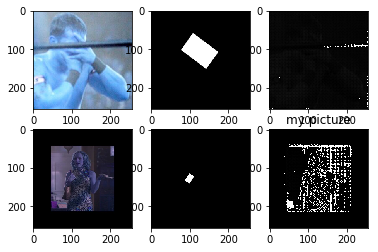

10/10 [==============================] - 0s 19ms/sample - loss: 0.0112
151
10/10 [==============================] - 0s 18ms/sample - loss: 0.0112
152
10/10 [==============================] - 0s 18ms/sample - loss: 0.0112
153
10/10 [==============================] - 0s 18ms/sample - loss: 0.0112
154
10/10 [==============================] - 0s 21ms/sample - loss: 0.0112
155
10/10 [==============================] - 0s 18ms/sample - loss: 0.0112
156
10/10 [==============================] - 0s 18ms/sample - loss: 0.0112
157
10/10 [==============================] - 0s 18ms/sample - loss: 0.0112
158
10/10 [==============================] - 0s 18ms/sample - loss: 0.0112
159
10/10 [==============================] - 0s 19ms/sample - loss: 0.0112
160
(2, 256, 256, 1)


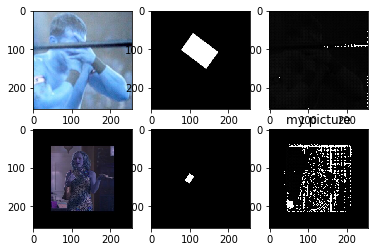

10/10 [==============================] - 0s 18ms/sample - loss: 0.0112
161
10/10 [==============================] - 0s 18ms/sample - loss: 0.0112
162
10/10 [==============================] - 0s 18ms/sample - loss: 0.0112
163
10/10 [==============================] - 0s 18ms/sample - loss: 0.0112
164
10/10 [==============================] - 0s 22ms/sample - loss: 0.0112
165
10/10 [==============================] - 0s 19ms/sample - loss: 0.0112
166
10/10 [==============================] - 0s 18ms/sample - loss: 0.0112
167
10/10 [==============================] - 0s 18ms/sample - loss: 0.0112
168
10/10 [==============================] - 0s 18ms/sample - loss: 0.0112
169
10/10 [==============================] - 0s 20ms/sample - loss: 0.0111
170
(2, 256, 256, 1)


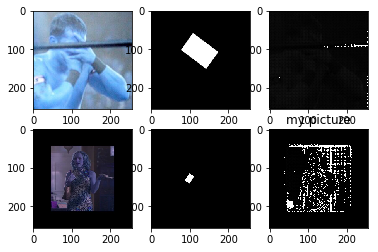

10/10 [==============================] - 0s 18ms/sample - loss: 0.0111
171
10/10 [==============================] - 0s 18ms/sample - loss: 0.0111
172
10/10 [==============================] - 0s 18ms/sample - loss: 0.0111
173
10/10 [==============================] - 0s 18ms/sample - loss: 0.0111
174
10/10 [==============================] - 0s 21ms/sample - loss: 0.0111
175
10/10 [==============================] - 0s 18ms/sample - loss: 0.0111
176
10/10 [==============================] - 0s 18ms/sample - loss: 0.0111
177
10/10 [==============================] - 0s 18ms/sample - loss: 0.0111
178
10/10 [==============================] - 0s 18ms/sample - loss: 0.0111
179
10/10 [==============================] - 0s 20ms/sample - loss: 0.0111
180
(2, 256, 256, 1)


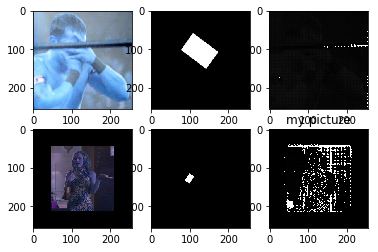

10/10 [==============================] - 0s 18ms/sample - loss: 0.0111
181
10/10 [==============================] - 0s 19ms/sample - loss: 0.0111
182
10/10 [==============================] - 0s 19ms/sample - loss: 0.0111
183
10/10 [==============================] - 0s 18ms/sample - loss: 0.0111
184
10/10 [==============================] - 0s 22ms/sample - loss: 0.0111
185
10/10 [==============================] - 0s 19ms/sample - loss: 0.0111
186
10/10 [==============================] - 0s 18ms/sample - loss: 0.0111
187
10/10 [==============================] - 0s 18ms/sample - loss: 0.0111
188
10/10 [==============================] - 0s 19ms/sample - loss: 0.0111
189
10/10 [==============================] - 0s 21ms/sample - loss: 0.0111
190
(2, 256, 256, 1)


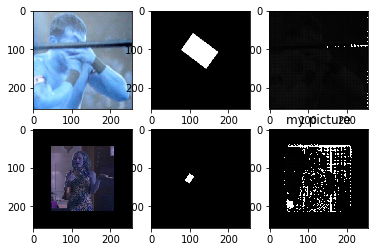

10/10 [==============================] - 0s 18ms/sample - loss: 0.0111
191
10/10 [==============================] - 0s 19ms/sample - loss: 0.0111
192
10/10 [==============================] - 0s 18ms/sample - loss: 0.0111
193
10/10 [==============================] - 0s 19ms/sample - loss: 0.0111
194
10/10 [==============================] - 0s 23ms/sample - loss: 0.0111
195
10/10 [==============================] - 0s 18ms/sample - loss: 0.0111
196
10/10 [==============================] - 0s 18ms/sample - loss: 0.0111
197
10/10 [==============================] - 0s 19ms/sample - loss: 0.0111
198
10/10 [==============================] - 0s 18ms/sample - loss: 0.0111
199
10/10 [==============================] - 0s 21ms/sample - loss: 0.0110
200
(2, 256, 256, 1)


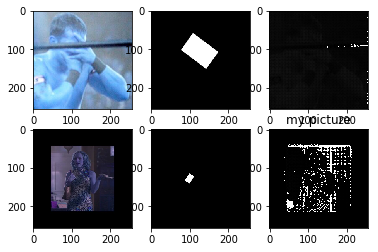

10/10 [==============================] - 0s 18ms/sample - loss: 0.0110
201
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
202
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
203
10/10 [==============================] - 0s 18ms/sample - loss: 0.0110
204
10/10 [==============================] - 0s 22ms/sample - loss: 0.0110
205
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
206
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
207
10/10 [==============================] - 0s 18ms/sample - loss: 0.0110
208
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
209
10/10 [==============================] - 0s 21ms/sample - loss: 0.0110
210
(2, 256, 256, 1)


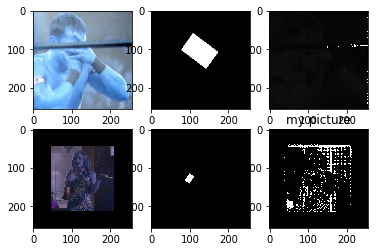

10/10 [==============================] - 0s 18ms/sample - loss: 0.0110
211
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
212
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
213
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
214
10/10 [==============================] - 0s 21ms/sample - loss: 0.0110
215
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
216
10/10 [==============================] - 0s 18ms/sample - loss: 0.0110
217
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
218
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
219
10/10 [==============================] - 0s 21ms/sample - loss: 0.0110
220
(2, 256, 256, 1)


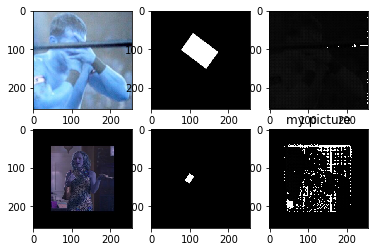

10/10 [==============================] - 0s 18ms/sample - loss: 0.0110
221
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
222
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
223
10/10 [==============================] - 0s 18ms/sample - loss: 0.0110
224
10/10 [==============================] - 0s 22ms/sample - loss: 0.0110
225
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
226
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
227
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
228
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
229
10/10 [==============================] - 0s 20ms/sample - loss: 0.0110
230
(2, 256, 256, 1)


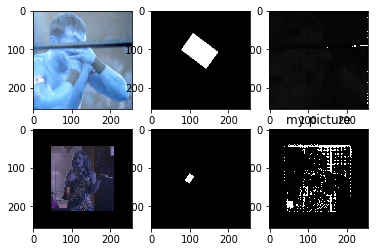

10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
231
10/10 [==============================] - 0s 18ms/sample - loss: 0.0110
232
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
233
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
234
10/10 [==============================] - 0s 23ms/sample - loss: 0.0110
235
10/10 [==============================] - 0s 18ms/sample - loss: 0.0110
236
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
237
10/10 [==============================] - 0s 18ms/sample - loss: 0.0110
238
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
239
10/10 [==============================] - 0s 21ms/sample - loss: 0.0110
240
(2, 256, 256, 1)


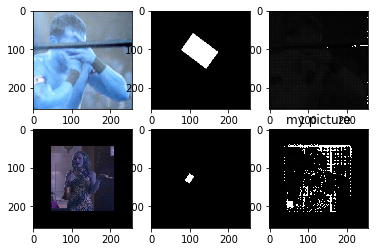

10/10 [==============================] - 0s 18ms/sample - loss: 0.0110
241
10/10 [==============================] - 0s 18ms/sample - loss: 0.0110
242
10/10 [==============================] - 0s 18ms/sample - loss: 0.0110
243
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
244
10/10 [==============================] - 0s 20ms/sample - loss: 0.0110
245
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
246
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
247
10/10 [==============================] - 0s 19ms/sample - loss: 0.0110
248
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
249
10/10 [==============================] - 0s 20ms/sample - loss: 0.0109
250
(2, 256, 256, 1)


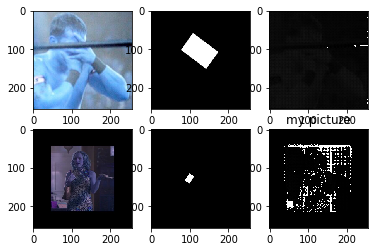

10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
251
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
252
10/10 [==============================] - 0s 19ms/sample - loss: 0.0109
253
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
254
10/10 [==============================] - 0s 20ms/sample - loss: 0.0109
255
10/10 [==============================] - 0s 19ms/sample - loss: 0.0109
256
10/10 [==============================] - 0s 19ms/sample - loss: 0.0109
257
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
258
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
259
10/10 [==============================] - 0s 20ms/sample - loss: 0.0109
260
(2, 256, 256, 1)


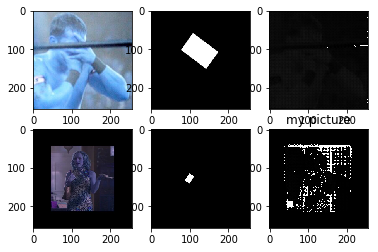

10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
261
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
262
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
263
10/10 [==============================] - 0s 19ms/sample - loss: 0.0109
264
10/10 [==============================] - 0s 22ms/sample - loss: 0.0109
265
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
266
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
267
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
268
10/10 [==============================] - 0s 19ms/sample - loss: 0.0109
269
10/10 [==============================] - 0s 20ms/sample - loss: 0.0109
270
(2, 256, 256, 1)


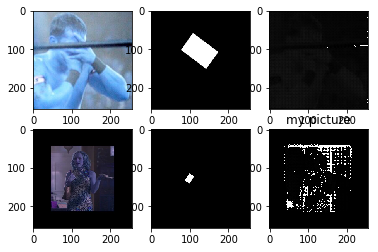

10/10 [==============================] - 0s 19ms/sample - loss: 0.0109
271
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
272
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
273
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
274
10/10 [==============================] - 0s 22ms/sample - loss: 0.0109
275
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
276
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
277
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
278
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
279
10/10 [==============================] - 0s 20ms/sample - loss: 0.0109
280
(2, 256, 256, 1)


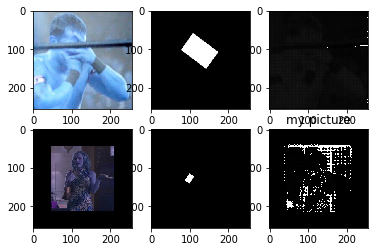

10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
281
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
282
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
283
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
284
10/10 [==============================] - 0s 20ms/sample - loss: 0.0109
285
10/10 [==============================] - 0s 19ms/sample - loss: 0.0109
286
10/10 [==============================] - 0s 19ms/sample - loss: 0.0109
287
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
288
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
289
10/10 [==============================] - 0s 19ms/sample - loss: 0.0109
290
(2, 256, 256, 1)


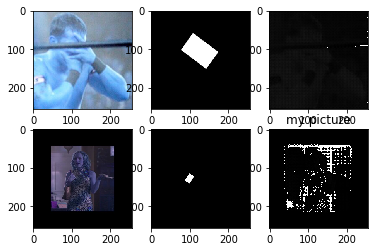

10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
291
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
292
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
293
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
294
10/10 [==============================] - 0s 19ms/sample - loss: 0.0109
295
10/10 [==============================] - 0s 19ms/sample - loss: 0.0109
296
10/10 [==============================] - 0s 19ms/sample - loss: 0.0109
297
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
298
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
299
10/10 [==============================] - 0s 19ms/sample - loss: 0.0109
300
(2, 256, 256, 1)


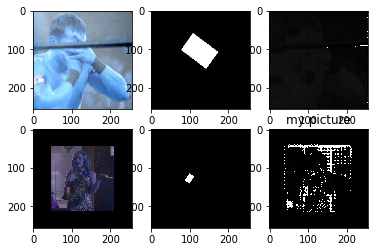

10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
301
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
302
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
303
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
304
10/10 [==============================] - 0s 21ms/sample - loss: 0.0109
305
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
306
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
307
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
308
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
309
10/10 [==============================] - 0s 19ms/sample - loss: 0.0109
310
(2, 256, 256, 1)


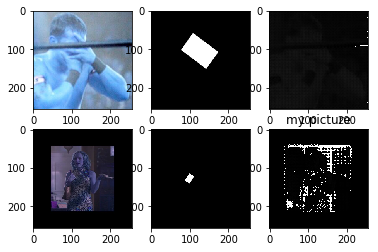

10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
311
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
312
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
313
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
314
10/10 [==============================] - 0s 22ms/sample - loss: 0.0109
315
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
316
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
317
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
318
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
319
10/10 [==============================] - 0s 20ms/sample - loss: 0.0109
320
(2, 256, 256, 1)


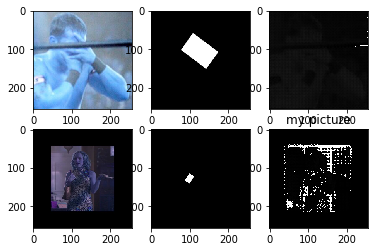

10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
321
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
322
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
323
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
324
10/10 [==============================] - 0s 21ms/sample - loss: 0.0109
325
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
326
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
327
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
328
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
329
10/10 [==============================] - 0s 19ms/sample - loss: 0.0109
330
(2, 256, 256, 1)


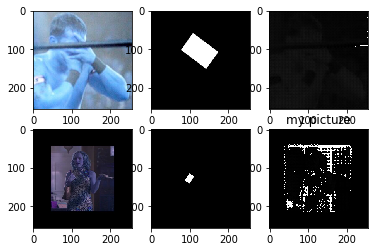

10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
331
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
332
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
333
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
334
10/10 [==============================] - 0s 22ms/sample - loss: 0.0109
335
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
336
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
337
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
338
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
339
10/10 [==============================] - 0s 19ms/sample - loss: 0.0109
340
(2, 256, 256, 1)


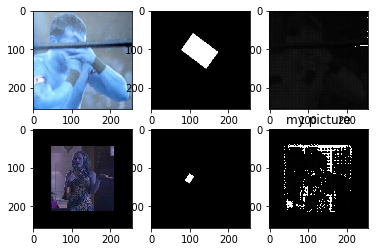

10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
341
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
342
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
343
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
344
10/10 [==============================] - 0s 21ms/sample - loss: 0.0109
345
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
346
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
347
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
348
10/10 [==============================] - 0s 18ms/sample - loss: 0.0109
349
10/10 [==============================] - 0s 19ms/sample - loss: 0.0109
350
(2, 256, 256, 1)


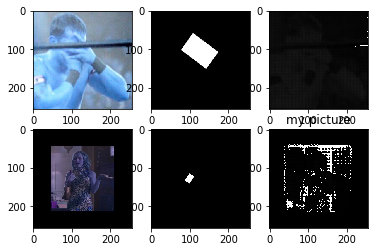

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
351
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
352
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
353
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
354
10/10 [==============================] - 0s 21ms/sample - loss: 0.0108
355
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
356
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
357
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
358
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
359
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
360
(2, 256, 256, 1)


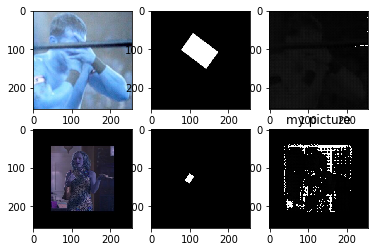

10/10 [==============================] - 0s 17ms/sample - loss: 0.0108
361
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
362
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
363
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
364
10/10 [==============================] - 0s 21ms/sample - loss: 0.0108
365
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
366
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
367
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
368
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
369
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
370
(2, 256, 256, 1)


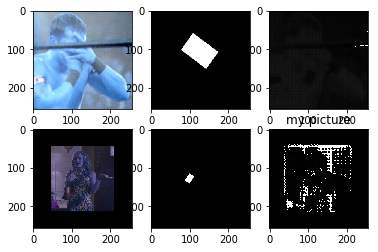

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
371
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
372
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
373
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
374
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
375
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
376
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
377
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
378
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
379
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
380
(2, 256, 256, 1)


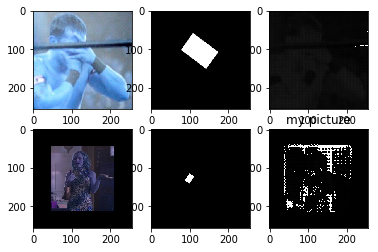

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
381
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
382
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
383
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
384
10/10 [==============================] - 0s 21ms/sample - loss: 0.0108
385
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
386
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
387
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
388
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
389
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
390
(2, 256, 256, 1)


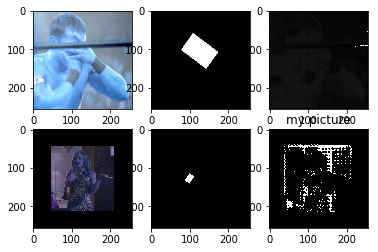

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
391
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
392
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
393
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
394
10/10 [==============================] - 0s 21ms/sample - loss: 0.0108
395
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
396
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
397
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
398
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
399
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
400
(2, 256, 256, 1)


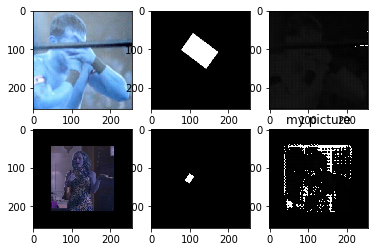

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
401
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
402
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
403
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
404
10/10 [==============================] - 0s 20ms/sample - loss: 0.0108
405
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
406
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
407
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
408
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
409
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
410
(2, 256, 256, 1)


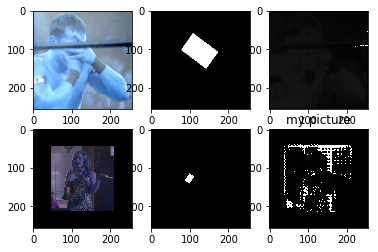

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
411
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
412
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
413
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
414
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
415
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
416
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
417
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
418
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
419
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
420
(2, 256, 256, 1)


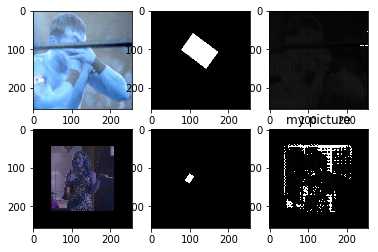

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
421
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
422
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
423
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
424
10/10 [==============================] - 0s 21ms/sample - loss: 0.0108
425
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
426
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
427
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
428
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
429
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
430
(2, 256, 256, 1)


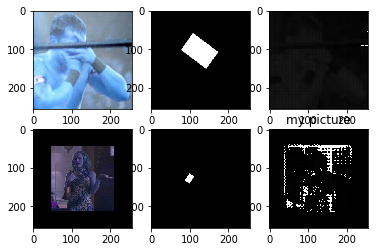

10/10 [==============================] - 0s 17ms/sample - loss: 0.0108
431
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
432
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
433
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
434
10/10 [==============================] - 0s 21ms/sample - loss: 0.0108
435
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
436
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
437
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
438
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
439
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
440
(2, 256, 256, 1)


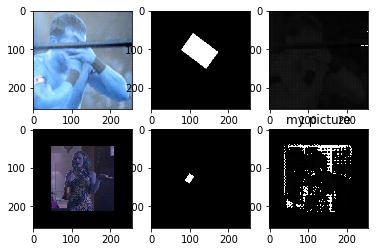

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
441
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
442
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
443
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
444
10/10 [==============================] - 0s 20ms/sample - loss: 0.0108
445
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
446
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
447
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
448
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
449
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
450
(2, 256, 256, 1)


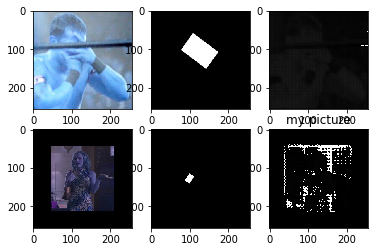

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
451
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
452
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
453
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
454
10/10 [==============================] - 0s 21ms/sample - loss: 0.0108
455
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
456
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
457
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
458
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
459
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
460
(2, 256, 256, 1)


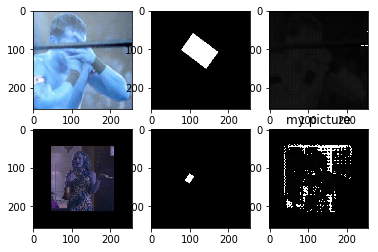

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
461
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
462
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
463
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
464
10/10 [==============================] - 0s 21ms/sample - loss: 0.0108
465
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
466
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
467
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
468
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
469
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
470
(2, 256, 256, 1)


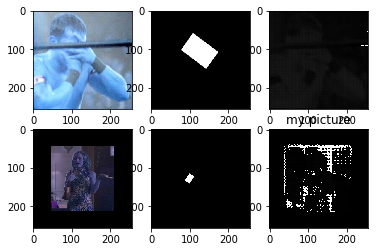

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
471
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
472
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
473
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
474
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
475
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
476
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
477
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
478
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
479
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
480
(2, 256, 256, 1)


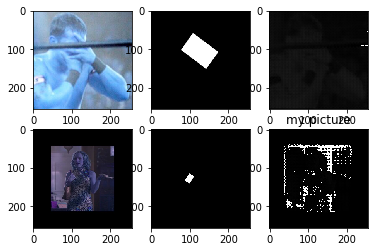

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
481
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
482
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
483
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
484
10/10 [==============================] - 0s 21ms/sample - loss: 0.0108
485
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
486
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
487
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
488
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
489
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
490
(2, 256, 256, 1)


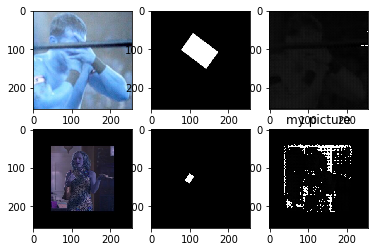

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
491
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
492
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
493
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
494
10/10 [==============================] - 0s 21ms/sample - loss: 0.0108
495
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
496
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
497
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
498
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
499
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
500
(2, 256, 256, 1)


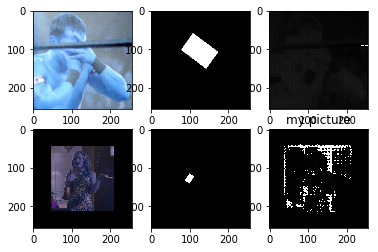

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
501
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
502
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
503
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
504
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
505
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
506
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
507
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
508
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
509
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
510
(2, 256, 256, 1)


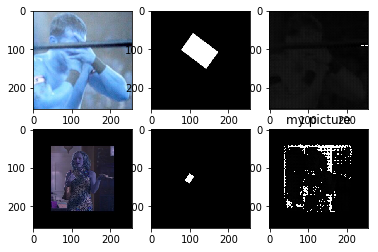

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
511
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
512
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
513
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
514
10/10 [==============================] - 0s 21ms/sample - loss: 0.0108
515
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
516
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
517
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
518
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
519
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
520
(2, 256, 256, 1)


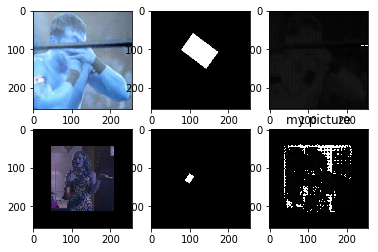

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
521
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
522
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
523
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
524
10/10 [==============================] - 0s 21ms/sample - loss: 0.0108
525
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
526
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
527
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
528
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
529
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
530
(2, 256, 256, 1)


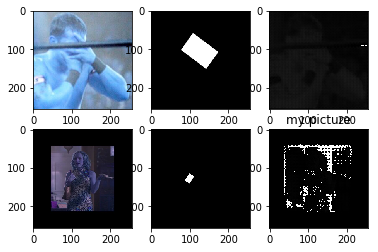

10/10 [==============================] - 0s 17ms/sample - loss: 0.0108
531
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
532
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
533
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
534
10/10 [==============================] - 0s 21ms/sample - loss: 0.0108
535
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
536
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
537
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
538
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
539
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
540
(2, 256, 256, 1)


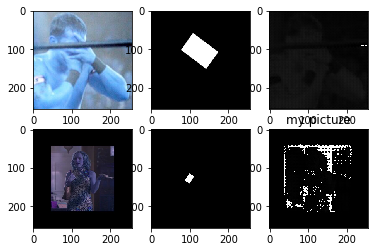

10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
541
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
542
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
543
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
544
10/10 [==============================] - 0s 21ms/sample - loss: 0.0108
545
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
546
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
547
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
548
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
549
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
550
(2, 256, 256, 1)


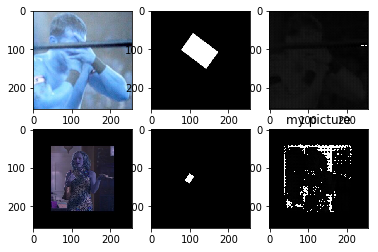

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
551
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
552
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
553
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
554
10/10 [==============================] - 0s 20ms/sample - loss: 0.0108
555
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
556
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
557
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
558
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
559
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
560
(2, 256, 256, 1)


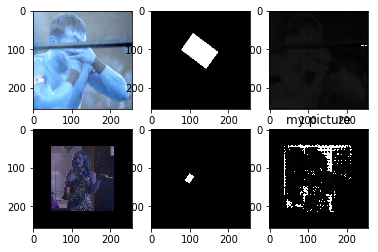

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
561
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
562
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
563
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
564
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
565
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
566
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
567
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
568
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
569
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
570
(2, 256, 256, 1)


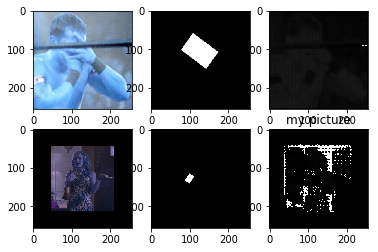

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
571
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
572
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
573
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
574
10/10 [==============================] - 0s 22ms/sample - loss: 0.0108
575
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
576
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
577
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
578
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
579
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
580
(2, 256, 256, 1)


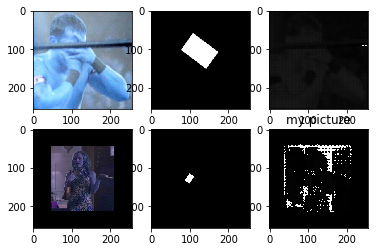

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
581
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
582
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
583
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
584
10/10 [==============================] - 0s 21ms/sample - loss: 0.0108
585
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
586
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
587
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
588
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
589
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
590
(2, 256, 256, 1)


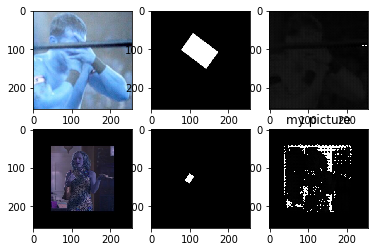

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
591
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
592
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
593
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
594
10/10 [==============================] - 0s 22ms/sample - loss: 0.0108
595
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
596
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
597
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
598
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
599
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
600
(2, 256, 256, 1)


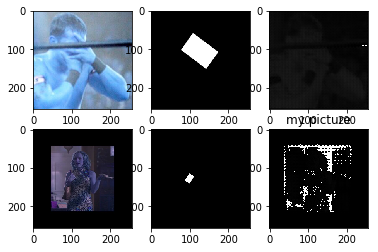

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
601
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
602
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
603
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
604
10/10 [==============================] - 0s 21ms/sample - loss: 0.0108
605
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
606
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
607
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
608
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
609
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
610
(2, 256, 256, 1)


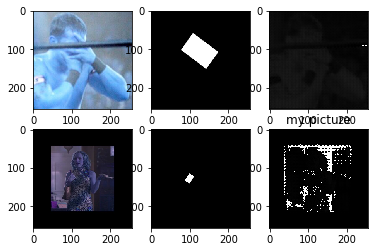

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
611
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
612
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
613
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
614
10/10 [==============================] - 0s 22ms/sample - loss: 0.0108
615
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
616
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
617
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
618
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
619
10/10 [==============================] - 0s 20ms/sample - loss: 0.0108
620
(2, 256, 256, 1)


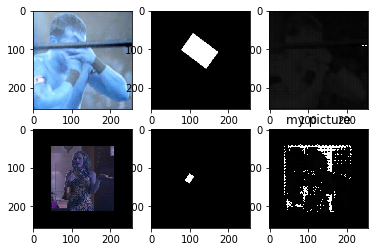

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
621
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
622
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
623
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
624
10/10 [==============================] - 0s 22ms/sample - loss: 0.0108
625
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
626
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
627
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
628
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
629
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
630
(2, 256, 256, 1)


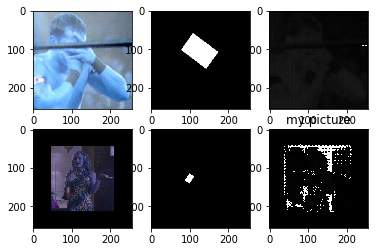

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
631
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
632
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
633
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
634
10/10 [==============================] - 0s 22ms/sample - loss: 0.0108
635
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
636
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
637
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
638
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
639
10/10 [==============================] - 0s 20ms/sample - loss: 0.0108
640
(2, 256, 256, 1)


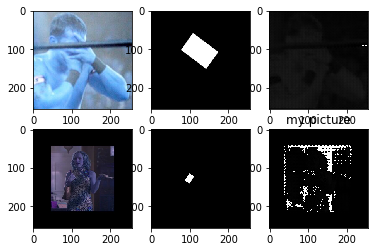

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
641
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
642
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
643
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
644
10/10 [==============================] - 0s 21ms/sample - loss: 0.0108
645
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
646
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
647
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
648
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
649
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
650
(2, 256, 256, 1)


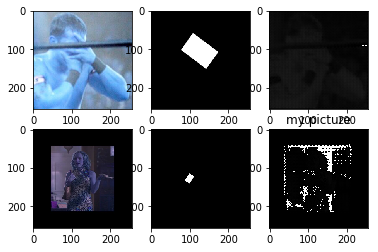

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
651
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
652
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
653
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
654
10/10 [==============================] - 0s 22ms/sample - loss: 0.0108
655
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
656
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
657
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
658
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
659
10/10 [==============================] - 0s 20ms/sample - loss: 0.0108
660
(2, 256, 256, 1)


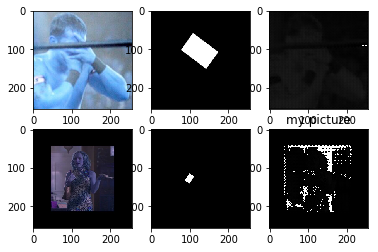

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
661
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
662
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
663
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
664
10/10 [==============================] - 0s 22ms/sample - loss: 0.0108
665
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
666
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
667
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
668
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
669
10/10 [==============================] - 0s 20ms/sample - loss: 0.0108
670
(2, 256, 256, 1)


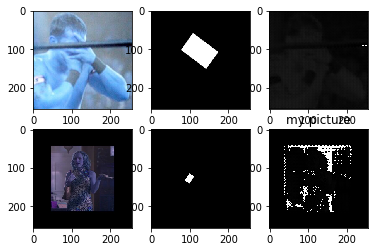

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
671
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
672
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
673
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
674
10/10 [==============================] - 0s 21ms/sample - loss: 0.0108
675
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
676
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
677
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
678
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
679
10/10 [==============================] - 0s 20ms/sample - loss: 0.0108
680
(2, 256, 256, 1)


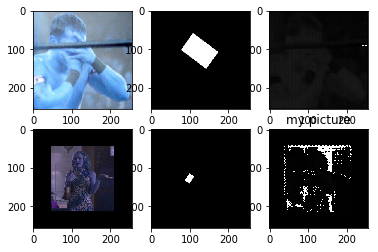

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
681
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
682
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
683
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
684
10/10 [==============================] - 0s 21ms/sample - loss: 0.0108
685
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
686
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
687
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
688
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
689
10/10 [==============================] - 0s 20ms/sample - loss: 0.0108
690
(2, 256, 256, 1)


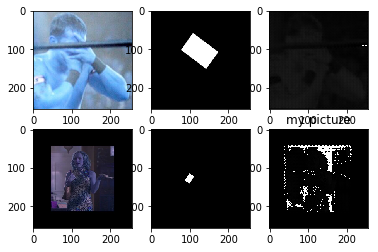

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
691
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
692
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
693
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
694
10/10 [==============================] - 0s 20ms/sample - loss: 0.0108
695
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
696
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
697
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
698
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
699
10/10 [==============================] - 0s 19ms/sample - loss: 0.0108
700
(2, 256, 256, 1)


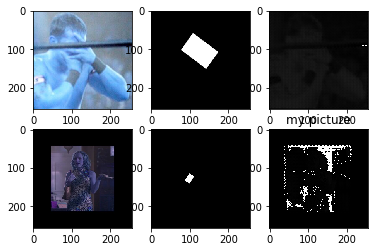

10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
701
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
702
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
703
10/10 [==============================] - 0s 18ms/sample - loss: 0.0108
704
10/10 [==============================] - 0s 20ms/sample - loss: 0.0108
705
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
706
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
707
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
708
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
709
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
710
(2, 256, 256, 1)


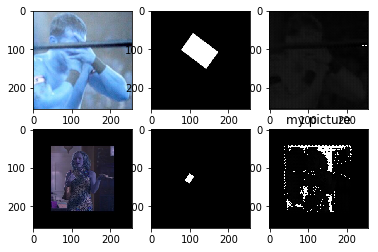

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
711
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
712
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
713
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
714
10/10 [==============================] - 0s 20ms/sample - loss: 0.0107
715
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
716
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
717
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
718
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
719
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
720
(2, 256, 256, 1)


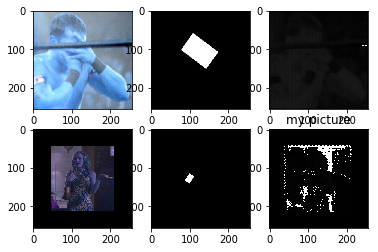

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
721
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
722
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
723
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
724
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
725
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
726
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
727
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
728
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
729
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
730
(2, 256, 256, 1)


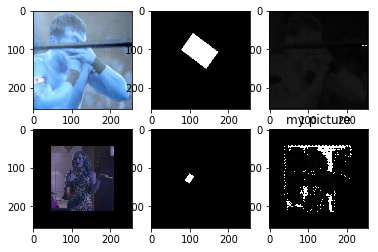

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
731
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
732
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
733
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
734
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
735
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
736
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
737
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
738
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
739
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
740
(2, 256, 256, 1)


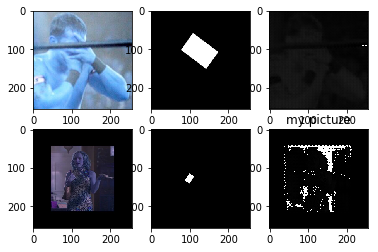

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
741
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
742
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
743
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
744
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
745
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
746
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
747
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
748
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
749
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
750
(2, 256, 256, 1)


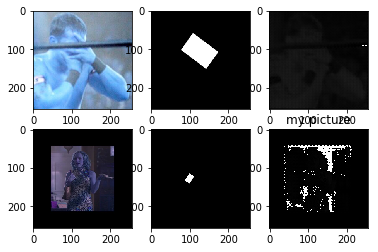

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
751
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
752
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
753
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
754
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
755
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
756
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
757
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
758
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
759
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
760
(2, 256, 256, 1)


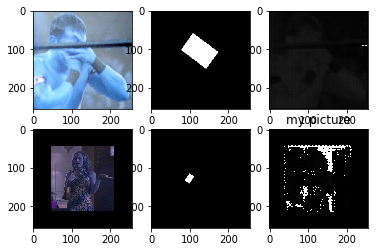

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
761
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
762
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
763
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
764
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
765
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
766
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
767
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
768
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
769
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
770
(2, 256, 256, 1)


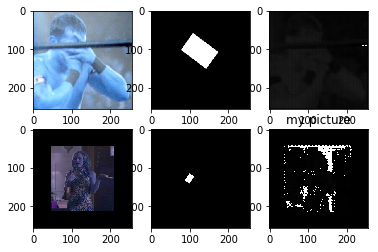

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
771
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
772
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
773
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
774
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
775
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
776
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
777
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
778
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
779
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
780
(2, 256, 256, 1)


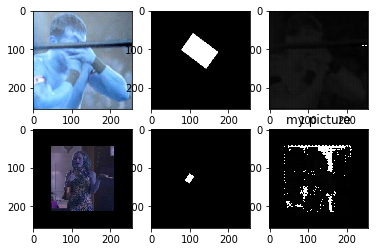

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
781
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
782
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
783
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
784
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
785
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
786
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
787
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
788
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
789
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
790
(2, 256, 256, 1)


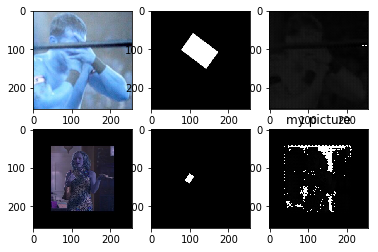

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
791
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
792
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
793
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
794
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
795
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
796
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
797
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
798
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
799
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
800
(2, 256, 256, 1)


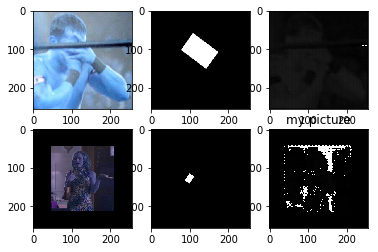

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
801
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
802
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
803
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
804
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
805
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
806
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
807
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
808
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
809
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
810
(2, 256, 256, 1)


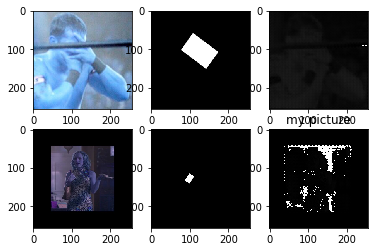

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
811
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
812
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
813
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
814
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
815
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
816
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
817
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
818
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
819
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
820
(2, 256, 256, 1)


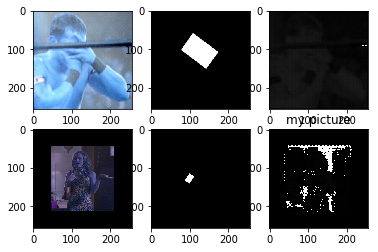

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
821
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
822
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
823
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
824
10/10 [==============================] - 0s 20ms/sample - loss: 0.0107
825
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
826
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
827
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
828
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
829
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
830
(2, 256, 256, 1)


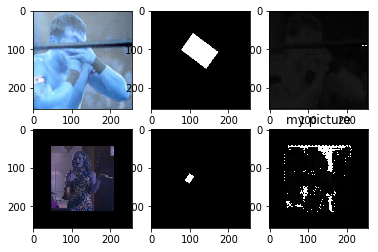

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
831
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
832
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
833
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
834
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
835
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
836
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
837
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
838
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
839
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
840
(2, 256, 256, 1)


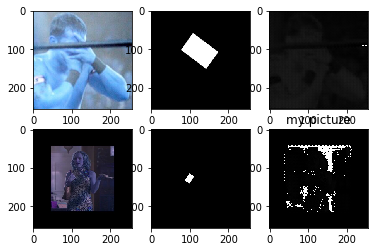

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
841
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
842
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
843
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
844
10/10 [==============================] - 0s 20ms/sample - loss: 0.0107
845
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
846
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
847
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
848
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
849
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
850
(2, 256, 256, 1)


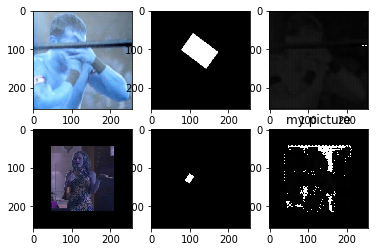

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
851
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
852
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
853
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
854
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
855
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
856
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
857
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
858
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
859
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
860
(2, 256, 256, 1)


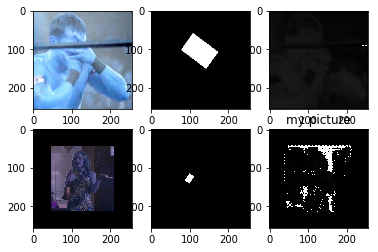

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
861
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
862
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
863
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
864
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
865
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
866
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
867
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
868
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
869
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
870
(2, 256, 256, 1)


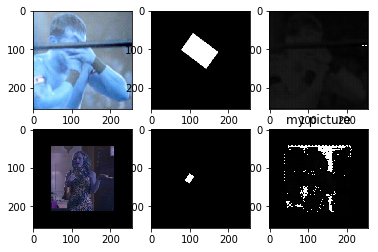

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
871
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
872
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
873
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
874
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
875
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
876
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
877
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
878
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
879
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
880
(2, 256, 256, 1)


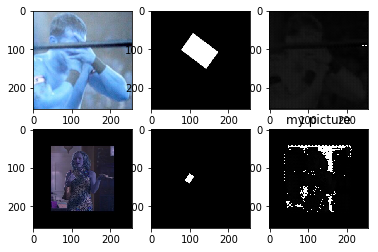

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
881
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
882
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
883
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
884
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
885
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
886
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
887
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
888
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
889
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
890
(2, 256, 256, 1)


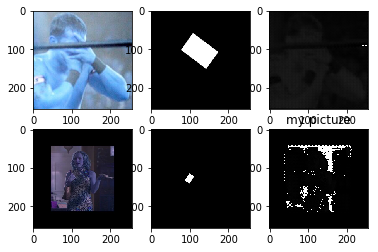

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
891
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
892
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
893
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
894
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
895
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
896
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
897
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
898
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
899
10/10 [==============================] - 0s 20ms/sample - loss: 0.0107
900
(2, 256, 256, 1)


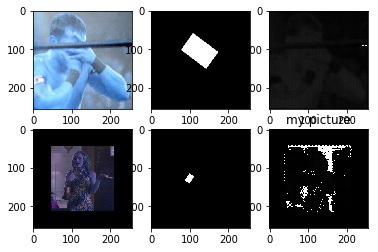

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
901
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
902
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
903
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
904
10/10 [==============================] - 0s 22ms/sample - loss: 0.0107
905
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
906
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
907
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
908
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
909
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
910
(2, 256, 256, 1)


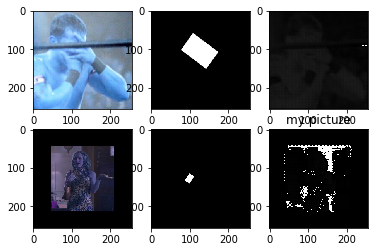

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
911
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
912
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
913
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
914
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
915
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
916
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
917
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
918
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
919
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
920
(2, 256, 256, 1)


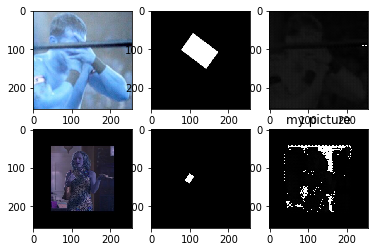

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
921
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
922
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
923
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
924
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
925
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
926
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
927
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
928
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
929
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
930
(2, 256, 256, 1)


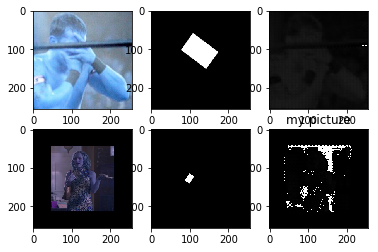

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
931
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
932
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
933
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
934
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
935
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
936
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
937
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
938
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
939
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
940
(2, 256, 256, 1)


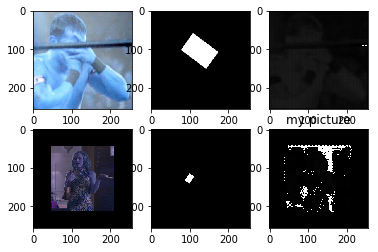

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
941
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
942
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
943
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
944
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
945
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
946
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
947
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
948
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
949
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
950
(2, 256, 256, 1)


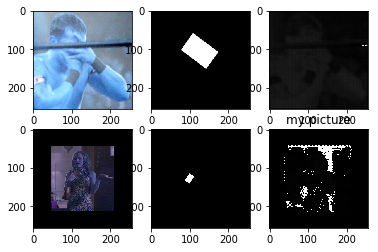

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
951
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
952
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
953
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
954
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
955
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
956
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
957
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
958
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
959
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
960
(2, 256, 256, 1)


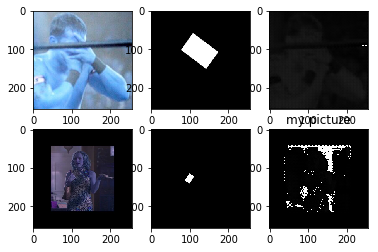

10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
961
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
962
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
963
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
964
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
965
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
966
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
967
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
968
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
969
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
970
(2, 256, 256, 1)


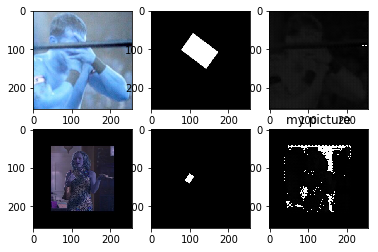

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
971
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
972
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
973
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
974
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
975
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
976
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
977
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
978
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
979
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
980
(2, 256, 256, 1)


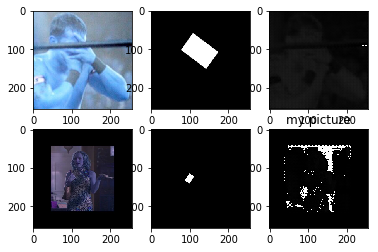

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
981
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
982
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
983
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
984
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
985
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
986
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
987
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
988
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
989
10/10 [==============================] - 0s 20ms/sample - loss: 0.0107
990
(2, 256, 256, 1)


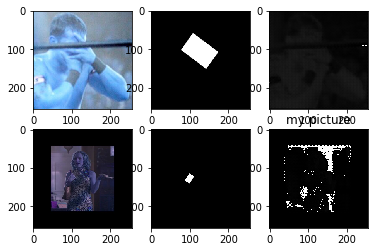

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
991
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
992
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
993
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
994
10/10 [==============================] - 0s 22ms/sample - loss: 0.0107
995
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
996
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
997
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
998
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
999
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1000
(2, 256, 256, 1)


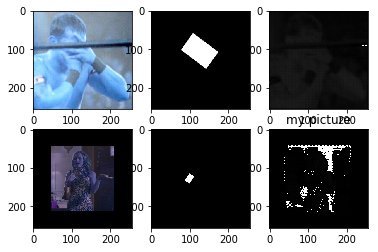

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1001
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1002
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1003
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1004
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1005
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1006
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1007
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1008
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1009
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1010
(2, 256, 256, 1)


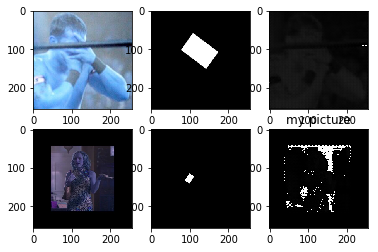

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1011
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1012
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1013
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1014
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1015
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1016
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1017
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1018
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1019
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1020
(2, 256, 256, 1)


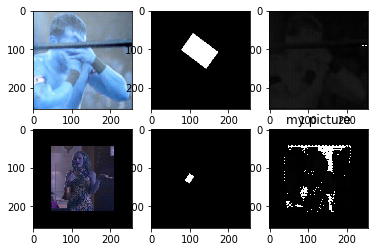

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1021
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1022
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1023
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1024
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1025
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1026
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1027
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1028
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1029
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1030
(2, 256, 256, 1)


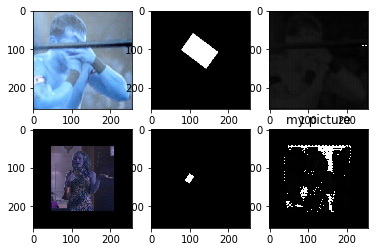

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1031
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1032
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1033
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1034
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1035
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1036
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1037
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1038
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1039
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1040
(2, 256, 256, 1)


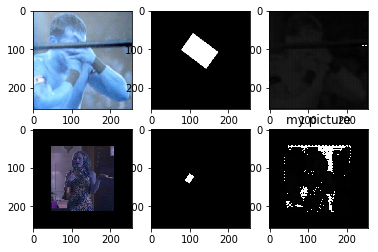

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1041
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1042
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1043
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1044
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1045
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1046
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1047
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1048
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1049
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1050
(2, 256, 256, 1)


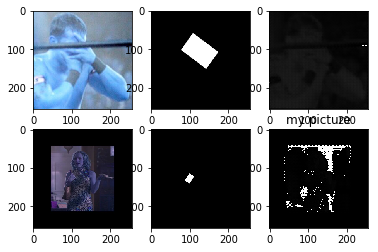

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1051
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1052
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1053
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1054
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1055
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1056
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1057
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1058
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1059
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1060
(2, 256, 256, 1)


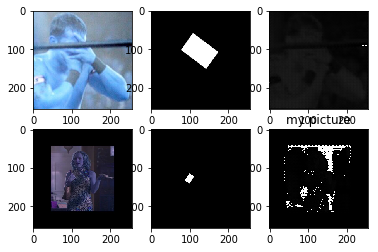

10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1061
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1062
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1063
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1064
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1065
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1066
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1067
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1068
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1069
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1070
(2, 256, 256, 1)


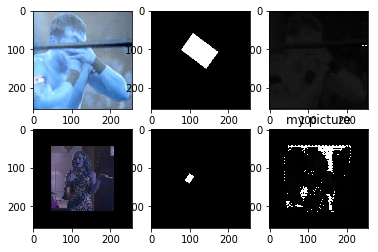

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1071
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1072
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1073
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1074
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1075
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1076
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1077
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1078
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1079
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1080
(2, 256, 256, 1)


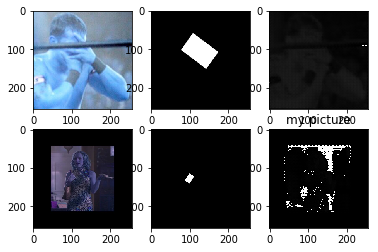

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1081
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1082
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1083
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1084
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1085
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1086
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1087
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1088
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1089
10/10 [==============================] - 0s 20ms/sample - loss: 0.0107
1090
(2, 256, 256, 1)


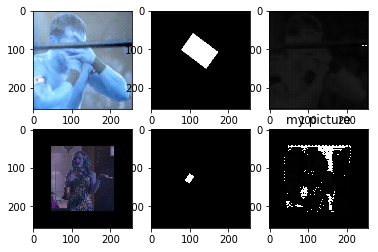

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1091
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1092
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1093
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1094
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1095
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1096
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1097
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1098
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1099
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1100
(2, 256, 256, 1)


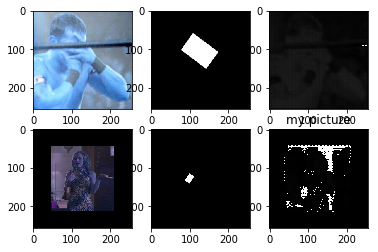

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1101
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1102
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1103
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1104
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1105
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1106
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1107
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1108
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1109
10/10 [==============================] - 0s 20ms/sample - loss: 0.0107
1110
(2, 256, 256, 1)


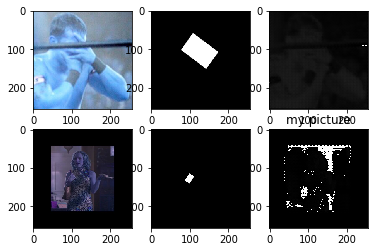

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1111
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1112
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1113
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1114
10/10 [==============================] - 0s 22ms/sample - loss: 0.0107
1115
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1116
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1117
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1118
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1119
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1120
(2, 256, 256, 1)


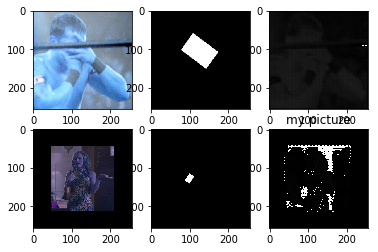

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1121
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1122
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1123
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1124
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1125
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1126
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1127
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1128
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1129
10/10 [==============================] - 0s 20ms/sample - loss: 0.0107
1130
(2, 256, 256, 1)


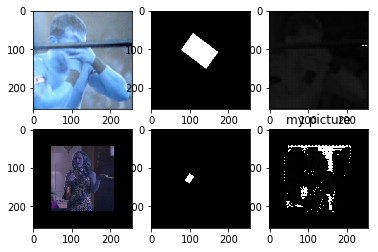

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1131
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1132
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1133
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1134
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1135
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1136
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1137
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1138
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1139
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1140
(2, 256, 256, 1)


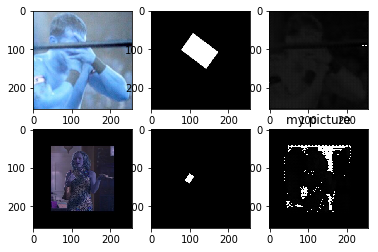

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1141
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1142
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1143
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1144
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1145
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1146
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1147
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1148
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1149
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1150
(2, 256, 256, 1)


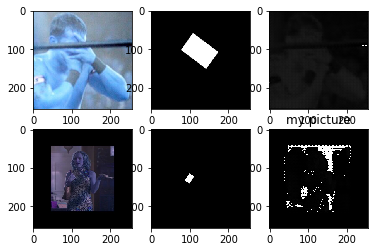

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1151
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1152
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1153
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1154
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1155
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1156
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1157
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1158
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1159
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1160
(2, 256, 256, 1)


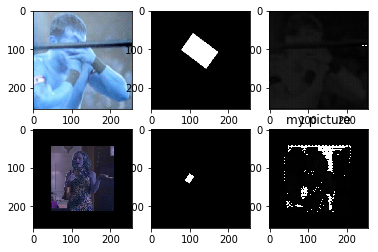

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1161
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1162
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1163
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1164
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1165
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1166
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1167
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1168
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1169
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1170
(2, 256, 256, 1)


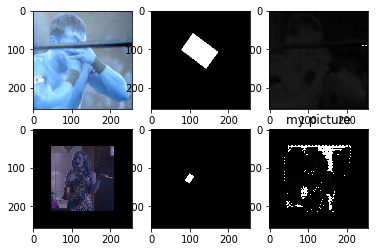

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1171
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1172
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1173
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1174
10/10 [==============================] - 0s 22ms/sample - loss: 0.0107
1175
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1176
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1177
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1178
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1179
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1180
(2, 256, 256, 1)


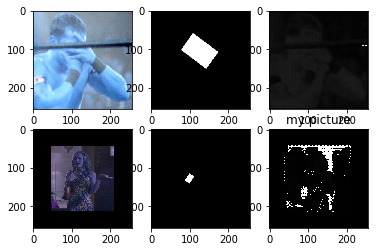

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1181
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1182
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1183
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1184
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1185
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1186
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1187
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1188
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1189
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1190
(2, 256, 256, 1)


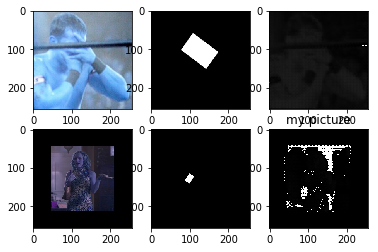

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1191
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1192
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1193
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1194
10/10 [==============================] - 0s 20ms/sample - loss: 0.0107
1195
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1196
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1197
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1198
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1199
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1200
(2, 256, 256, 1)


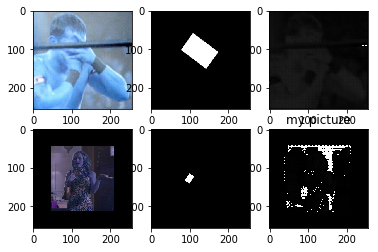

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1201
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1202
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1203
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1204
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1205
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1206
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1207
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1208
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1209
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1210
(2, 256, 256, 1)


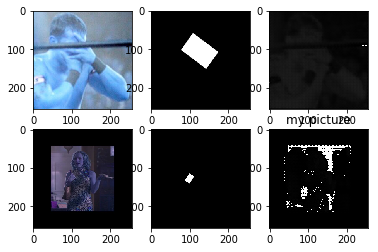

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1211
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1212
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1213
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1214
10/10 [==============================] - 0s 22ms/sample - loss: 0.0107
1215
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1216
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1217
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1218
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1219
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1220
(2, 256, 256, 1)


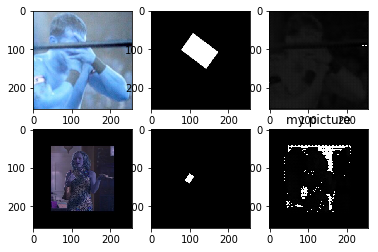

10/10 [==============================] - 0s 17ms/sample - loss: 0.0107
1221
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1222
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1223
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1224
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1225
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1226
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1227
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1228
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1229
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1230
(2, 256, 256, 1)


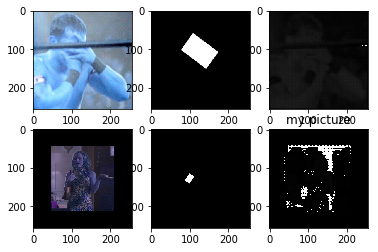

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1231
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1232
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1233
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1234
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1235
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1236
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1237
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1238
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1239
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1240
(2, 256, 256, 1)


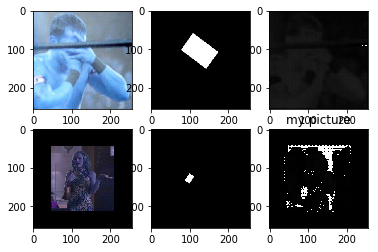

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1241
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1242
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1243
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1244
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1245
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1246
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1247
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1248
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1249
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1250
(2, 256, 256, 1)


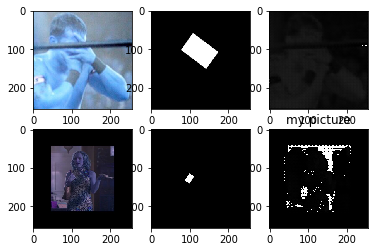

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1251
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1252
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1253
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1254
10/10 [==============================] - 0s 20ms/sample - loss: 0.0107
1255
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1256
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1257
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1258
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1259
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1260
(2, 256, 256, 1)


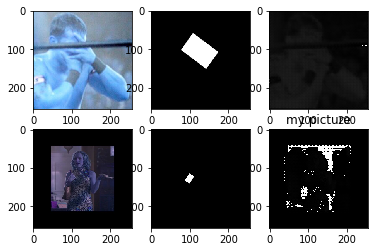

10/10 [==============================] - 0s 17ms/sample - loss: 0.0107
1261
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1262
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1263
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1264
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1265
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1266
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1267
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1268
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1269
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1270
(2, 256, 256, 1)


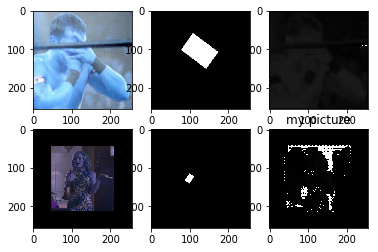

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1271
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1272
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1273
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1274
10/10 [==============================] - 0s 20ms/sample - loss: 0.0107
1275
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1276
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1277
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1278
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1279
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1280
(2, 256, 256, 1)


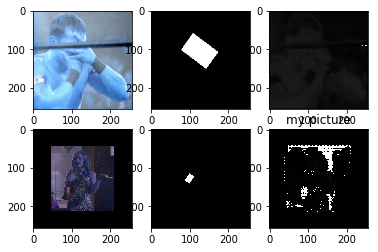

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1281
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1282
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1283
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1284
10/10 [==============================] - 0s 22ms/sample - loss: 0.0107
1285
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1286
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1287
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1288
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1289
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1290
(2, 256, 256, 1)


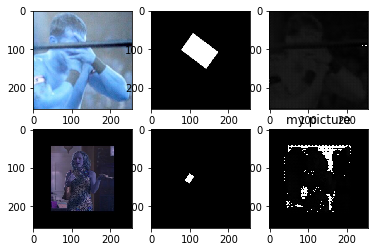

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1291
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1292
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1293
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1294
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1295
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1296
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1297
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1298
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1299
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1300
(2, 256, 256, 1)


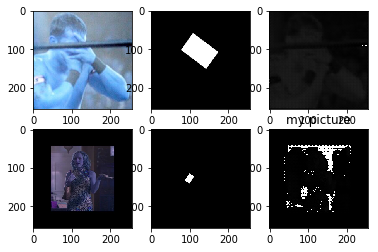

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1301
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1302
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1303
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1304
10/10 [==============================] - 0s 22ms/sample - loss: 0.0107
1305
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1306
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1307
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1308
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1309
10/10 [==============================] - 0s 20ms/sample - loss: 0.0107
1310
(2, 256, 256, 1)


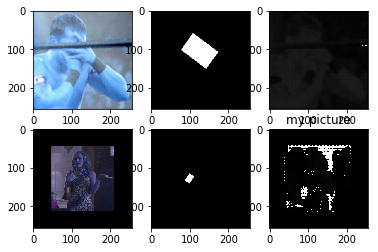

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1311
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1312
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1313
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1314
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1315
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1316
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1317
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1318
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1319
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1320
(2, 256, 256, 1)


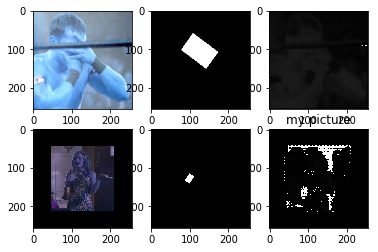

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1321
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1322
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1323
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1324
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1325
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1326
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1327
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1328
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1329
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1330
(2, 256, 256, 1)


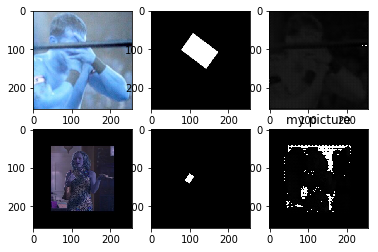

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1331
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1332
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1333
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1334
10/10 [==============================] - 0s 22ms/sample - loss: 0.0107
1335
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1336
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1337
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1338
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1339
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1340
(2, 256, 256, 1)


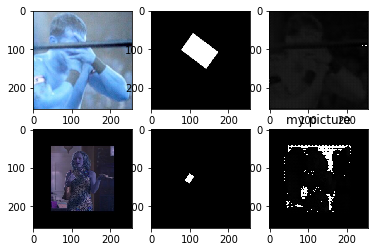

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1341
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1342
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1343
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1344
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1345
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1346
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1347
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1348
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1349
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1350
(2, 256, 256, 1)


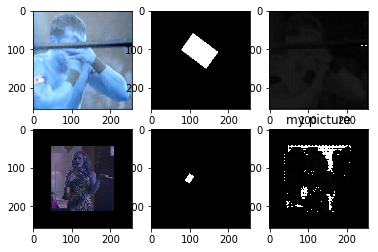

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1351
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1352
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1353
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1354
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1355
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1356
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1357
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1358
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1359
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1360
(2, 256, 256, 1)


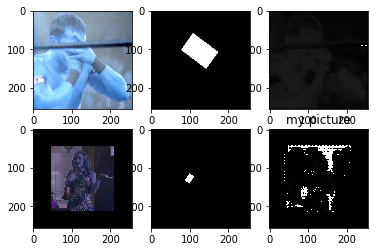

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1361
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1362
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1363
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1364
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1365
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1366
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1367
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1368
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1369
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1370
(2, 256, 256, 1)


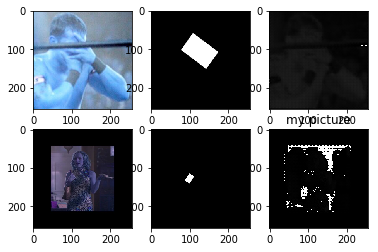

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1371
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1372
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1373
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1374
10/10 [==============================] - 0s 20ms/sample - loss: 0.0107
1375
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1376
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1377
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1378
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1379
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1380
(2, 256, 256, 1)


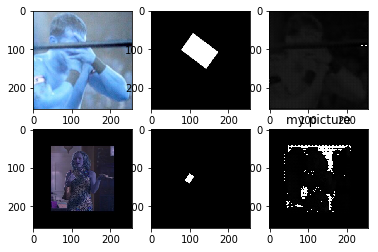

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1381
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1382
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1383
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1384
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1385
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1386
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1387
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1388
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1389
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1390
(2, 256, 256, 1)


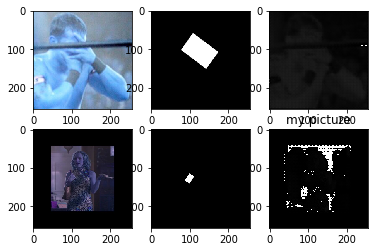

10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1391
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1392
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1393
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1394
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1395
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1396
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1397
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1398
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1399
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1400
(2, 256, 256, 1)


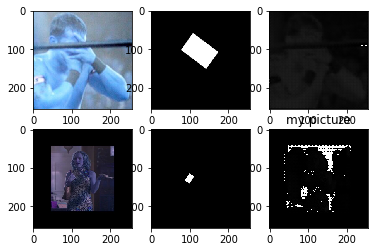

10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1401
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1402
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1403
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1404
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1405
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1406
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1407
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1408
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1409
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1410
(2, 256, 256, 1)


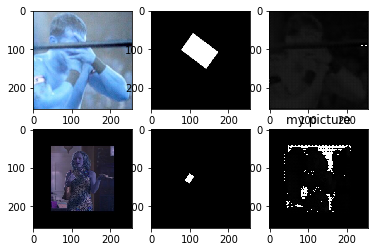

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1411
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1412
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1413
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1414
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1415
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1416
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1417
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1418
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1419
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1420
(2, 256, 256, 1)


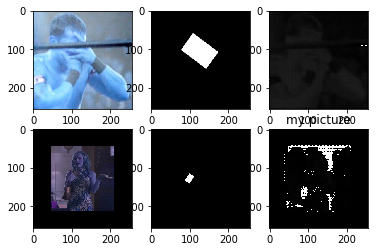

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1421
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1422
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1423
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1424
10/10 [==============================] - 0s 22ms/sample - loss: 0.0107
1425
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1426
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1427
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1428
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1429
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1430
(2, 256, 256, 1)


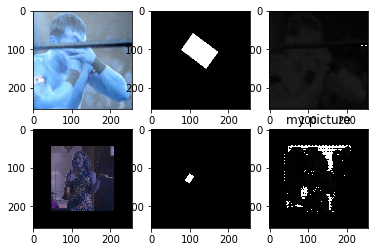

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1431
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1432
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1433
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1434
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1435
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1436
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1437
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1438
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1439
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1440
(2, 256, 256, 1)


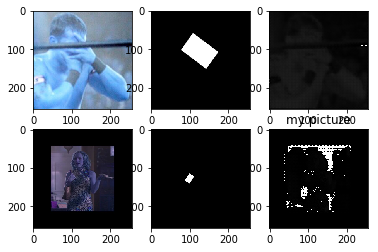

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1441
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1442
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1443
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1444
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1445
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1446
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1447
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1448
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1449
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1450
(2, 256, 256, 1)


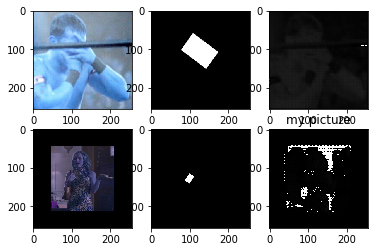

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1451
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1452
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1453
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1454
10/10 [==============================] - 0s 20ms/sample - loss: 0.0107
1455
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1456
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1457
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1458
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1459
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1460
(2, 256, 256, 1)


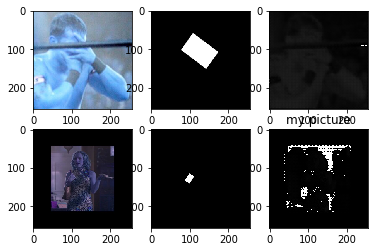

10/10 [==============================] - 0s 17ms/sample - loss: 0.0107
1461
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1462
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1463
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1464
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1465
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1466
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1467
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1468
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1469
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1470
(2, 256, 256, 1)


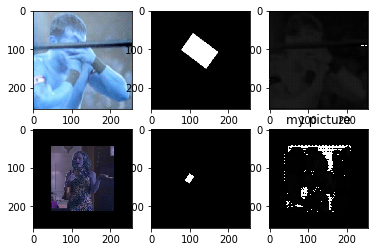

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1471
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1472
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1473
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1474
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1475
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1476
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1477
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1478
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1479
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1480
(2, 256, 256, 1)


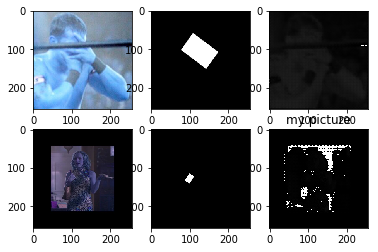

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1481
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1482
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1483
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1484
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1485
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1486
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1487
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1488
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1489
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1490
(2, 256, 256, 1)


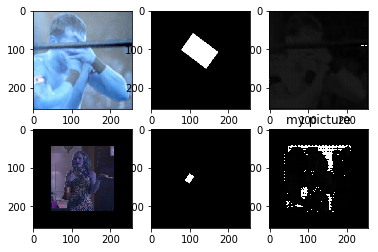

10/10 [==============================] - 0s 17ms/sample - loss: 0.0107
1491
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1492
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1493
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1494
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1495
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1496
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1497
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1498
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1499
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1500
(2, 256, 256, 1)


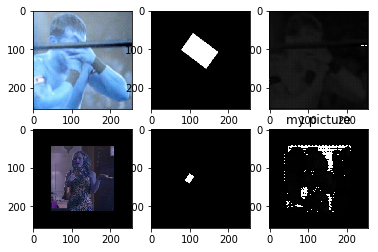

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1501
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1502
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1503
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1504
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1505
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1506
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1507
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1508
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1509
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1510
(2, 256, 256, 1)


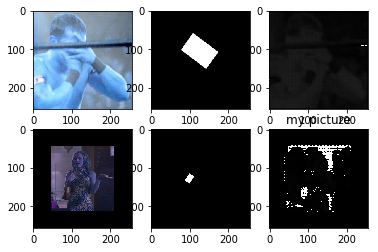

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1511
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1512
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1513
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1514
10/10 [==============================] - 0s 22ms/sample - loss: 0.0107
1515
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1516
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1517
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1518
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1519
10/10 [==============================] - 0s 20ms/sample - loss: 0.0107
1520
(2, 256, 256, 1)


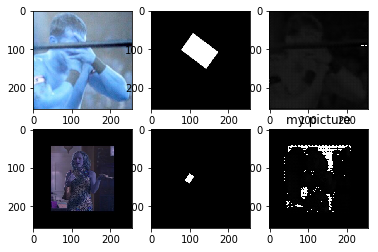

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1521
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1522
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1523
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1524
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1525
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1526
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1527
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1528
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1529
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1530
(2, 256, 256, 1)


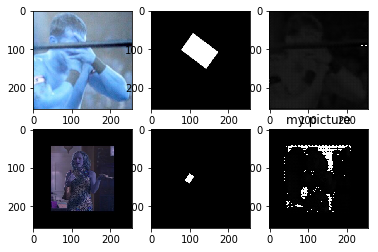

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1531
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1532
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1533
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1534
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1535
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1536
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1537
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1538
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1539
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1540
(2, 256, 256, 1)


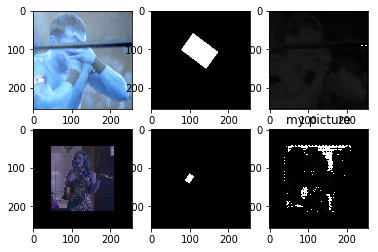

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1541
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1542
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1543
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1544
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1545
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1546
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1547
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1548
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1549
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1550
(2, 256, 256, 1)


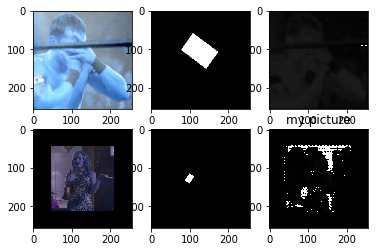

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1551
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1552
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1553
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1554
10/10 [==============================] - 0s 20ms/sample - loss: 0.0107
1555
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1556
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1557
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1558
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1559
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1560
(2, 256, 256, 1)


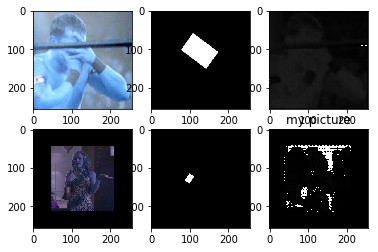

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1561
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1562
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1563
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1564
10/10 [==============================] - 0s 20ms/sample - loss: 0.0107
1565
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1566
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1567
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1568
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1569
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1570
(2, 256, 256, 1)


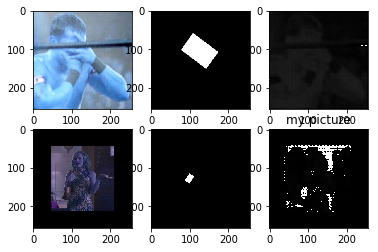

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1571
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1572
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1573
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1574
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1575
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1576
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1577
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1578
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1579
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1580
(2, 256, 256, 1)


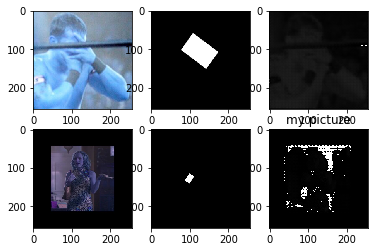

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1581
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1582
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1583
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1584
10/10 [==============================] - 0s 22ms/sample - loss: 0.0107
1585
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1586
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1587
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1588
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1589
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1590
(2, 256, 256, 1)


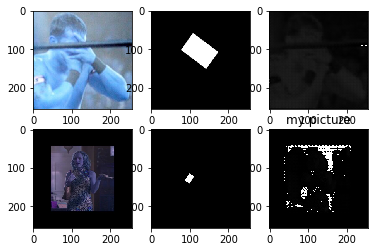

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1591
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1592
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1593
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1594
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1595
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1596
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1597
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1598
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1599
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1600
(2, 256, 256, 1)


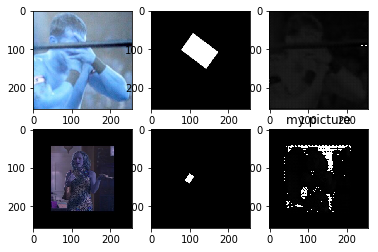

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1601
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1602
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1603
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1604
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1605
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1606
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1607
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1608
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1609
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1610
(2, 256, 256, 1)


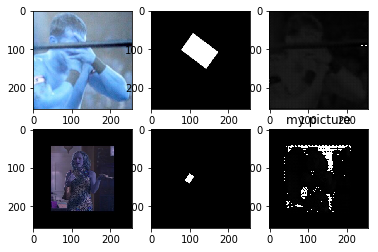

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1611
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1612
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1613
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1614
10/10 [==============================] - 0s 22ms/sample - loss: 0.0107
1615
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1616
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1617
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1618
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1619
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1620
(2, 256, 256, 1)


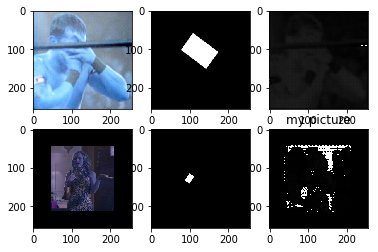

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1621
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1622
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1623
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1624
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1625
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1626
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1627
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1628
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1629
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1630
(2, 256, 256, 1)


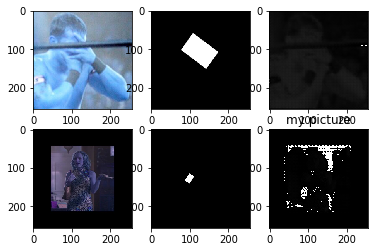

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1631
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1632
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1633
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1634
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1635
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1636
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1637
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1638
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1639
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1640
(2, 256, 256, 1)


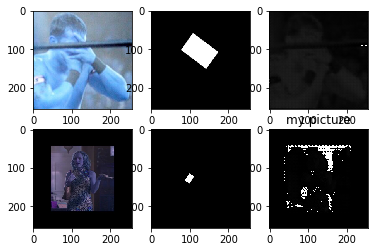

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1641
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1642
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1643
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1644
10/10 [==============================] - 0s 22ms/sample - loss: 0.0107
1645
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1646
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1647
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1648
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1649
10/10 [==============================] - 0s 20ms/sample - loss: 0.0107
1650
(2, 256, 256, 1)


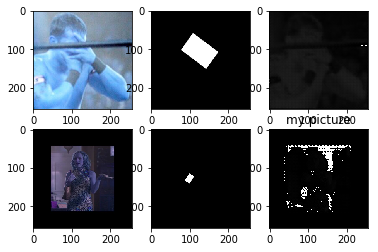

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1651
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1652
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1653
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1654
10/10 [==============================] - 0s 22ms/sample - loss: 0.0107
1655
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1656
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1657
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1658
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1659
10/10 [==============================] - 0s 20ms/sample - loss: 0.0107
1660
(2, 256, 256, 1)


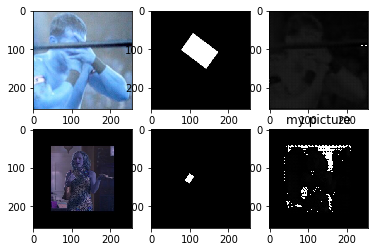

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1661
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1662
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1663
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1664
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1665
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1666
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1667
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1668
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1669
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1670
(2, 256, 256, 1)


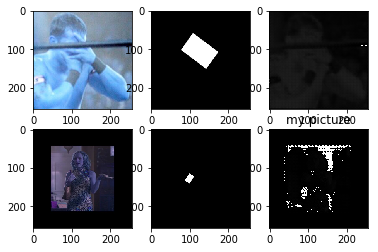

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1671
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1672
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1673
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1674
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1675
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1676
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1677
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1678
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1679
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1680
(2, 256, 256, 1)


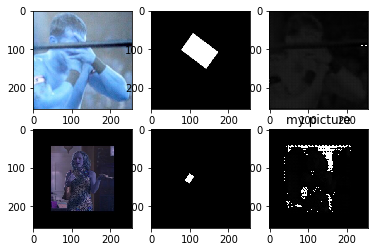

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1681
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1682
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1683
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1684
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1685
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1686
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1687
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1688
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1689
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1690
(2, 256, 256, 1)


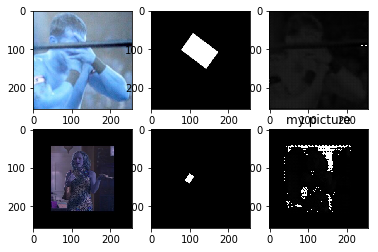

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1691
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1692
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1693
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1694
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1695
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1696
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1697
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1698
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1699
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1700
(2, 256, 256, 1)


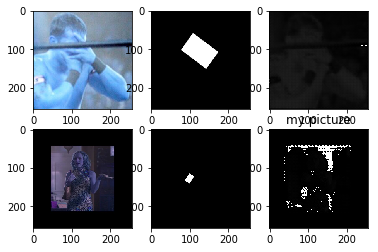

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1701
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1702
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1703
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1704
10/10 [==============================] - 0s 22ms/sample - loss: 0.0107
1705
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1706
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1707
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1708
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1709
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1710
(2, 256, 256, 1)


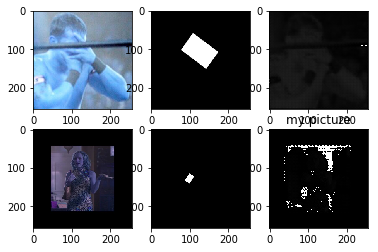

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1711
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1712
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1713
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1714
10/10 [==============================] - 0s 22ms/sample - loss: 0.0107
1715
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1716
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1717
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1718
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1719
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1720
(2, 256, 256, 1)


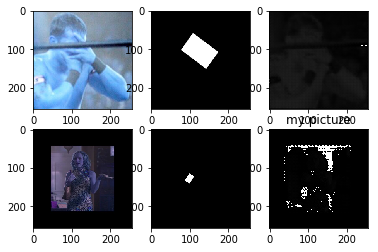

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1721
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1722
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1723
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1724
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1725
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1726
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1727
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1728
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1729
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1730
(2, 256, 256, 1)


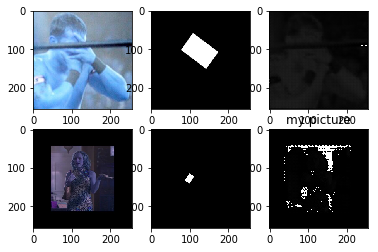

10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1731
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1732
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1733
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1734
10/10 [==============================] - 0s 21ms/sample - loss: 0.0107
1735
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1736
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1737
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1738
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1739
10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1740
(2, 256, 256, 1)


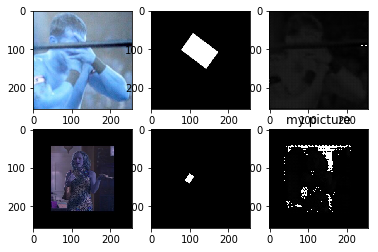

10/10 [==============================] - 0s 19ms/sample - loss: 0.0107
1741
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1742
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1743
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1744
10/10 [==============================] - 0s 20ms/sample - loss: 0.0107
1745
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1746
10/10 [==============================] - 0s 18ms/sample - loss: 0.0107
1747
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1748
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1749
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1750
(2, 256, 256, 1)


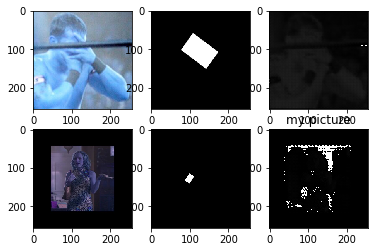

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1751
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1752
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1753
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1754
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
1755
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1756
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1757
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1758
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1759
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1760
(2, 256, 256, 1)


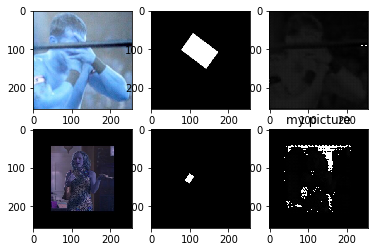

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1761
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1762
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1763
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1764
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
1765
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1766
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1767
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1768
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1769
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1770
(2, 256, 256, 1)


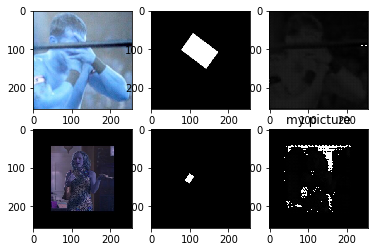

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1771
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1772
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1773
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1774
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
1775
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1776
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1777
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1778
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1779
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1780
(2, 256, 256, 1)


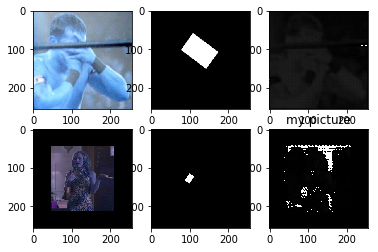

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1781
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1782
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1783
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1784
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
1785
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1786
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1787
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1788
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1789
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1790
(2, 256, 256, 1)


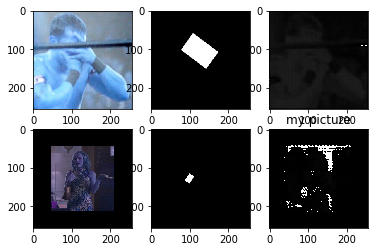

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1791
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1792
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1793
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1794
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
1795
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1796
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1797
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1798
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1799
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
1800
(2, 256, 256, 1)


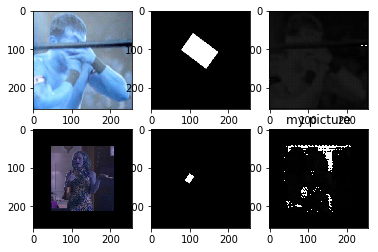

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1801
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1802
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1803
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1804
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
1805
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1806
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1807
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1808
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1809
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1810
(2, 256, 256, 1)


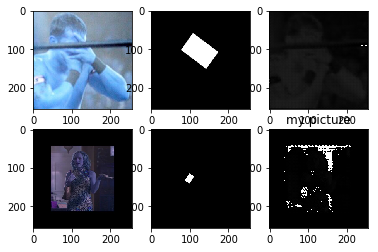

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1811
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1812
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1813
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1814
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
1815
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1816
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1817
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1818
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1819
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
1820
(2, 256, 256, 1)


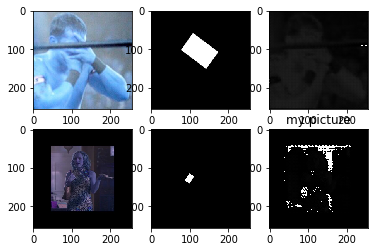

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1821
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1822
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1823
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1824
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
1825
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1826
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1827
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1828
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1829
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1830
(2, 256, 256, 1)


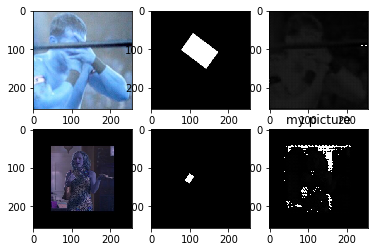

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1831
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1832
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1833
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1834
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
1835
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1836
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1837
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1838
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1839
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1840
(2, 256, 256, 1)


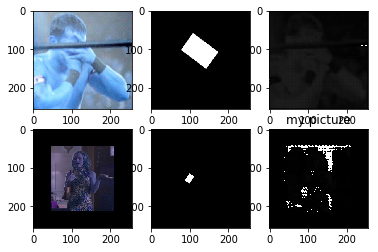

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1841
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1842
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1843
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1844
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
1845
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1846
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1847
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1848
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1849
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1850
(2, 256, 256, 1)


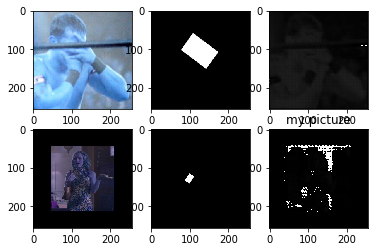

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1851
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1852
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1853
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1854
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
1855
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1856
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1857
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1858
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1859
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1860
(2, 256, 256, 1)


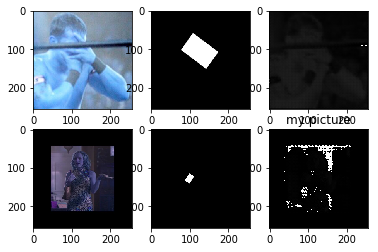

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1861
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1862
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1863
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1864
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
1865
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1866
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1867
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1868
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1869
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1870
(2, 256, 256, 1)


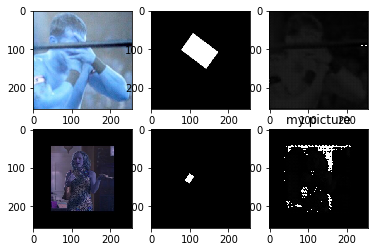

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1871
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1872
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1873
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1874
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1875
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1876
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1877
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1878
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1879
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1880
(2, 256, 256, 1)


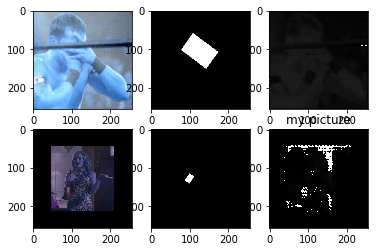

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1881
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1882
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1883
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1884
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
1885
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1886
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1887
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1888
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1889
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1890
(2, 256, 256, 1)


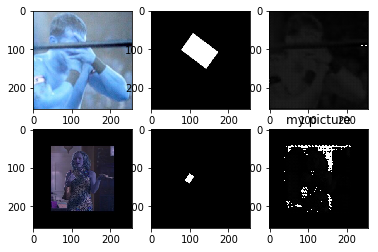

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1891
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1892
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1893
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1894
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
1895
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1896
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1897
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1898
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1899
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1900
(2, 256, 256, 1)


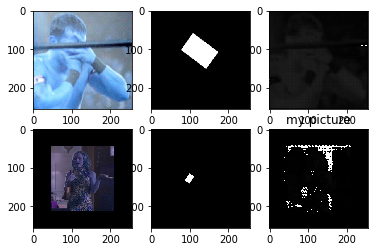

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1901
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1902
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1903
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1904
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
1905
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1906
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1907
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1908
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1909
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1910
(2, 256, 256, 1)


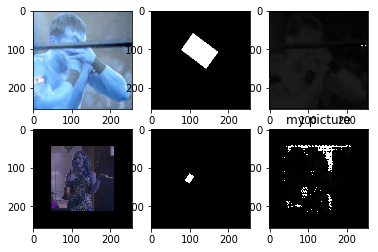

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1911
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1912
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1913
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1914
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
1915
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1916
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1917
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1918
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1919
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1920
(2, 256, 256, 1)


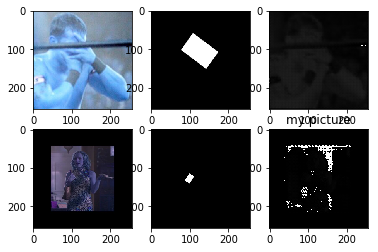

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1921
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1922
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1923
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1924
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
1925
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1926
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1927
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1928
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1929
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1930
(2, 256, 256, 1)


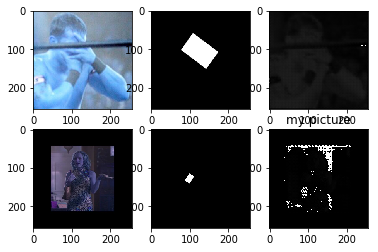

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1931
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1932
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1933
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1934
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
1935
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1936
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1937
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1938
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1939
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1940
(2, 256, 256, 1)


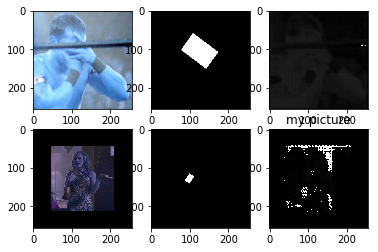

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1941
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1942
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1943
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1944
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
1945
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1946
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1947
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1948
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1949
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
1950
(2, 256, 256, 1)


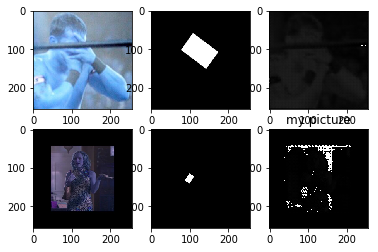

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1951
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1952
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1953
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1954
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
1955
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1956
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1957
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1958
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1959
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1960
(2, 256, 256, 1)


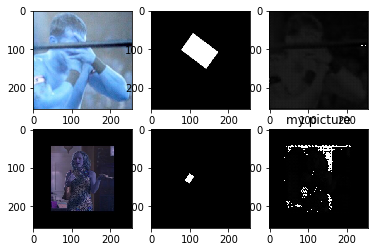

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1961
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1962
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1963
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1964
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
1965
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1966
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1967
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1968
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1969
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1970
(2, 256, 256, 1)


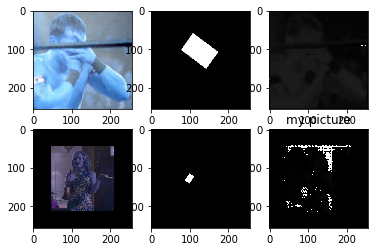

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1971
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1972
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1973
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1974
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
1975
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1976
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1977
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1978
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1979
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
1980
(2, 256, 256, 1)


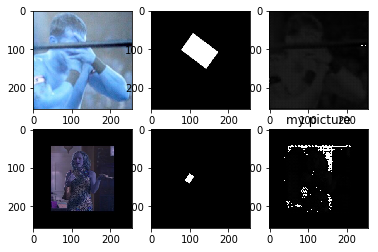

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1981
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1982
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1983
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1984
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
1985
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1986
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1987
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1988
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1989
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1990
(2, 256, 256, 1)


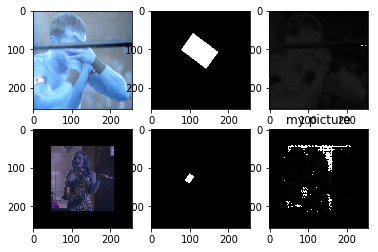

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1991
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1992
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1993
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1994
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
1995
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
1996
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1997
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1998
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
1999
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2000
(2, 256, 256, 1)


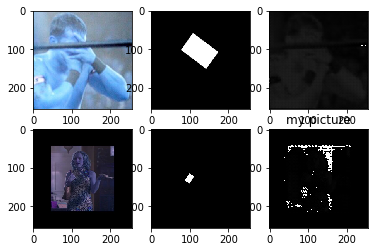

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2001
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2002
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2003
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2004
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2005
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2006
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2007
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2008
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2009
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2010
(2, 256, 256, 1)


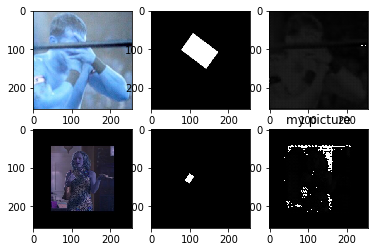

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2011
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2012
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2013
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2014
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2015
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2016
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2017
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2018
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2019
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2020
(2, 256, 256, 1)


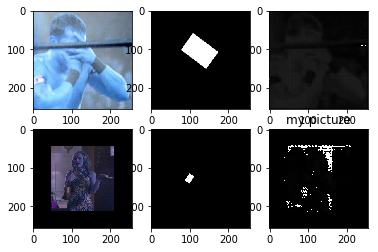

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2021
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2022
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2023
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2024
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2025
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2026
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2027
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2028
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2029
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2030
(2, 256, 256, 1)


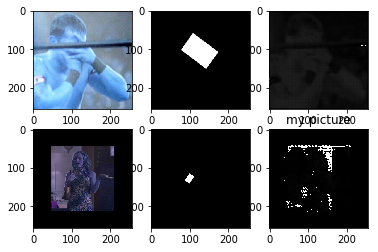

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2031
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2032
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2033
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2034
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2035
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2036
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2037
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2038
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2039
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2040
(2, 256, 256, 1)


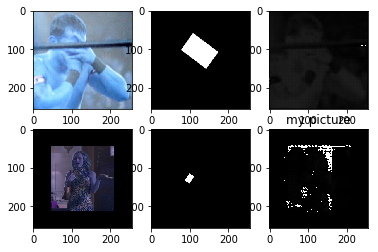

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2041
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2042
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2043
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2044
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
2045
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2046
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2047
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2048
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2049
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2050
(2, 256, 256, 1)


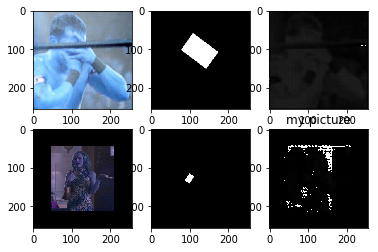

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2051
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2052
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2053
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2054
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2055
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2056
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2057
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2058
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2059
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2060
(2, 256, 256, 1)


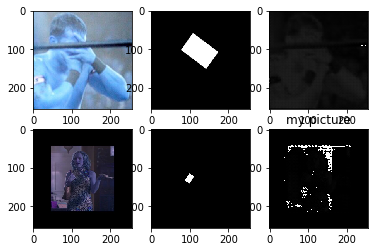

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2061
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2062
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2063
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2064
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2065
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2066
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2067
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2068
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2069
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2070
(2, 256, 256, 1)


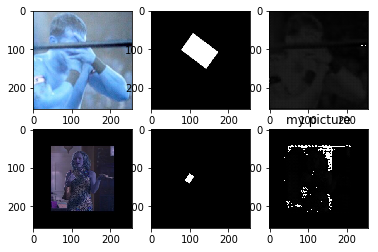

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2071
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2072
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2073
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2074
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2075
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2076
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2077
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2078
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2079
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2080
(2, 256, 256, 1)


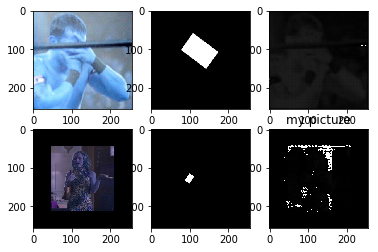

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2081
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2082
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2083
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2084
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2085
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2086
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2087
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2088
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2089
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2090
(2, 256, 256, 1)


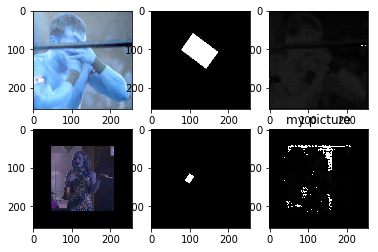

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2091
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2092
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2093
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2094
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
2095
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2096
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2097
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2098
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2099
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2100
(2, 256, 256, 1)


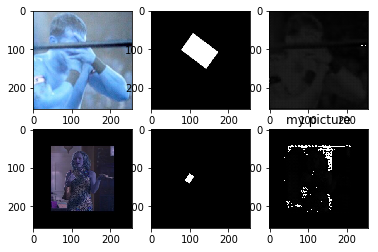

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2101
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2102
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2103
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2104
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2105
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2106
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2107
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2108
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2109
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2110
(2, 256, 256, 1)


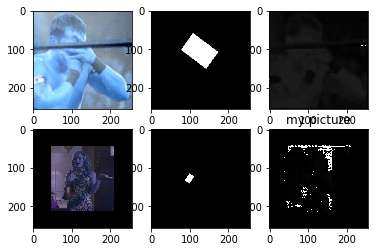

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2111
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2112
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2113
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2114
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2115
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2116
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2117
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2118
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2119
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2120
(2, 256, 256, 1)


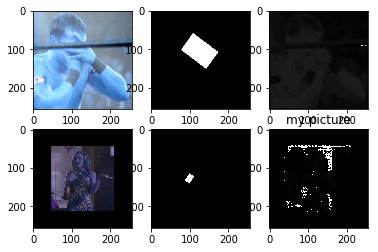

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2121
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2122
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2123
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2124
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2125
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2126
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2127
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2128
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2129
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2130
(2, 256, 256, 1)


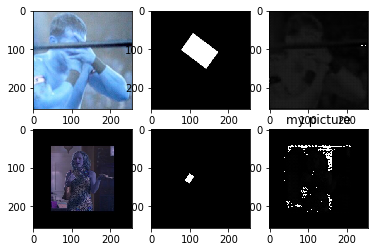

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2131
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2132
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2133
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2134
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2135
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2136
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2137
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2138
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2139
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2140
(2, 256, 256, 1)


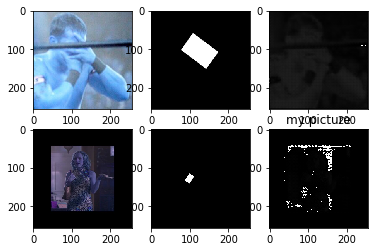

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2141
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2142
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2143
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2144
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
2145
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2146
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2147
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2148
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2149
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2150
(2, 256, 256, 1)


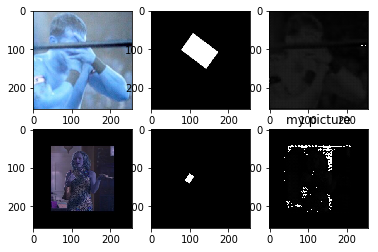

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2151
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2152
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2153
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2154
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2155
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2156
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2157
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2158
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2159
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2160
(2, 256, 256, 1)


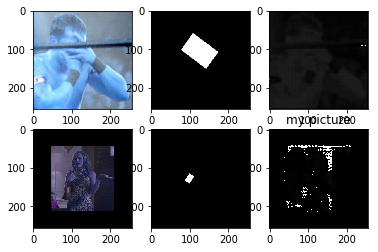

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2161
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2162
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2163
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2164
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2165
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2166
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2167
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2168
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2169
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2170
(2, 256, 256, 1)


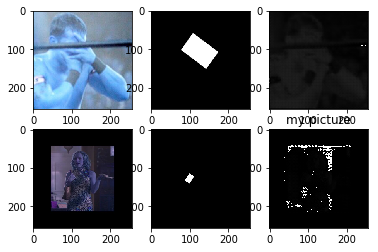

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2171
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2172
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2173
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2174
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2175
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2176
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2177
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2178
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2179
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2180
(2, 256, 256, 1)


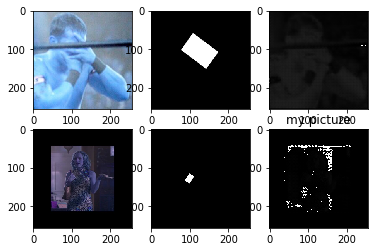

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2181
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2182
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2183
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2184
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2185
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2186
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2187
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2188
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2189
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2190
(2, 256, 256, 1)


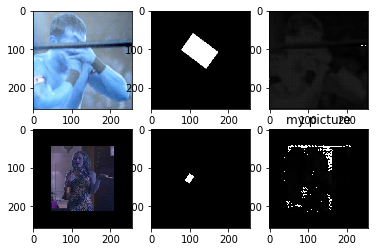

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2191
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2192
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2193
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2194
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
2195
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2196
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2197
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2198
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2199
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2200
(2, 256, 256, 1)


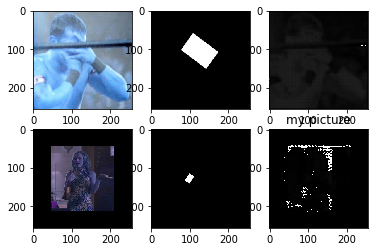

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2201
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2202
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2203
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2204
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2205
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2206
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2207
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2208
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2209
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2210
(2, 256, 256, 1)


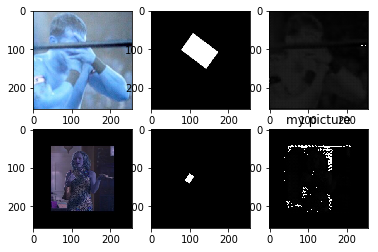

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2211
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2212
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2213
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2214
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2215
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2216
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2217
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2218
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2219
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2220
(2, 256, 256, 1)


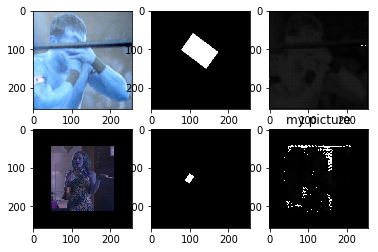

10/10 [==============================] - 0s 17ms/sample - loss: 0.0106
2221
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2222
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2223
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2224
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2225
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2226
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2227
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2228
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2229
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2230
(2, 256, 256, 1)


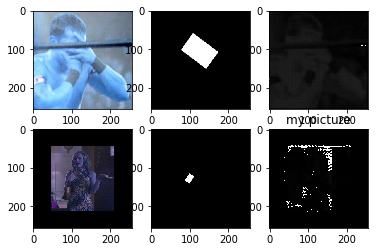

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2231
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2232
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2233
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2234
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2235
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2236
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2237
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2238
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2239
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2240
(2, 256, 256, 1)


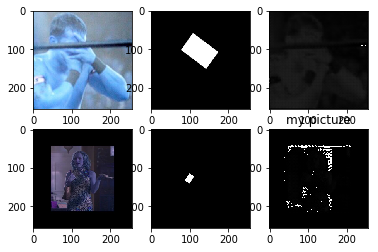

10/10 [==============================] - 0s 17ms/sample - loss: 0.0106
2241
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2242
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2243
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2244
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2245
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2246
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2247
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2248
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2249
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2250
(2, 256, 256, 1)


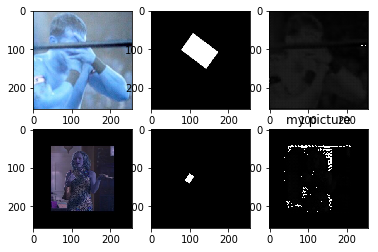

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2251
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2252
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2253
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2254
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2255
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2256
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2257
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2258
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2259
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2260
(2, 256, 256, 1)


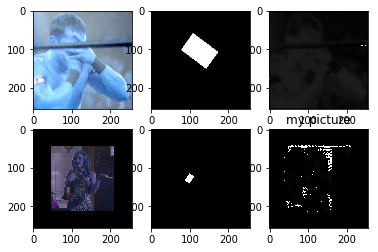

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2261
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2262
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2263
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2264
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2265
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2266
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2267
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2268
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2269
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2270
(2, 256, 256, 1)


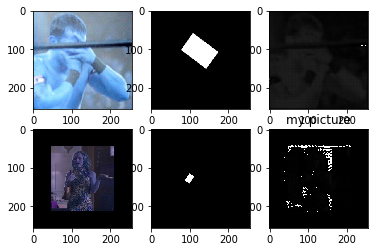

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2271
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2272
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2273
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2274
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2275
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2276
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2277
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2278
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2279
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2280
(2, 256, 256, 1)


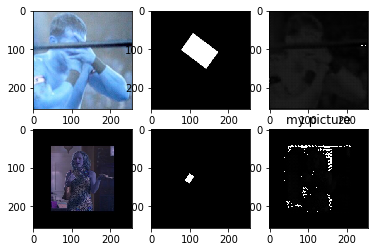

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2281
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2282
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2283
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2284
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2285
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2286
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2287
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2288
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2289
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2290
(2, 256, 256, 1)


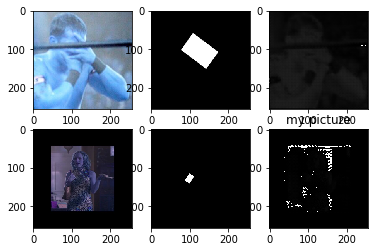

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2291
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2292
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2293
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2294
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2295
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2296
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2297
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2298
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2299
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2300
(2, 256, 256, 1)


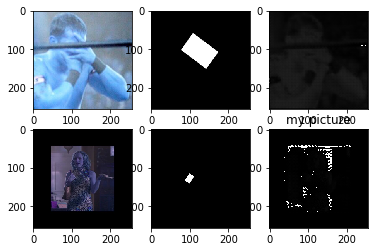

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2301
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2302
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2303
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2304
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2305
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2306
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2307
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2308
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2309
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2310
(2, 256, 256, 1)


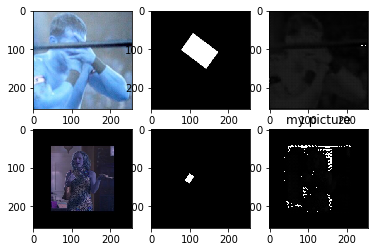

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2311
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2312
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2313
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2314
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2315
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2316
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2317
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2318
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2319
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2320
(2, 256, 256, 1)


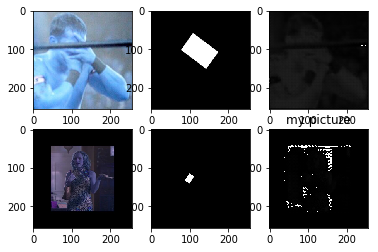

10/10 [==============================] - 0s 17ms/sample - loss: 0.0106
2321
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2322
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2323
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2324
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2325
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2326
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2327
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2328
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2329
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2330
(2, 256, 256, 1)


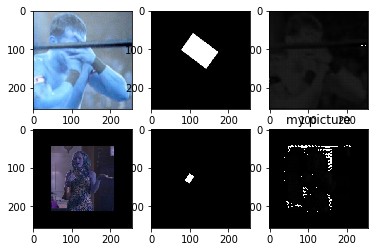

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2331
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2332
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2333
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2334
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
2335
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2336
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2337
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2338
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2339
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2340
(2, 256, 256, 1)


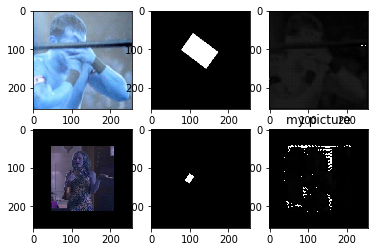

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2341
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2342
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2343
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2344
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2345
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2346
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2347
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2348
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2349
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2350
(2, 256, 256, 1)


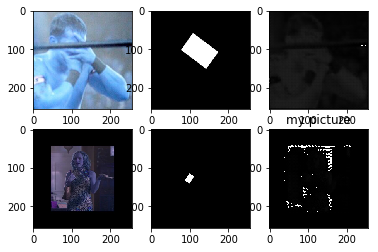

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2351
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2352
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2353
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2354
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
2355
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2356
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2357
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2358
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2359
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2360
(2, 256, 256, 1)


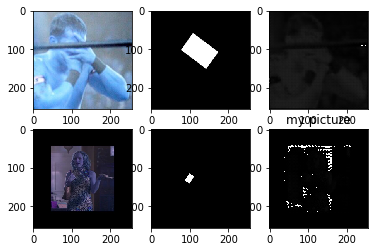

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2361
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2362
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2363
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2364
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2365
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2366
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2367
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2368
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2369
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2370
(2, 256, 256, 1)


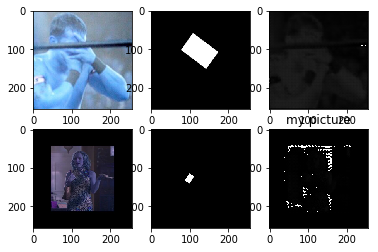

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2371
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2372
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2373
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2374
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2375
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2376
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2377
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2378
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2379
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2380
(2, 256, 256, 1)


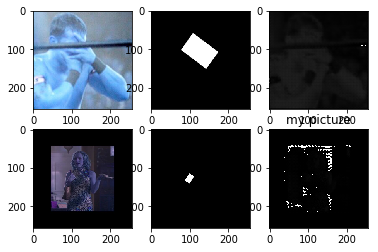

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2381
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2382
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2383
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2384
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2385
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2386
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2387
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2388
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2389
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2390
(2, 256, 256, 1)


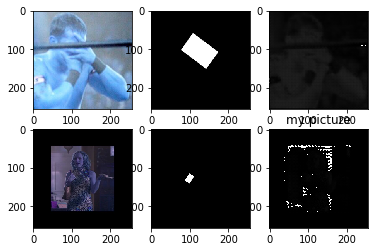

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2391
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2392
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2393
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2394
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2395
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2396
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2397
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2398
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2399
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2400
(2, 256, 256, 1)


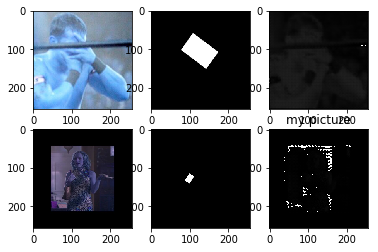

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2401
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2402
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2403
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2404
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2405
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2406
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2407
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2408
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2409
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2410
(2, 256, 256, 1)


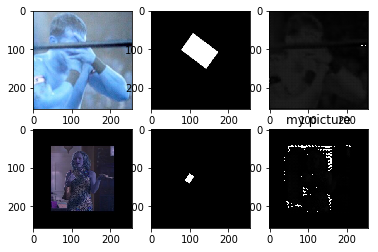

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2411
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2412
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2413
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2414
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2415
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2416
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2417
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2418
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2419
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2420
(2, 256, 256, 1)


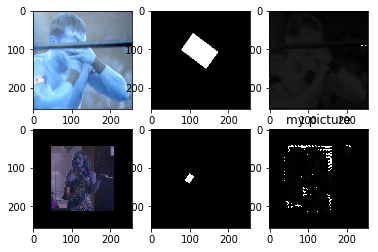

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2421
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2422
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2423
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2424
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2425
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2426
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2427
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2428
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2429
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2430
(2, 256, 256, 1)


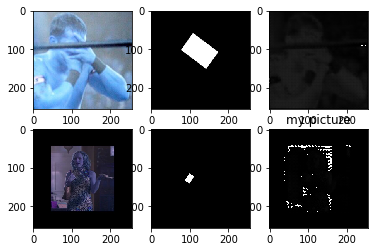

10/10 [==============================] - 0s 17ms/sample - loss: 0.0106
2431
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2432
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2433
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2434
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2435
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2436
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2437
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2438
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2439
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2440
(2, 256, 256, 1)


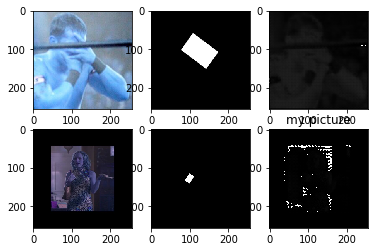

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2441
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2442
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2443
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2444
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2445
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2446
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2447
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2448
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2449
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2450
(2, 256, 256, 1)


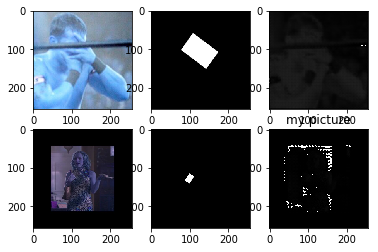

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2451
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2452
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2453
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2454
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
2455
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2456
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2457
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2458
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2459
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2460
(2, 256, 256, 1)


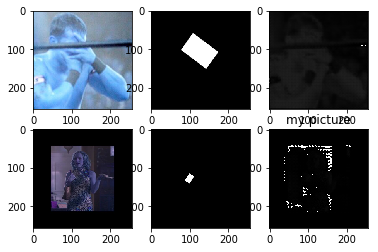

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2461
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2462
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2463
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2464
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
2465
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2466
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2467
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2468
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2469
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2470
(2, 256, 256, 1)


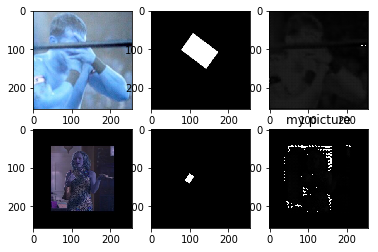

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2471
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2472
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2473
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2474
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2475
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2476
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2477
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2478
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2479
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2480
(2, 256, 256, 1)


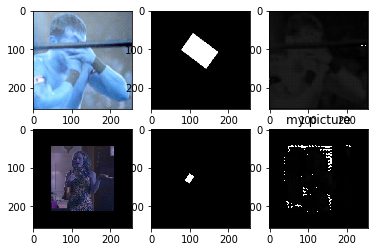

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2481
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2482
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2483
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2484
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2485
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2486
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2487
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2488
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2489
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2490
(2, 256, 256, 1)


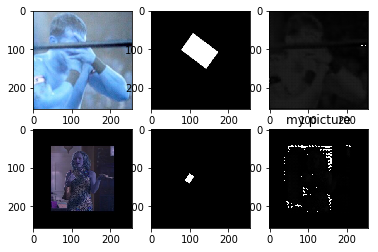

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2491
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2492
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2493
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2494
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2495
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2496
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2497
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2498
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2499
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2500
(2, 256, 256, 1)


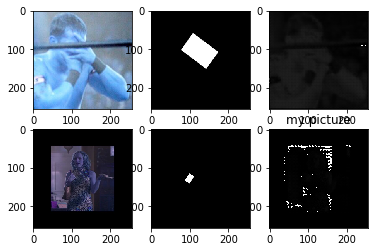

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2501
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2502
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2503
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2504
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2505
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2506
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2507
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2508
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2509
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2510
(2, 256, 256, 1)


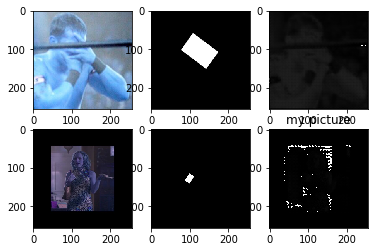

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2511
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2512
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2513
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2514
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2515
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2516
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2517
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2518
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2519
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2520
(2, 256, 256, 1)


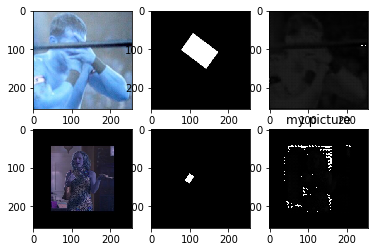

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2521
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2522
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2523
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2524
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
2525
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2526
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2527
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2528
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2529
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2530
(2, 256, 256, 1)


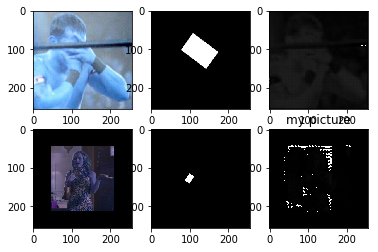

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2531
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2532
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2533
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2534
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2535
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2536
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2537
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2538
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2539
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2540
(2, 256, 256, 1)


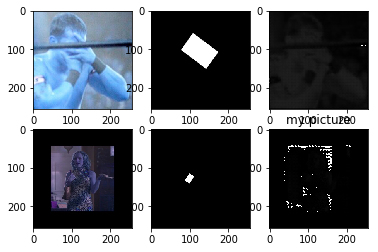

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2541
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2542
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2543
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2544
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2545
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2546
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2547
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2548
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2549
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2550
(2, 256, 256, 1)


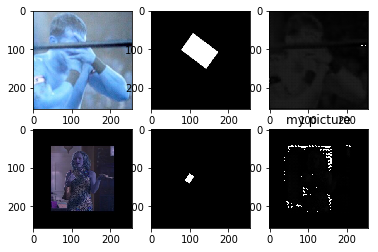

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2551
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2552
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2553
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2554
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2555
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2556
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2557
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2558
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2559
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2560
(2, 256, 256, 1)


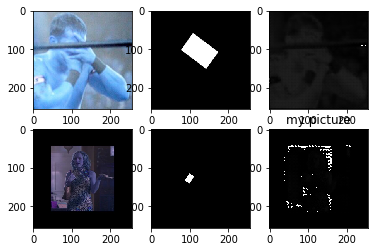

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2561
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2562
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2563
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2564
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2565
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2566
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2567
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2568
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2569
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2570
(2, 256, 256, 1)


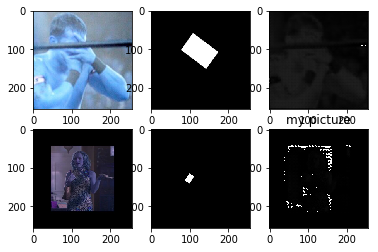

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2571
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2572
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2573
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2574
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2575
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2576
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2577
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2578
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2579
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2580
(2, 256, 256, 1)


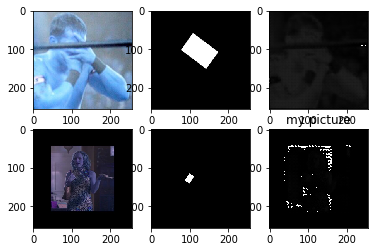

10/10 [==============================] - 0s 17ms/sample - loss: 0.0106
2581
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2582
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2583
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2584
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2585
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2586
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2587
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2588
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2589
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2590
(2, 256, 256, 1)


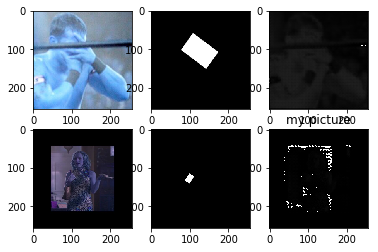

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2591
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2592
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2593
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2594
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2595
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2596
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2597
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2598
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2599
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2600
(2, 256, 256, 1)


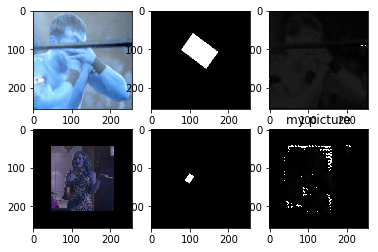

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2601
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2602
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2603
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2604
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2605
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2606
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2607
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2608
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2609
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2610
(2, 256, 256, 1)


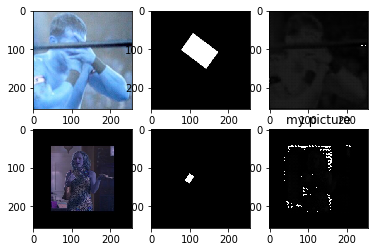

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2611
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2612
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2613
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2614
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2615
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2616
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2617
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2618
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2619
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2620
(2, 256, 256, 1)


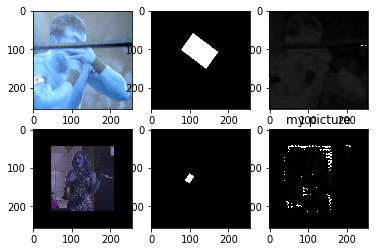

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2621
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2622
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2623
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2624
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2625
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2626
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2627
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2628
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2629
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2630
(2, 256, 256, 1)


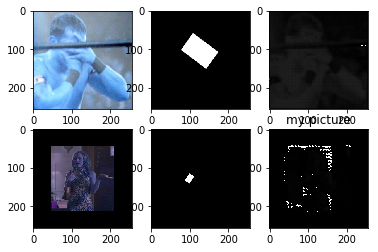

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2631
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2632
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2633
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2634
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2635
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2636
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2637
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2638
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2639
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2640
(2, 256, 256, 1)


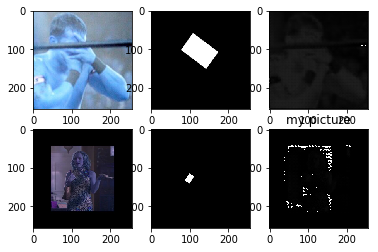

10/10 [==============================] - 0s 17ms/sample - loss: 0.0106
2641
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2642
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2643
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2644
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2645
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2646
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2647
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2648
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2649
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2650
(2, 256, 256, 1)


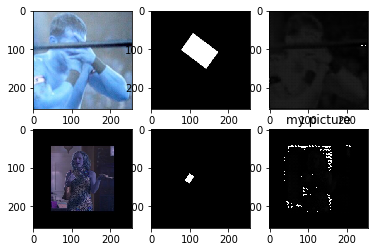

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2651
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2652
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2653
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2654
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2655
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2656
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2657
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2658
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2659
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2660
(2, 256, 256, 1)


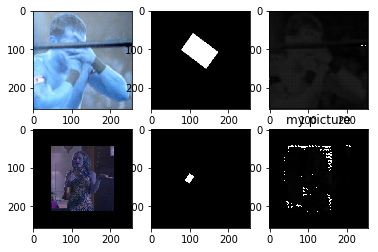

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2661
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2662
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2663
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2664
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2665
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2666
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2667
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2668
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2669
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2670
(2, 256, 256, 1)


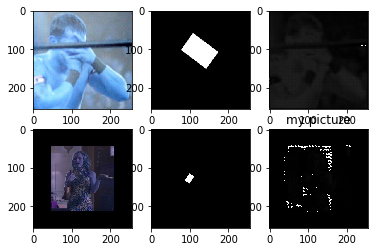

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2671
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2672
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2673
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2674
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2675
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2676
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2677
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2678
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2679
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2680
(2, 256, 256, 1)


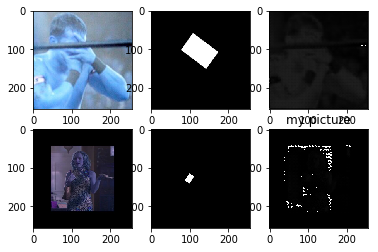

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2681
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2682
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2683
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2684
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2685
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2686
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2687
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2688
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2689
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2690
(2, 256, 256, 1)


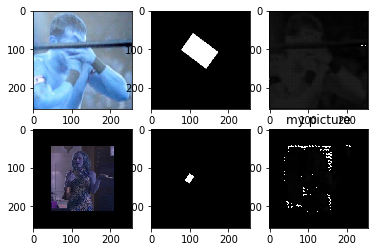

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2691
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2692
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2693
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2694
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
2695
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2696
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2697
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2698
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2699
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2700
(2, 256, 256, 1)


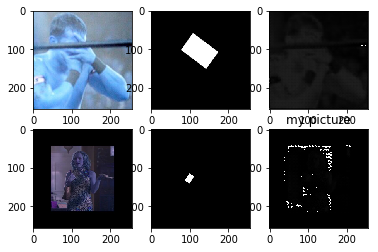

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2701
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2702
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2703
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2704
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
2705
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2706
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2707
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2708
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2709
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2710
(2, 256, 256, 1)


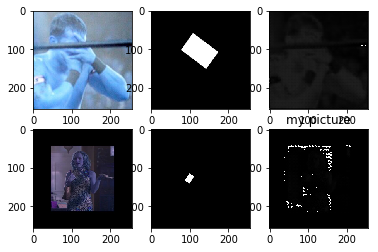

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2711
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2712
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2713
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2714
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2715
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2716
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2717
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2718
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2719
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2720
(2, 256, 256, 1)


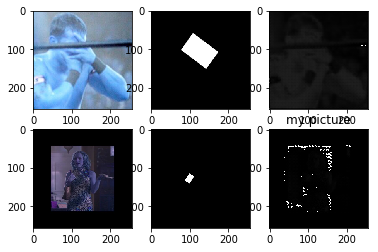

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2721
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2722
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2723
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2724
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2725
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2726
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2727
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2728
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2729
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2730
(2, 256, 256, 1)


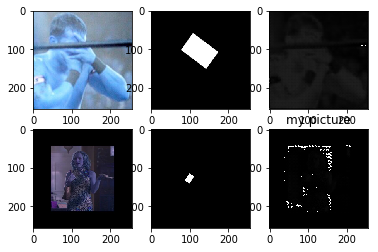

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2731
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2732
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2733
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2734
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2735
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2736
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2737
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2738
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2739
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2740
(2, 256, 256, 1)


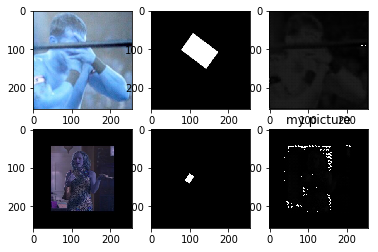

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2741
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2742
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2743
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2744
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
2745
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2746
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2747
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2748
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2749
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2750
(2, 256, 256, 1)


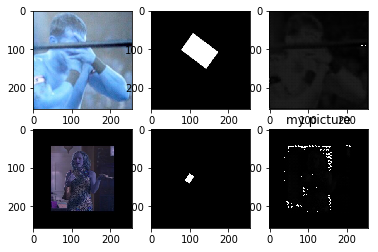

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2751
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2752
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2753
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2754
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2755
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2756
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2757
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2758
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2759
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2760
(2, 256, 256, 1)


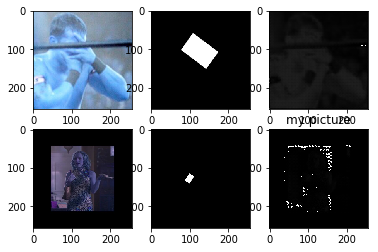

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2761
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2762
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2763
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2764
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2765
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2766
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2767
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2768
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2769
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2770
(2, 256, 256, 1)


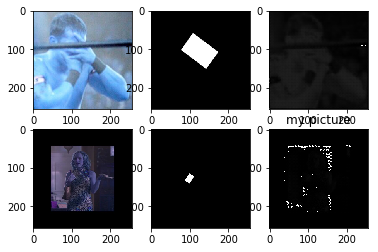

10/10 [==============================] - 0s 17ms/sample - loss: 0.0106
2771
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2772
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2773
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2774
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2775
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2776
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2777
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2778
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2779
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2780
(2, 256, 256, 1)


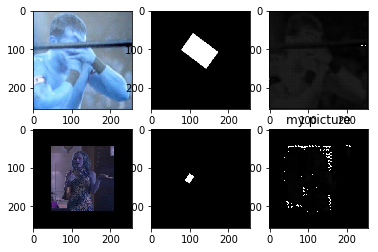

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2781
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2782
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2783
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2784
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
2785
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2786
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2787
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2788
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2789
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2790
(2, 256, 256, 1)


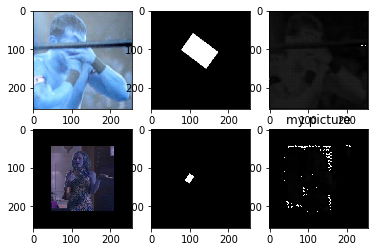

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2791
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2792
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2793
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2794
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2795
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2796
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2797
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2798
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2799
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2800
(2, 256, 256, 1)


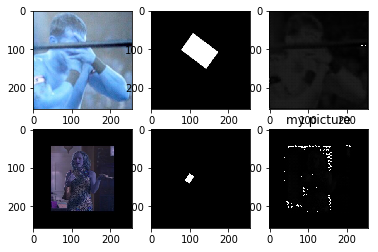

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2801
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2802
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2803
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2804
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
2805
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2806
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2807
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2808
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2809
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2810
(2, 256, 256, 1)


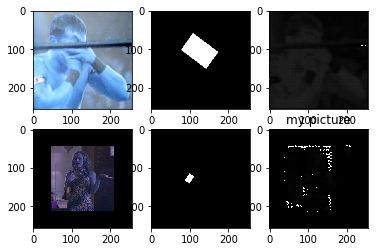

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2811
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2812
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2813
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2814
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
2815
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2816
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2817
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2818
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2819
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2820
(2, 256, 256, 1)


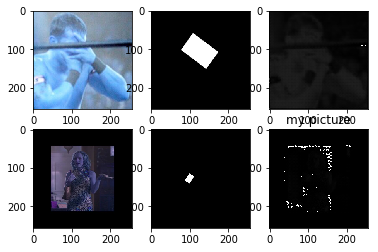

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2821
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2822
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2823
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2824
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2825
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2826
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2827
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2828
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2829
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2830
(2, 256, 256, 1)


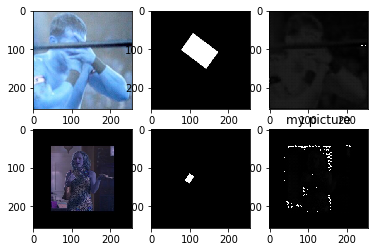

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2831
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2832
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2833
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2834
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
2835
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2836
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2837
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2838
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2839
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2840
(2, 256, 256, 1)


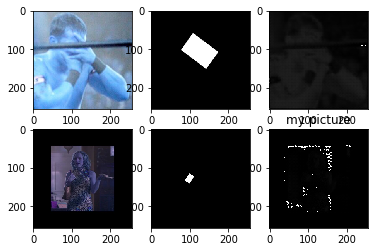

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2841
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2842
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2843
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2844
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2845
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2846
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2847
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2848
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2849
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2850
(2, 256, 256, 1)


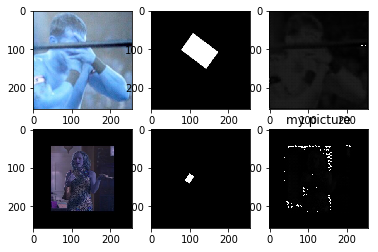

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2851
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2852
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2853
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2854
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2855
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2856
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2857
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2858
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2859
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2860
(2, 256, 256, 1)


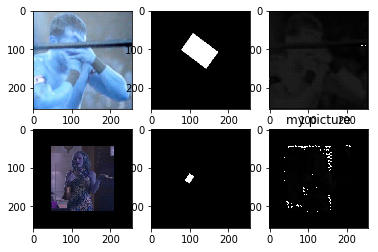

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2861
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2862
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2863
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2864
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
2865
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2866
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2867
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2868
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2869
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2870
(2, 256, 256, 1)


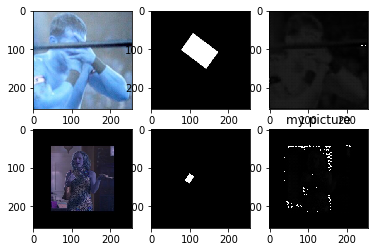

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2871
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2872
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2873
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2874
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2875
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2876
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2877
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2878
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2879
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2880
(2, 256, 256, 1)


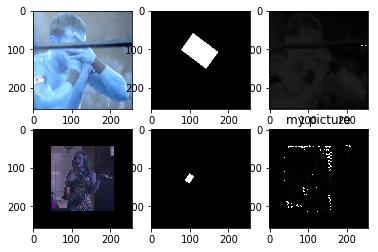

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2881
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2882
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2883
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2884
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2885
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2886
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2887
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2888
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2889
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2890
(2, 256, 256, 1)


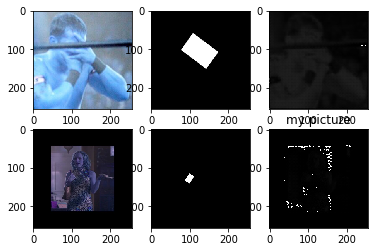

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2891
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2892
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2893
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2894
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2895
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2896
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2897
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2898
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2899
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2900
(2, 256, 256, 1)


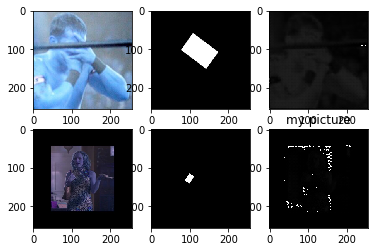

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2901
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2902
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2903
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2904
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
2905
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2906
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2907
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2908
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2909
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2910
(2, 256, 256, 1)


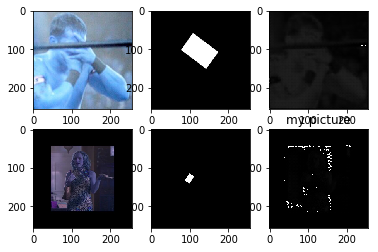

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2911
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2912
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2913
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2914
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2915
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2916
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2917
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2918
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2919
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2920
(2, 256, 256, 1)


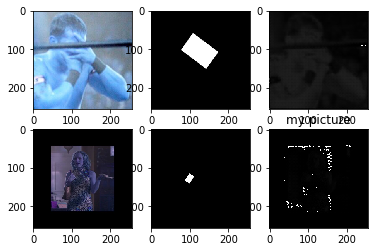

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2921
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2922
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2923
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2924
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2925
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2926
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2927
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2928
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2929
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2930
(2, 256, 256, 1)


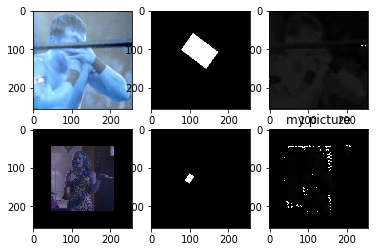

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2931
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2932
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2933
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2934
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2935
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2936
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2937
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2938
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2939
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2940
(2, 256, 256, 1)


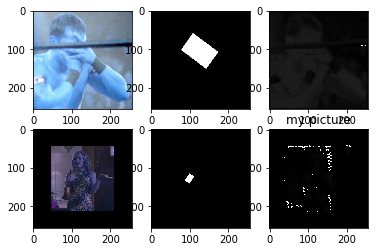

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2941
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2942
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2943
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2944
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2945
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2946
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2947
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2948
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2949
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2950
(2, 256, 256, 1)


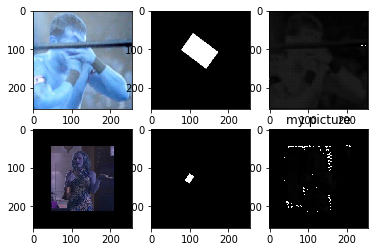

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2951
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2952
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2953
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2954
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2955
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2956
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2957
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2958
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2959
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2960
(2, 256, 256, 1)


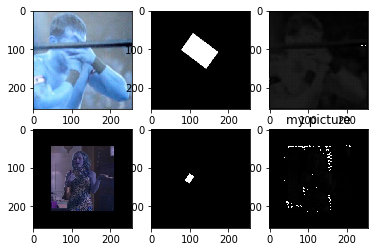

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2961
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2962
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2963
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2964
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2965
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2966
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2967
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2968
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2969
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2970
(2, 256, 256, 1)


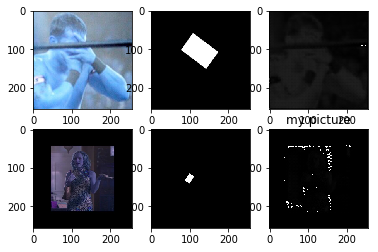

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2971
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2972
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2973
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2974
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2975
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2976
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2977
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2978
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2979
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2980
(2, 256, 256, 1)


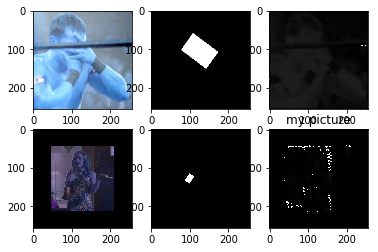

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2981
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2982
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2983
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2984
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
2985
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2986
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2987
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2988
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2989
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
2990
(2, 256, 256, 1)


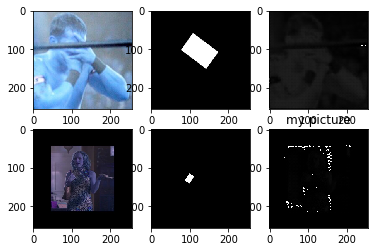

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2991
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2992
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2993
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2994
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
2995
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2996
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2997
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2998
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
2999
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3000
(2, 256, 256, 1)


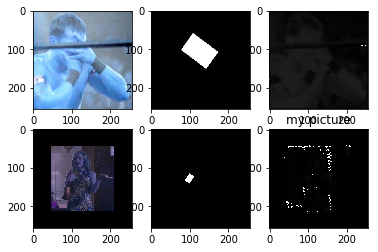

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3001
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3002
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3003
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3004
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3005
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3006
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3007
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3008
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3009
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3010
(2, 256, 256, 1)


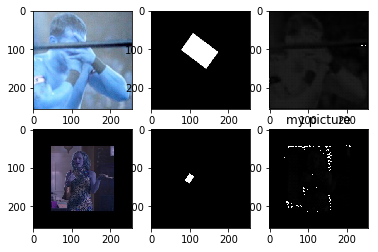

10/10 [==============================] - 0s 17ms/sample - loss: 0.0106
3011
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3012
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3013
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3014
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3015
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3016
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3017
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3018
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3019
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3020
(2, 256, 256, 1)


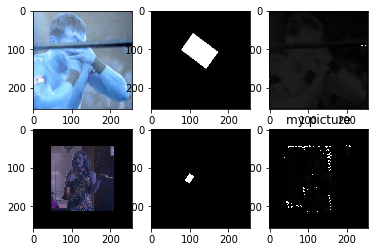

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3021
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3022
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3023
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3024
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
3025
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3026
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3027
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3028
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3029
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3030
(2, 256, 256, 1)


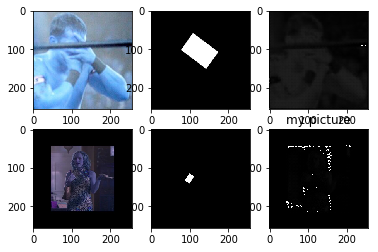

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3031
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3032
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3033
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3034
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
3035
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3036
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3037
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3038
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3039
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3040
(2, 256, 256, 1)


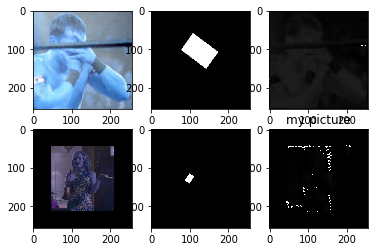

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3041
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3042
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3043
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3044
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3045
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3046
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3047
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3048
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3049
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3050
(2, 256, 256, 1)


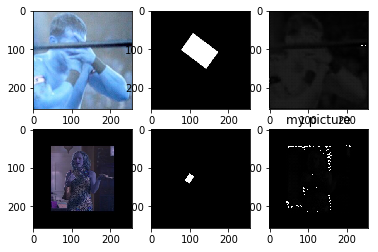

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3051
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3052
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3053
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3054
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3055
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3056
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3057
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3058
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3059
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3060
(2, 256, 256, 1)


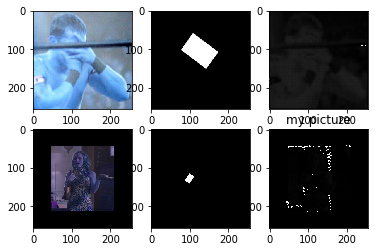

10/10 [==============================] - 0s 17ms/sample - loss: 0.0106
3061
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3062
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3063
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3064
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3065
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3066
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3067
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3068
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3069
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3070
(2, 256, 256, 1)


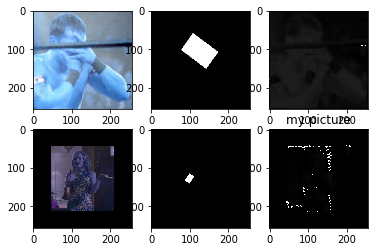

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3071
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3072
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3073
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3074
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3075
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3076
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3077
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3078
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3079
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3080
(2, 256, 256, 1)


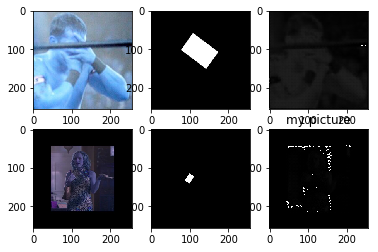

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3081
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3082
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3083
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3084
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3085
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3086
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3087
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3088
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3089
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3090
(2, 256, 256, 1)


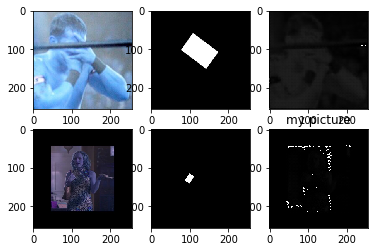

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3091
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3092
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3093
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3094
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3095
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3096
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3097
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3098
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3099
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3100
(2, 256, 256, 1)


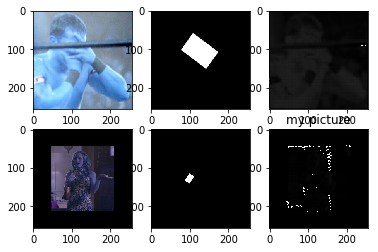

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3101
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3102
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3103
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3104
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3105
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3106
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3107
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3108
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3109
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3110
(2, 256, 256, 1)


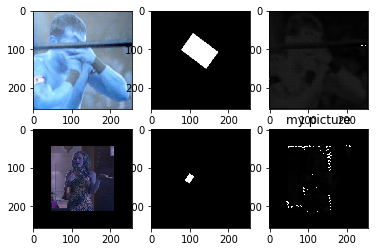

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3111
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3112
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3113
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3114
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3115
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3116
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3117
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3118
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3119
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3120
(2, 256, 256, 1)


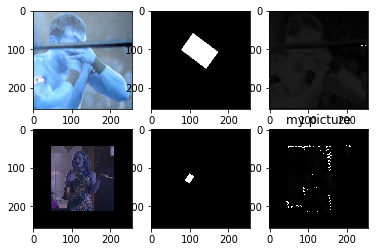

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3121
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3122
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3123
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3124
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3125
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3126
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3127
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3128
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3129
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3130
(2, 256, 256, 1)


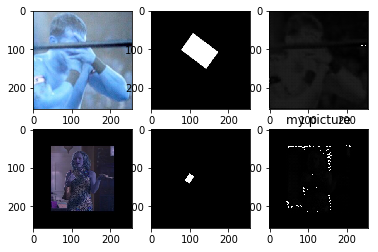

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3131
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3132
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3133
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3134
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
3135
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3136
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3137
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3138
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3139
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3140
(2, 256, 256, 1)


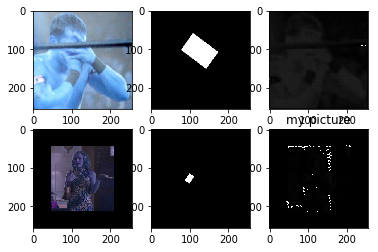

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3141
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3142
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3143
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3144
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3145
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3146
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3147
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3148
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3149
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3150
(2, 256, 256, 1)


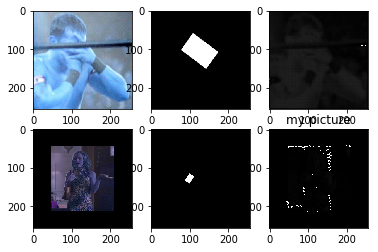

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3151
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3152
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3153
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3154
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3155
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3156
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3157
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3158
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3159
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3160
(2, 256, 256, 1)


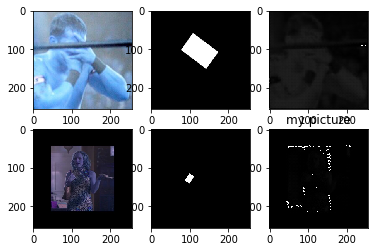

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3161
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3162
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3163
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3164
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3165
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3166
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3167
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3168
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3169
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3170
(2, 256, 256, 1)


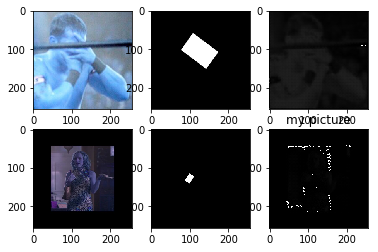

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3171
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3172
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3173
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3174
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3175
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3176
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3177
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3178
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3179
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3180
(2, 256, 256, 1)


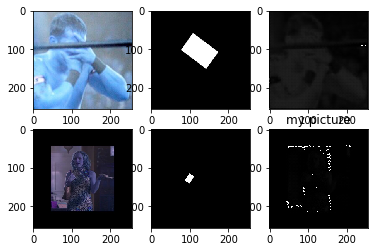

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3181
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3182
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3183
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3184
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3185
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3186
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3187
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3188
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3189
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3190
(2, 256, 256, 1)


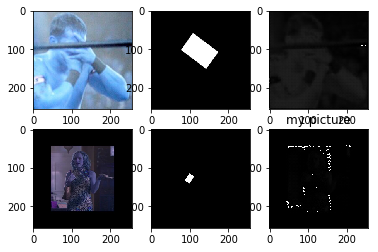

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3191
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3192
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3193
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3194
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3195
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3196
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3197
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3198
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3199
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3200
(2, 256, 256, 1)


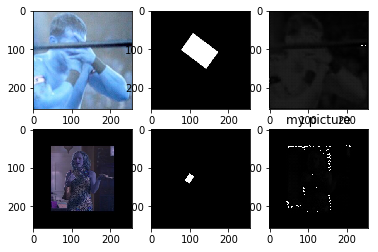

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3201
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3202
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3203
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3204
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3205
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3206
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3207
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3208
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3209
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3210
(2, 256, 256, 1)


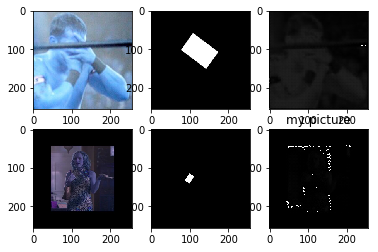

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3211
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3212
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3213
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3214
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3215
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3216
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3217
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3218
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3219
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3220
(2, 256, 256, 1)


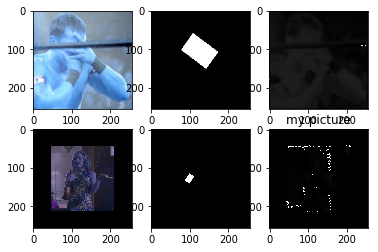

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3221
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3222
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3223
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3224
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3225
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3226
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3227
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3228
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3229
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3230
(2, 256, 256, 1)


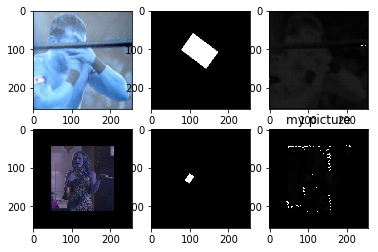

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3231
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3232
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3233
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3234
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3235
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3236
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3237
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3238
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3239
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3240
(2, 256, 256, 1)


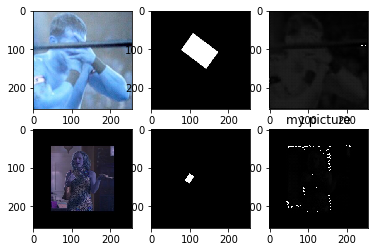

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3241
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3242
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3243
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3244
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
3245
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3246
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3247
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3248
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3249
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3250
(2, 256, 256, 1)


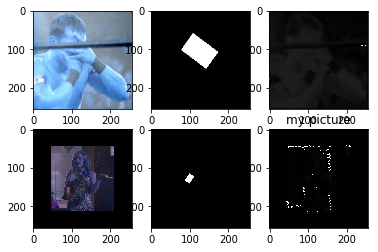

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3251
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3252
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3253
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3254
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3255
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3256
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3257
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3258
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3259
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3260
(2, 256, 256, 1)


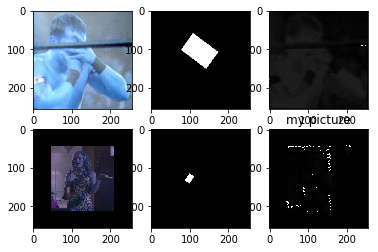

10/10 [==============================] - 0s 17ms/sample - loss: 0.0106
3261
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3262
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3263
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3264
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3265
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3266
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3267
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3268
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3269
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3270
(2, 256, 256, 1)


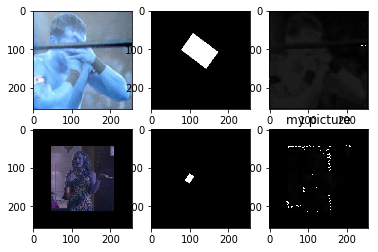

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3271
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3272
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3273
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3274
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3275
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3276
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3277
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3278
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3279
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3280
(2, 256, 256, 1)


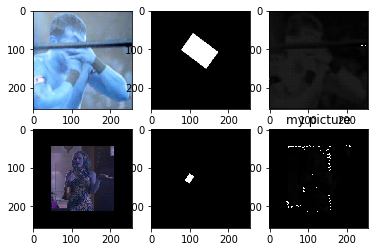

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3281
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3282
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3283
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3284
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3285
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3286
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3287
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3288
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3289
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3290
(2, 256, 256, 1)


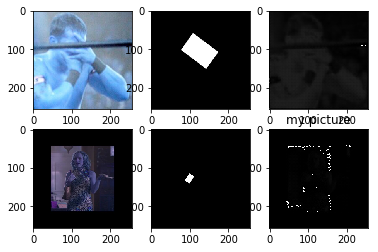

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3291
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3292
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3293
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3294
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3295
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3296
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3297
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3298
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3299
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3300
(2, 256, 256, 1)


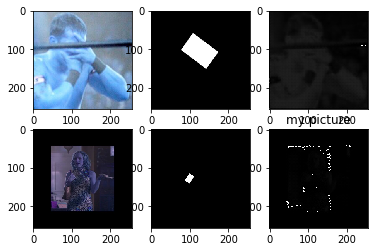

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3301
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3302
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3303
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3304
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3305
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3306
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3307
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3308
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3309
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3310
(2, 256, 256, 1)


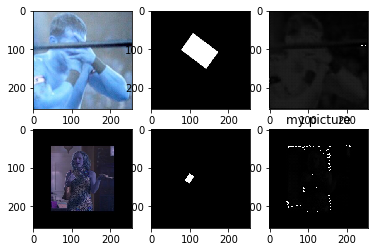

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3311
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3312
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3313
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3314
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3315
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3316
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3317
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3318
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3319
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3320
(2, 256, 256, 1)


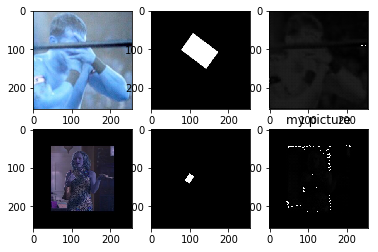

10/10 [==============================] - 0s 17ms/sample - loss: 0.0106
3321
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3322
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3323
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3324
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3325
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3326
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3327
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3328
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3329
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3330
(2, 256, 256, 1)


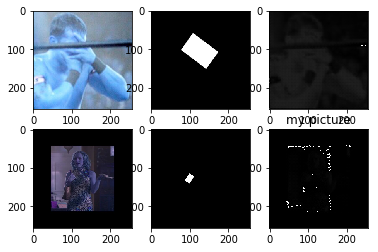

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3331
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3332
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3333
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3334
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3335
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3336
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3337
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3338
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3339
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3340
(2, 256, 256, 1)


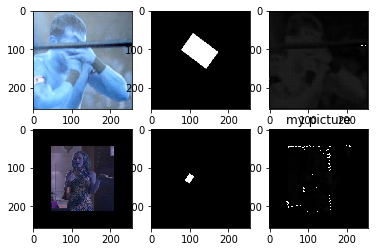

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3341
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3342
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3343
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3344
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3345
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3346
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3347
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3348
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3349
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3350
(2, 256, 256, 1)


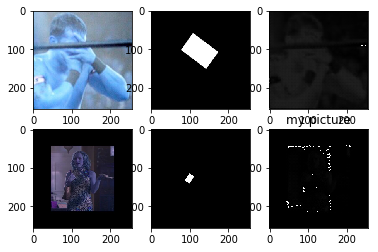

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3351
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3352
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3353
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3354
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3355
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3356
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3357
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3358
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3359
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3360
(2, 256, 256, 1)


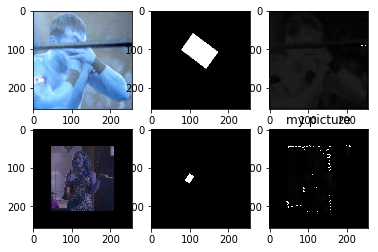

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3361
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3362
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3363
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3364
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3365
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3366
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3367
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3368
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3369
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3370
(2, 256, 256, 1)


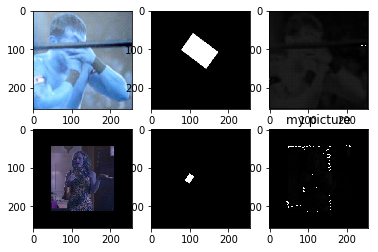

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3371
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3372
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3373
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3374
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3375
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3376
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3377
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3378
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3379
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3380
(2, 256, 256, 1)


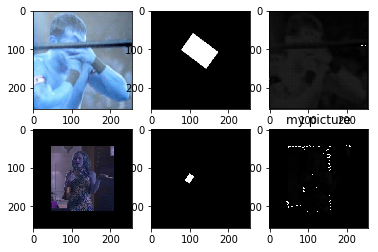

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3381
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3382
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3383
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3384
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3385
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3386
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3387
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3388
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3389
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3390
(2, 256, 256, 1)


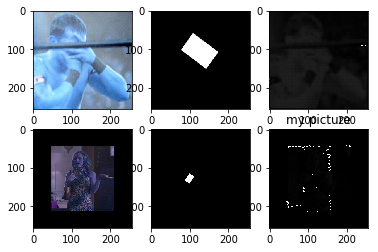

10/10 [==============================] - 0s 17ms/sample - loss: 0.0106
3391
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3392
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3393
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3394
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3395
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3396
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3397
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3398
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3399
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3400
(2, 256, 256, 1)


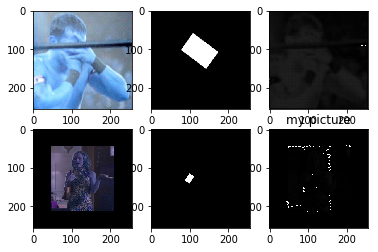

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3401
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3402
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3403
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3404
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3405
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3406
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3407
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3408
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3409
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3410
(2, 256, 256, 1)


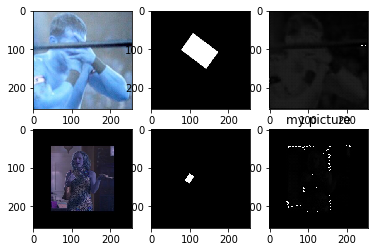

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3411
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3412
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3413
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3414
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3415
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3416
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3417
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3418
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3419
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3420
(2, 256, 256, 1)


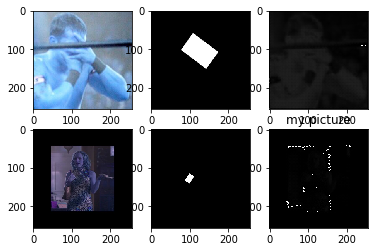

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3421
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3422
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3423
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3424
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3425
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3426
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3427
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3428
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3429
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3430
(2, 256, 256, 1)


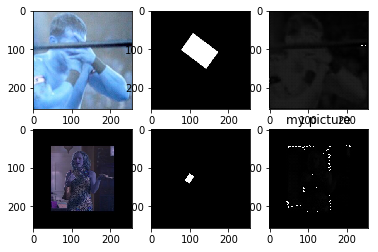

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3431
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3432
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3433
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3434
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3435
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3436
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3437
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3438
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3439
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3440
(2, 256, 256, 1)


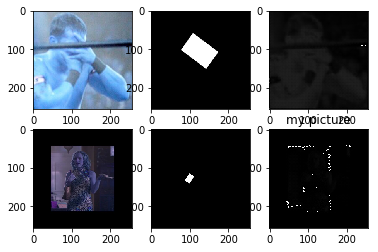

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3441
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3442
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3443
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3444
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3445
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3446
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3447
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3448
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3449
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3450
(2, 256, 256, 1)


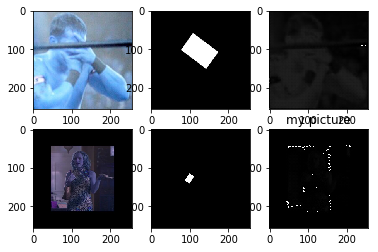

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3451
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3452
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3453
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3454
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
3455
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3456
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3457
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3458
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3459
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3460
(2, 256, 256, 1)


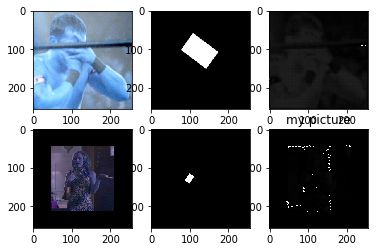

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3461
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3462
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3463
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3464
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3465
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3466
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3467
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3468
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3469
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3470
(2, 256, 256, 1)


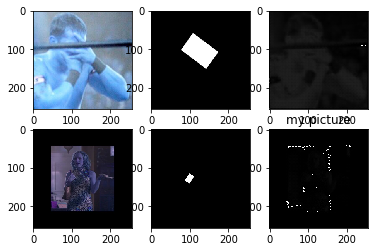

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3471
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3472
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3473
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3474
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3475
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3476
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3477
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3478
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3479
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3480
(2, 256, 256, 1)


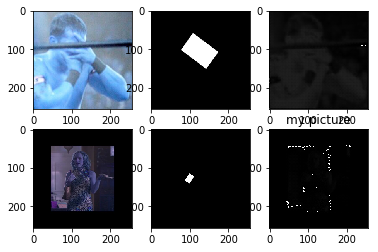

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3481
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3482
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3483
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3484
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3485
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3486
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3487
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3488
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3489
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3490
(2, 256, 256, 1)


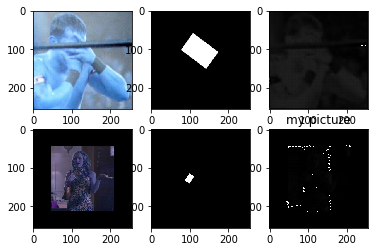

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3491
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3492
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3493
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3494
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3495
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3496
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3497
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3498
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3499
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3500
(2, 256, 256, 1)


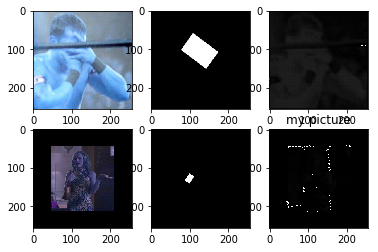

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3501
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3502
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3503
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3504
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3505
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3506
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3507
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3508
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3509
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3510
(2, 256, 256, 1)


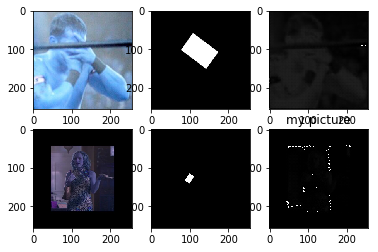

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3511
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3512
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3513
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3514
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3515
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3516
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3517
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3518
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3519
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3520
(2, 256, 256, 1)


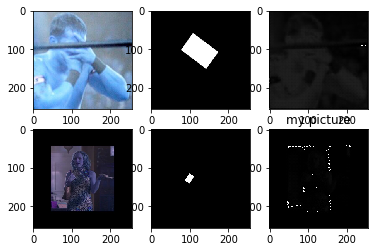

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3521
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3522
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3523
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3524
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3525
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3526
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3527
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3528
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3529
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3530
(2, 256, 256, 1)


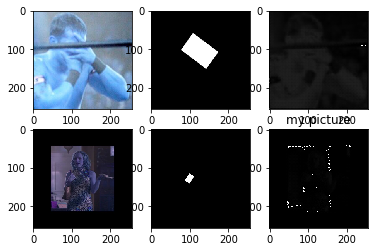

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3531
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3532
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3533
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3534
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3535
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3536
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3537
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3538
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3539
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3540
(2, 256, 256, 1)


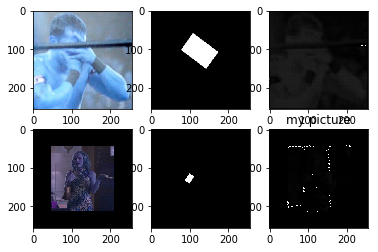

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3541
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3542
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3543
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3544
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3545
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3546
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3547
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3548
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3549
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3550
(2, 256, 256, 1)


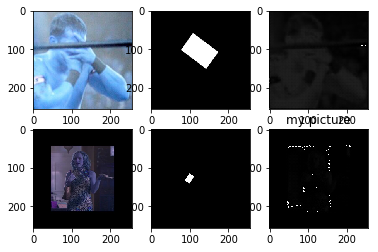

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3551
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3552
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3553
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3554
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3555
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3556
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3557
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3558
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3559
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3560
(2, 256, 256, 1)


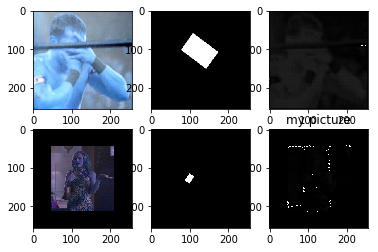

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3561
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3562
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3563
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3564
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3565
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3566
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3567
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3568
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3569
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3570
(2, 256, 256, 1)


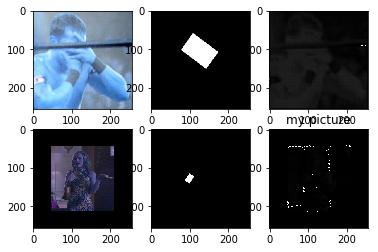

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3571
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3572
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3573
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3574
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3575
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3576
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3577
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3578
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3579
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3580
(2, 256, 256, 1)


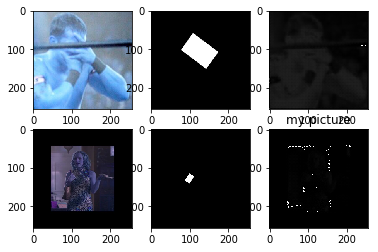

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3581
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3582
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3583
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3584
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3585
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3586
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3587
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3588
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3589
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3590
(2, 256, 256, 1)


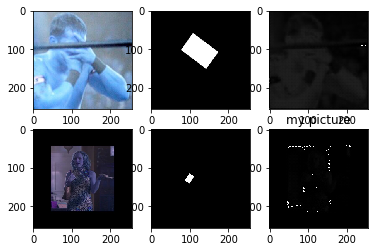

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3591
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3592
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3593
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3594
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3595
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3596
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3597
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3598
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3599
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3600
(2, 256, 256, 1)


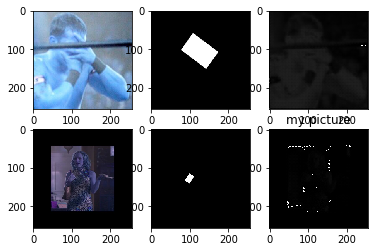

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3601
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3602
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3603
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3604
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3605
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3606
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3607
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3608
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3609
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3610
(2, 256, 256, 1)


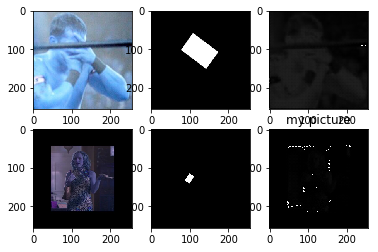

10/10 [==============================] - 0s 17ms/sample - loss: 0.0106
3611
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3612
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3613
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3614
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3615
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3616
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3617
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3618
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3619
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3620
(2, 256, 256, 1)


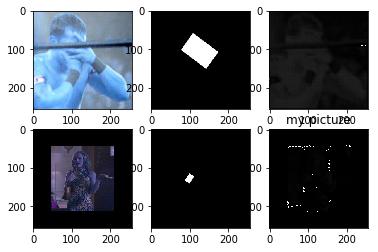

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3621
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3622
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3623
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3624
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
3625
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3626
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3627
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3628
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3629
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3630
(2, 256, 256, 1)


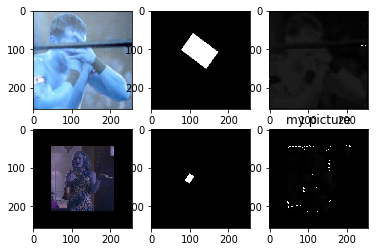

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3631
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3632
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3633
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3634
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3635
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3636
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3637
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3638
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3639
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3640
(2, 256, 256, 1)


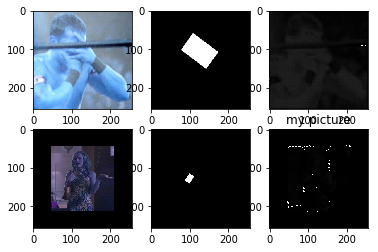

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3641
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3642
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3643
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3644
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3645
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3646
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3647
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3648
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3649
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3650
(2, 256, 256, 1)


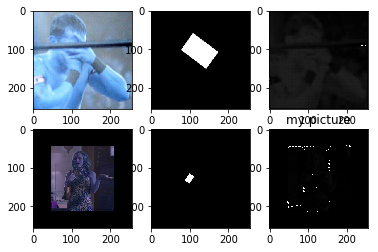

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3651
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3652
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3653
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3654
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3655
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3656
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3657
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3658
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3659
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3660
(2, 256, 256, 1)


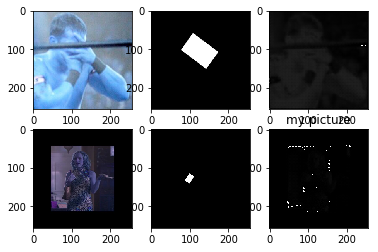

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3661
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3662
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3663
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3664
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
3665
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3666
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3667
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3668
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3669
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3670
(2, 256, 256, 1)


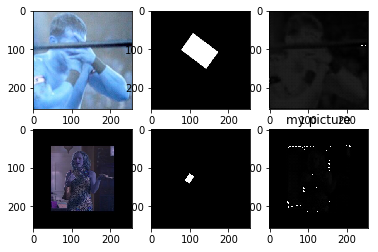

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3671
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3672
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3673
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3674
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3675
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3676
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3677
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3678
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3679
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3680
(2, 256, 256, 1)


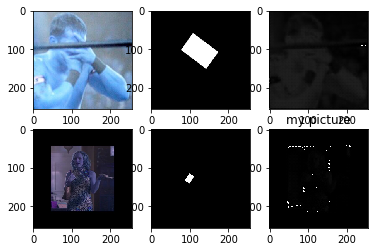

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3681
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3682
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3683
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3684
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3685
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3686
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3687
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3688
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3689
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3690
(2, 256, 256, 1)


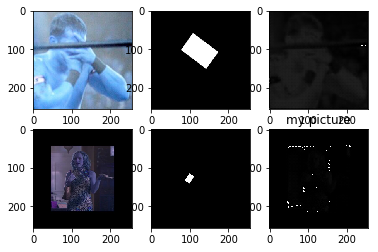

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3691
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3692
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3693
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3694
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3695
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3696
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3697
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3698
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3699
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3700
(2, 256, 256, 1)


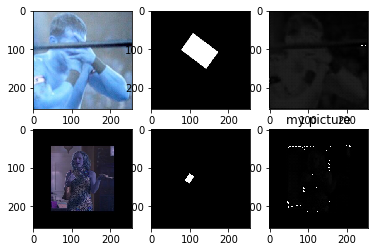

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3701
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3702
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3703
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3704
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3705
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3706
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3707
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3708
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3709
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3710
(2, 256, 256, 1)


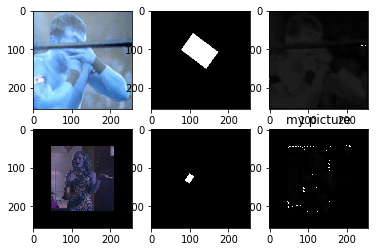

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3711
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3712
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3713
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3714
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3715
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3716
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3717
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3718
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3719
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3720
(2, 256, 256, 1)


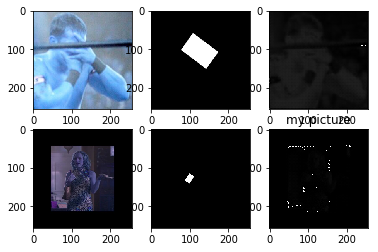

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3721
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3722
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3723
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3724
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3725
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3726
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3727
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3728
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3729
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3730
(2, 256, 256, 1)


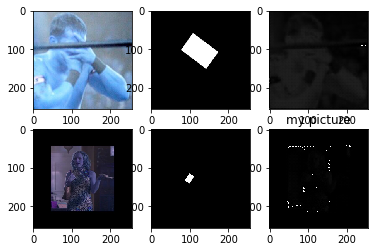

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3731
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3732
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3733
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3734
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3735
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3736
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3737
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3738
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3739
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3740
(2, 256, 256, 1)


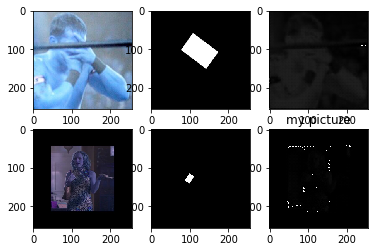

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3741
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3742
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3743
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3744
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
3745
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3746
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3747
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3748
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3749
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3750
(2, 256, 256, 1)


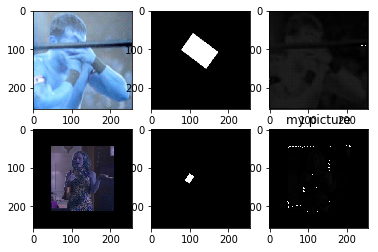

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3751
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3752
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3753
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3754
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3755
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3756
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3757
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3758
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3759
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3760
(2, 256, 256, 1)


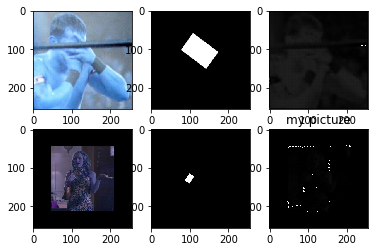

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3761
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3762
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3763
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3764
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3765
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3766
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3767
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3768
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3769
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3770
(2, 256, 256, 1)


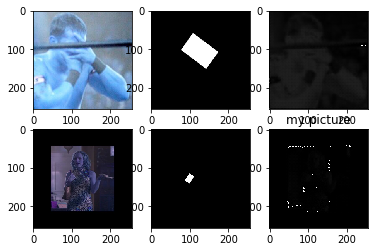

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3771
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3772
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3773
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3774
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3775
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3776
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3777
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3778
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3779
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3780
(2, 256, 256, 1)


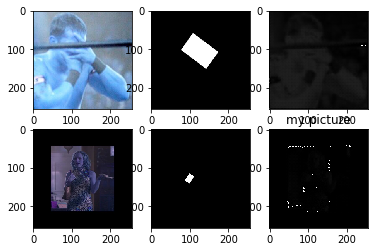

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3781
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3782
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3783
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3784
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3785
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3786
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3787
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3788
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3789
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3790
(2, 256, 256, 1)


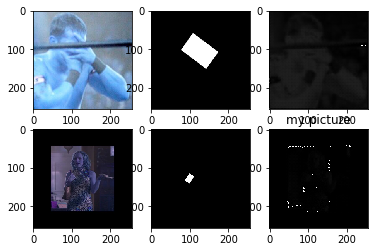

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3791
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3792
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3793
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3794
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3795
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3796
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3797
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3798
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3799
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3800
(2, 256, 256, 1)


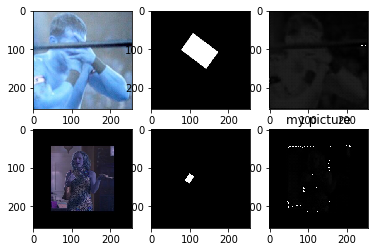

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3801
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3802
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3803
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3804
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3805
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3806
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3807
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3808
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3809
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3810
(2, 256, 256, 1)


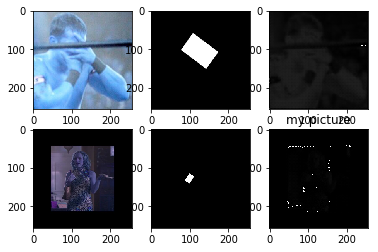

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3811
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3812
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3813
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3814
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3815
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3816
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3817
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3818
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3819
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3820
(2, 256, 256, 1)


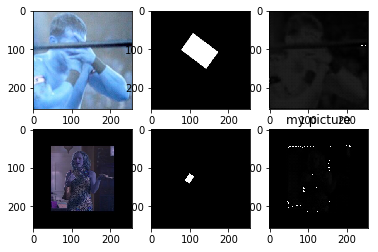

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3821
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3822
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3823
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3824
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3825
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3826
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3827
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3828
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3829
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3830
(2, 256, 256, 1)


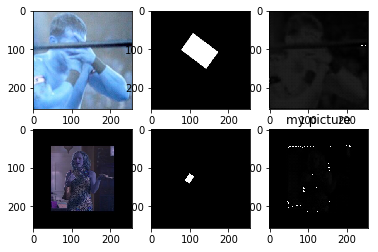

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3831
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3832
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3833
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3834
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
3835
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3836
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3837
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3838
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3839
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3840
(2, 256, 256, 1)


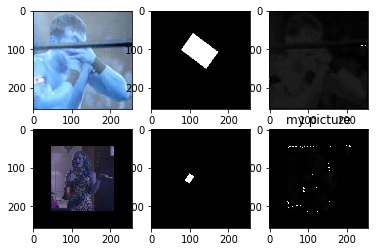

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3841
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3842
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3843
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3844
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3845
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3846
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3847
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3848
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3849
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3850
(2, 256, 256, 1)


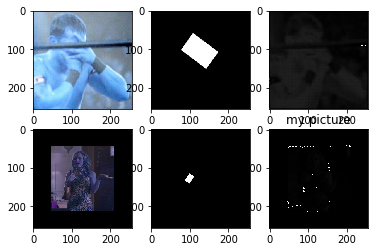

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3851
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3852
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3853
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3854
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3855
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3856
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3857
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3858
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3859
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3860
(2, 256, 256, 1)


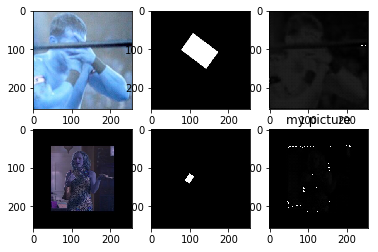

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3861
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3862
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3863
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3864
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3865
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3866
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3867
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3868
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3869
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3870
(2, 256, 256, 1)


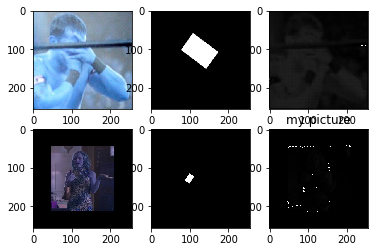

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3871
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3872
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3873
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3874
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
3875
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3876
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3877
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3878
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3879
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3880
(2, 256, 256, 1)


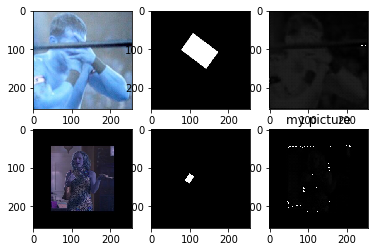

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3881
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3882
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3883
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3884
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3885
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3886
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3887
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3888
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3889
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3890
(2, 256, 256, 1)


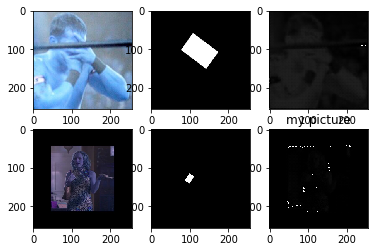

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3891
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3892
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3893
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3894
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3895
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3896
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3897
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3898
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3899
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3900
(2, 256, 256, 1)


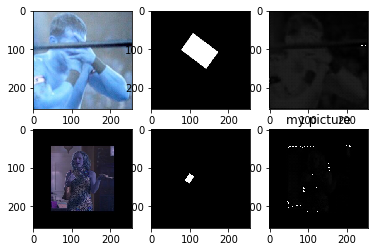

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3901
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3902
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3903
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3904
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3905
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3906
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3907
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3908
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3909
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3910
(2, 256, 256, 1)


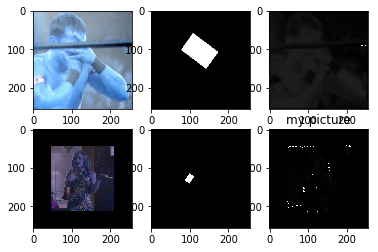

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3911
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3912
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3913
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3914
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3915
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3916
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3917
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3918
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3919
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3920
(2, 256, 256, 1)


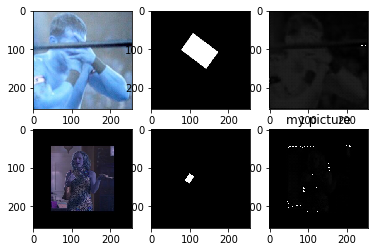

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3921
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3922
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3923
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3924
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3925
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3926
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3927
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3928
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3929
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3930
(2, 256, 256, 1)


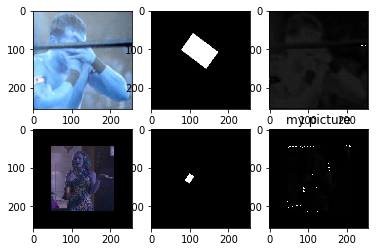

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3931
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3932
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3933
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3934
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3935
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3936
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3937
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3938
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3939
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3940
(2, 256, 256, 1)


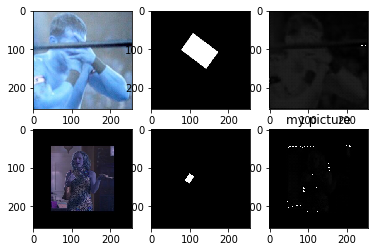

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3941
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3942
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3943
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3944
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
3945
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3946
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3947
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3948
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3949
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3950
(2, 256, 256, 1)


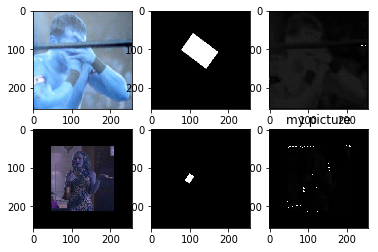

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3951
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3952
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3953
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3954
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
3955
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3956
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3957
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3958
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3959
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3960
(2, 256, 256, 1)


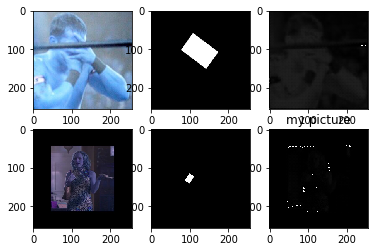

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3961
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3962
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3963
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3964
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
3965
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3966
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3967
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3968
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3969
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3970
(2, 256, 256, 1)


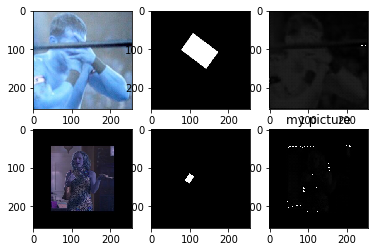

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3971
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3972
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3973
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3974
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
3975
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3976
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3977
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3978
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3979
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
3980
(2, 256, 256, 1)


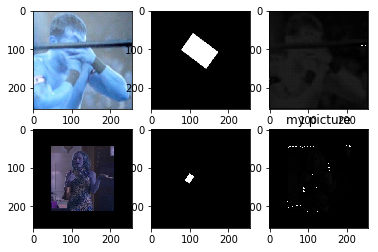

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3981
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3982
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3983
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3984
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3985
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3986
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3987
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3988
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3989
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
3990
(2, 256, 256, 1)


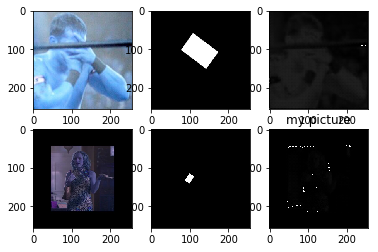

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3991
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3992
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3993
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3994
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
3995
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3996
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3997
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3998
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
3999
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4000
(2, 256, 256, 1)


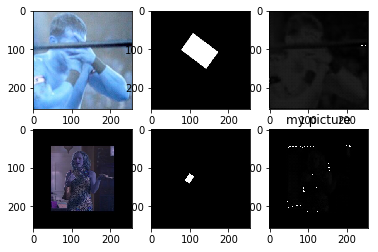

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4001
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4002
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4003
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4004
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
4005
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4006
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4007
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4008
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4009
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4010
(2, 256, 256, 1)


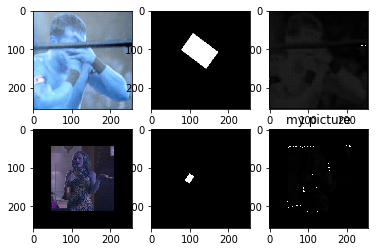

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4011
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4012
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4013
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4014
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
4015
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4016
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4017
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4018
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4019
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4020
(2, 256, 256, 1)


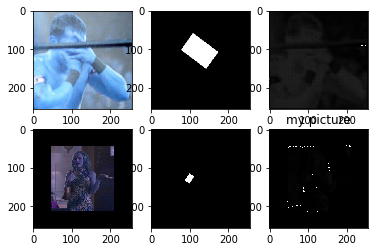

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4021
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4022
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4023
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4024
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
4025
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4026
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4027
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4028
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4029
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4030
(2, 256, 256, 1)


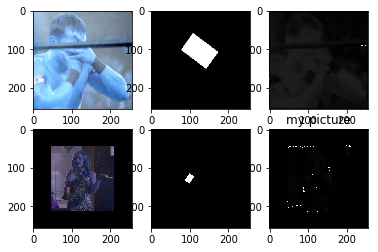

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4031
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4032
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4033
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4034
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
4035
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4036
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4037
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4038
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4039
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4040
(2, 256, 256, 1)


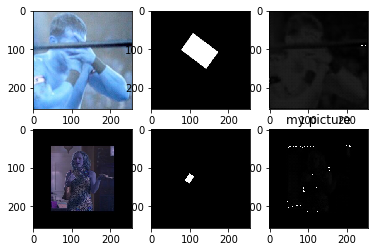

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4041
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4042
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4043
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4044
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
4045
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4046
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4047
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4048
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4049
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4050
(2, 256, 256, 1)


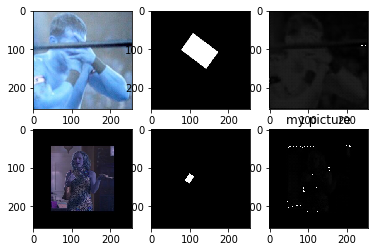

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4051
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4052
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4053
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4054
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
4055
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4056
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4057
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4058
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4059
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4060
(2, 256, 256, 1)


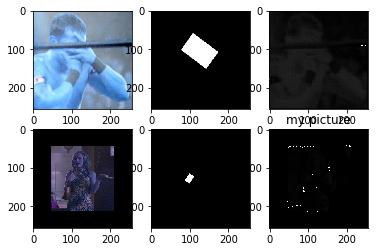

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4061
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4062
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4063
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4064
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
4065
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4066
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4067
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4068
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4069
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4070
(2, 256, 256, 1)


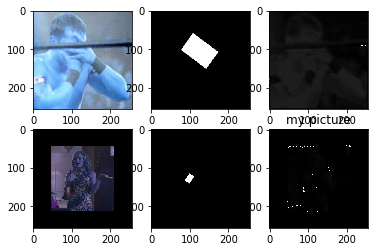

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4071
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4072
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4073
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4074
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
4075
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4076
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4077
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4078
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4079
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4080
(2, 256, 256, 1)


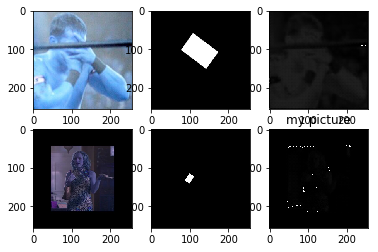

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4081
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4082
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4083
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4084
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
4085
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4086
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4087
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4088
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4089
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4090
(2, 256, 256, 1)


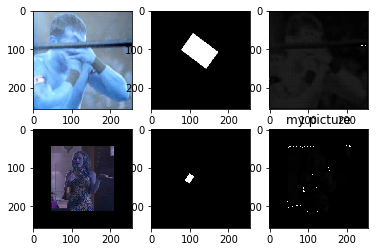

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4091
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4092
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4093
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4094
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
4095
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4096
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4097
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4098
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4099
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
4100
(2, 256, 256, 1)


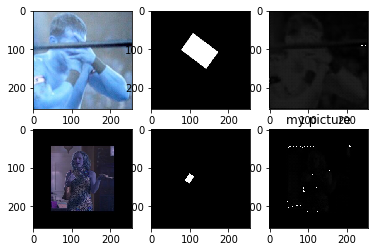

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4101
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4102
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4103
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4104
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
4105
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4106
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4107
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4108
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4109
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4110
(2, 256, 256, 1)


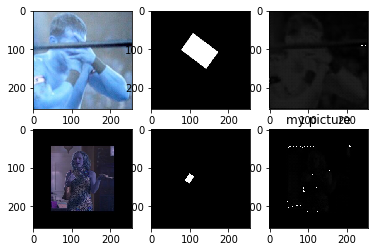

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4111
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4112
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4113
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4114
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
4115
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4116
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4117
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4118
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4119
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
4120
(2, 256, 256, 1)


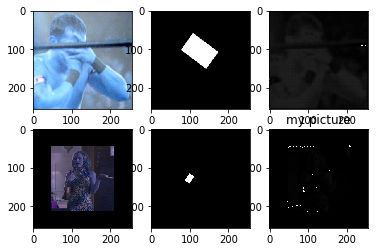

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4121
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4122
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4123
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4124
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
4125
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4126
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4127
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4128
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4129
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4130
(2, 256, 256, 1)


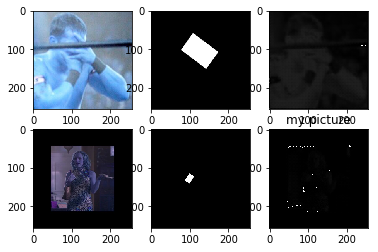

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4131
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4132
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4133
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4134
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
4135
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4136
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4137
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4138
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4139
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4140
(2, 256, 256, 1)


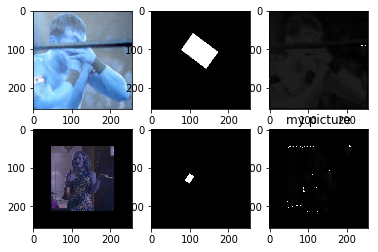

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4141
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4142
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4143
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4144
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
4145
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4146
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4147
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4148
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4149
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4150
(2, 256, 256, 1)


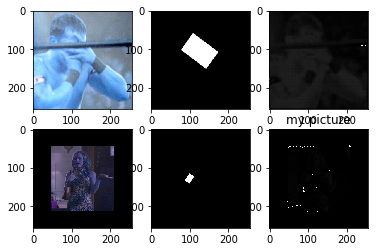

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4151
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4152
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4153
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4154
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4155
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4156
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4157
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4158
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4159
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4160
(2, 256, 256, 1)


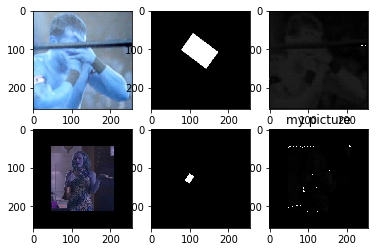

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4161
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4162
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4163
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4164
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
4165
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4166
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4167
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4168
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4169
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4170
(2, 256, 256, 1)


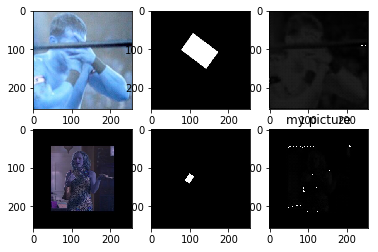

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4171
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4172
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4173
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4174
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
4175
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4176
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4177
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4178
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4179
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4180
(2, 256, 256, 1)


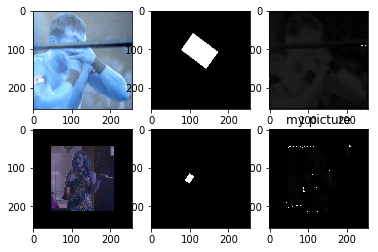

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4181
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4182
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4183
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4184
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
4185
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4186
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4187
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4188
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4189
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4190
(2, 256, 256, 1)


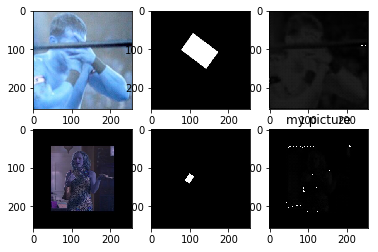

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4191
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4192
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4193
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4194
10/10 [==============================] - 0s 22ms/sample - loss: 0.0106
4195
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4196
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4197
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4198
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4199
10/10 [==============================] - 0s 20ms/sample - loss: 0.0106
4200
(2, 256, 256, 1)


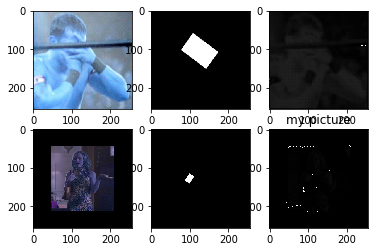

10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4201
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4202
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4203
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4204
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
4205
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4206
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4207
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4208
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4209
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4210
(2, 256, 256, 1)


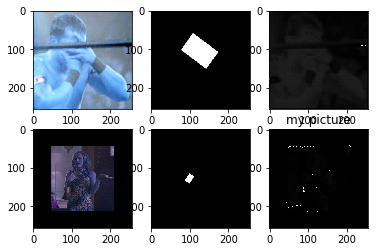

10/10 [==============================] - 0s 17ms/sample - loss: 0.0106
4211
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4212
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4213
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4214
10/10 [==============================] - 0s 21ms/sample - loss: 0.0106
4215
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4216
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4217
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4218
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4219
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4220
(2, 256, 256, 1)


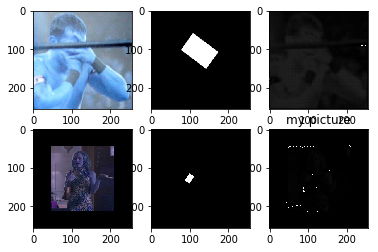

10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4221
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4222
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4223
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4224
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4225
10/10 [==============================] - 0s 19ms/sample - loss: 0.0106
4226
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4227
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4228
10/10 [==============================] - 0s 18ms/sample - loss: 0.0106
4229


KeyboardInterrupt: ignored

In [0]:
import tensorflow as tf
from tensorflow.keras import Model
import tensorflow.keras as keras
from tensorflow.keras.layers import Input, Conv2D, Concatenate, Conv2DTranspose, MaxPool2D, concatenate
from matplotlib import pyplot as plt
%matplotlib inline
i, a = getBatchForUNet(10)
ip = Input(shape=(256, 256, 3))
conv1 = Conv2D(64, (3, 3), (2, 2), 'valid', activation='relu')(ip)
conv2 = Conv2D(64, (3, 3), (2, 2), 'valid', activation='relu')(conv1)
conv3 = Conv2D(128, (3, 3), (1, 1), 'valid', activation='relu')(conv2)
conv4 = Conv2D(256, (3, 3), (1, 1), 'valid', activation='relu')(conv3)
conv5 = Conv2D(512, (3, 3), (1, 1), 'valid', activation='relu')(conv4)
deconv1 = Conv2DTranspose(256, (3, 3), (1, 1), activation = 'relu')(conv5)
deconv1 = concatenate([deconv1, conv4])
deconv2 = Conv2DTranspose(128, (3, 3), (1, 1), activation = 'relu')(deconv1)
deconv2 = concatenate([deconv2, conv3])
deconv3 = Conv2DTranspose(64, (3, 3), (1, 1), activation = 'relu')(deconv2)
deconv3 = concatenate([deconv3, conv2])
deconv4 = Conv2DTranspose(64, (3, 3), (2, 2), activation = 'relu')(deconv3)
deconv4 = concatenate([deconv4, conv1])
deconv5 = Conv2DTranspose(64, (4, 4), (2, 2), activation = 'relu')(deconv4)
deconv5 = concatenate([deconv5, ip])
final = Conv2D(1, (1, 1), (1, 1))(deconv5)
model = Model(inputs=ip, outputs=final)
#model.summary()
optim = keras.optimizers.SGD(lr=0.1, momentum=0.0, decay=0.0, nesterov=False)
model.compile(optimizer=optim, loss='mse')
exit(0)
for p in range(10000):
    model.fit(i, a)
    print(p)
    if(p%10 == 0):
        _, axs = plt.subplots(2, 3)
        pred = model.predict(i[0:2].reshape(2, 256, 256, 3))
        print(pred.shape)
        axs[0, 0].imshow((i[0].reshape((256, 256, 3))*255).astype(np.uint8))
        axs[0, 1].imshow((a[0].reshape((256, 256))*255).astype(np.uint8), cmap='gray')
        axs[0, 2].imshow((pred[0].reshape((256, 256))*255).astype(np.uint8), cmap='gray')
        axs[1, 0].imshow((i[1].reshape((256, 256, 3))*255).astype(np.uint8))
        axs[1, 1].imshow((a[1].reshape((256, 256))*255).astype(np.uint8), cmap='gray')
        axs[1, 2].imshow((pred[1].reshape((256, 256))*255).astype(np.uint8), cmap='gray')
        plt.title('my picture')
        plt.show()



In [0]:
import scipy.io as sio
import os
import cv2
import numpy as np
train_root = "/content/hand_dataset/training_dataset/training_data/"
train_dest = "/content/train_final/"
images_dir = "images/"
annot_dir = "annotations/"
fnames = os.listdir(train_dest+images_dir)
def getBatchForRPN(numEx):
    imgs = []
    anss = []
    done = 0
    while done<numEx:
        ist = np.random.randint(len(fnames), size=1)
        i = ist[0]
        fname = fnames[i]
        ans = cv2.imread(train_dest+annot_dir+fname)
        ans = cv2.cvtColor(ans, cv2.COLOR_BGR2GRAY)
        if(np.sum(ans)>2550000):
            img = cv2.imread(train_dest+images_dir+fname)
            img = cv2.resize(img, (256, 256))
            imgs.append(img[:, :, ::-1])
            ans = cv2.resize(ans, (8, 8))
            ans = np.reshape(ans, (8, 8, 1))
            anss.append(ans)
            done+=1
    return (np.asarray(imgs).astype(np.float32)), (np.asarray(anss).astype(np.float32))/255

In [0]:
from matplotlib import pyplot as plt
%matplotlib inline
i, a = getBatchForRPN(10)
for p in range(len(i)):
    _, axs = plt.subplots(1, 2)
    axs[0].imshow((i[p].reshape((256, 256, 3))*255).astype(np.uint8))
    anst = cv2.resize((a[p]*255).astype(np.uint8), (256, 256))
    axs[1].imshow(anst, cmap='gray')
    plt.show()



In [0]:
import tensorflow as tf
from tensorflow.keras import Model
import tensorflow.keras as keras
from tensorflow.keras.layers import Input, Conv2D, Concatenate, Conv2DTranspose, MaxPool2D, concatenate
from matplotlib import pyplot as plt
from IPython.display import clear_output
%matplotlib inline
i, a = getBatchForRPN(100)
ip = Input(shape=(256, 256, 3))
conv1 = Conv2D(64, (3, 3), (1, 1), 'valid', activation='relu')(ip)
conv2 = Conv2D(128, (3, 3), (1, 1), 'valid', activation='relu')(conv1)
mxp1 = MaxPool2D((2, 2), (2, 2))(conv2)
conv3 = Conv2D(128, (3, 3), (1, 1), 'valid', activation='relu')(mxp1)
conv4 = Conv2D(256, (3, 3), (1, 1), 'valid', activation='relu')(conv3)
mxp2 = MaxPool2D((2, 2), (2, 2))(conv4)
conv5 = Conv2D(256, (3, 3), (1, 1), 'valid', activation='relu')(mxp2)
conv6 = Conv2D(512, (3, 3), (1, 1), 'valid', activation='relu')(conv5)
mxp3 = MaxPool2D((2, 2), (2, 2))(conv6)
conv7 = Conv2D(512, (3, 3), (1, 1), 'valid', activation='relu')(mxp3)
conv8 = Conv2D(256, (3, 3), (1, 1), 'valid', activation='relu')(conv7)
mxp4 = MaxPool2D((2, 2), (2, 2))(conv8)
conv9 = Conv2D(64, (3, 3), (1, 1), 'valid', activation='relu')(mxp4)
conv10 = Conv2D(1, (3, 3), (1, 1), 'valid', activation='sigmoid')(conv9)
model = Model(inputs=ip, outputs=conv10)
#model.summary()
optim = keras.optimizers.SGD(lr=0.05, momentum=0.0, decay=0.0, nesterov=False)
model.compile(optimizer=optim, loss='mse')
exit(0)
for p in range(1000000):
    model.fit(i, a)
    print(p)
    if(p%10 == 0):
        clear_output()
        _, axs = plt.subplots(2, 3)
        pred = model.predict(i[0:2].reshape(2, 256, 256, 3))
        print(pred.shape)
        axs[0, 0].imshow((i[0].reshape((256, 256, 3))*255).astype(np.uint8))
        anst = cv2.resize((a[0]*255).astype(np.uint8), (256, 256))
        axs[0, 1].imshow(anst, cmap='gray')
        predt = cv2.resize((pred[0]*255).astype(np.uint8), (256, 256))
        axs[0, 2].imshow(predt, cmap='gray')
        axs[1, 0].imshow((i[1].reshape((256, 256, 3))*255).astype(np.uint8))
        anst = cv2.resize((a[1]*255).astype(np.uint8), (256, 256))
        axs[1, 1].imshow(anst, cmap='gray')
        predt = cv2.resize((pred[1]*255).astype(np.uint8), (256, 256))
        axs[1, 2].imshow(predt, cmap='gray')
        plt.title('my picture')
        plt.show()



In [0]:
import tensorflow as tf
from tensorflow.keras import Model
import tensorflow.keras as keras
from tensorflow.keras.layers import Input, Conv2D, Concatenate, Conv2DTranspose, MaxPool2D, concatenate
from matplotlib import pyplot as plt
from IPython.display import clear_output
ip = Input(shape=(256, 256, 3))
mdl = keras.applications.inception_v3.InceptionV3(include_top=False, weights='imagenet', input_tensor=ip, input_shape=(256, 256, 3), pooling=None, classes=1000)
#print(mdl.get_layer("activation_74").output)
i, a = getBatchForRPN(3000)
#keras.applications.inception_v3.preprocess_input(i)
#mdl.summary()
for q in range(len(mdl.layers)):
    mdl.layers[q].trainable=False
#     print(i)
#     print(mdl.layers[i].output_shape)
#     print(mdl.layers[i].name)
i = keras.applications.inception_v3.preprocess_input(i)
print(i)
inception_features = mdl.layers[240].output
conv1 = Conv2D(64, (3, 3), (1, 1))(inception_features)
conv2 = Conv2D(4, (3, 3), (1, 1))(conv1)
conv3 = Conv2D(1, (3, 3), (1, 1), activation='sigmoid')(conv2)

model = Model(inputs=ip, outputs=conv3)
optim = keras.optimizers.SGD(lr=0.05, momentum=0.0, decay=0.0, nesterov=False)
model.compile(optimizer=optim, loss='mse')
for p in range(1000000):
    model.fit(i, a)
    print(p)
    if(p%10 == 0):
        clear_output()
        _, axs = plt.subplots(2, 3)
        pred = model.predict(i[0:2].reshape(2, 256, 256, 3))
        print(pred.shape)
        axs[0, 0].imshow((i[0].reshape((256, 256, 3))*255).astype(np.uint8))
        anst = cv2.resize((a[0]*255).astype(np.uint8), (256, 256))
        axs[0, 1].imshow(anst, cmap='gray')
        predt = cv2.resize((pred[0]*255).astype(np.uint8), (256, 256))
        axs[0, 2].imshow(predt, cmap='gray')
        axs[1, 0].imshow((i[1].reshape((256, 256, 3))*255).astype(np.uint8))
        anst = cv2.resize((a[1]*255).astype(np.uint8), (256, 256))
        axs[1, 1].imshow(anst, cmap='gray')
        predt = cv2.resize((pred[1]*255).astype(np.uint8), (256, 256))
        axs[1, 2].imshow(predt, cmap='gray')
        plt.title('my picture')
        plt.show()


W0808 14:17:57.303095 139817002485632 deprecation.py:506] From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/init_ops.py:1251: calling VarianceScaling.__init__ (from tensorflow.python.ops.init_ops) with dtype is deprecated and will be removed in a future version.
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor


87916544/87910968 [==============================] - 1s 0us/step


NameError: ignored

In [0]:
!git init
